In [1]:
import pandas as pd
import numpy as np

from scipy import stats

import matplotlib.pyplot as plt
import seaborn as sns

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import grangercausalitytests
from statsmodels.tsa.vector_ar.var_model import VAR
from statsmodels.stats.stattools import durbin_watson

import keras
from keras.models import Sequential, load_model
from keras.layers import Dense, LSTM, Dropout, BatchNormalization, Bidirectional, TimeDistributed, Conv1D, MaxPooling1D, Flatten, ConvLSTM2D
from keras.utils import np_utils
from keras.utils import plot_model

import xgboost as xgb

import shap
import lime

import tensorflow as tf

from PIL import Image

from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.metrics import mean_absolute_error, mean_squared_error

pd.set_option("display.max_columns", 500)

/home/sunny/anaconda3/lib/python3.7/site-packages/statsmodels/compat/pandas.py:23: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  data_klasses = (pandas.Series, pandas.DataFrame, pandas.Panel)
Using TensorFlow backend.


## Grangers Causality Matrix Creation Method

In [2]:
maxlag=12

test = 'ssr-chi2test'

def grangers_causality_matrix(data, variables_y = None, variables_x = None, test = 'ssr_chi2test', verbose=False):
        
    if (variables_y != None) & (variables_x == None):
        variables_x = data.columns
        
    elif (variables_y == None) & (variables_x != None):
        variables_y = data.columns
        
    else:
        variables_y = data.columns
        variables_x = data.columns       
        
    dataset = pd.DataFrame(np.zeros((len(variables_y), len(variables_x))), columns=variables_x, index=variables_y)
        
    length = len(variables_x)   
    count = 0    
    for c in variables_x:
        for r in variables_y:
            test_result = grangercausalitytests(data[[r,c]], maxlag=maxlag, verbose=False)
            p_values = [round(test_result[i+1][0][test][1],4) for i in range(maxlag)]
            if verbose: print(f'Y = {r}, X = {c}, P Values = {p_values}')

            min_p_value = np.min(p_values)
            dataset.loc[r,c] = min_p_value
            
        # Update user on progress
        count = count + 1
        print(f'Completed: {c}; {round(count / length * 100, 2)}% complete.')

    dataset.columns = [var + '_x' for var in variables_x]

    dataset.index = [var + '_y' for var in variables_y]

    return dataset

#grangers_causality_matrix(dataset, variables = dataset.columns) 

## Loading Stock & CSI Data

In [3]:
# Import data files
df_data = pd.read_csv('stock_data.csv')
csi_data = pd.read_csv('csi_data.csv')

print("Stock Dataset Size : ",df_data.shape)
print("CSI Dataset Size : ",csi_data.shape)
# Convert date column to datetime format
df_data['date'] = df_data.apply(lambda x: pd.to_datetime(x['date']), axis = 1)
csi_data['date'] = csi_data.apply(lambda x: pd.to_datetime(x['date']), axis = 1)

# Set date column as index
df_data.set_index('date', inplace = True)
csi_data.set_index('date', inplace = True)

# Create list of all S&P500 tickers to help reduce total data size

df_data.head()

Stock Dataset Size :  (3523, 1975)
CSI Dataset Size :  (3523, 4)


,A,AA,AAL,AAN,AAOI,AAP,AAPL,AAWW,AAXJ,AAXN,ABB,ABBV,ABC,ABG,ABMD,ABT,ACAD,ACB,ACH,ACIA,ACN,ACWI,ACWV,ADBE,ADI,ADM,ADNT,ADP,ADS,ADSK,ADTN,ADUS,ADVM,AEE,AEM,AEO,AEP,AER,AES,AFG,AFL,AFTY,AG,AGCO,AGG,AGM,AGN,AGNC,AGO,AGQ,AIG,AIMC,AINV,AIZ,AJG,AKAM,AKRX,AKS,ALB,ALFA,ALG,ALGN,ALGT,ALK,ALKS,ALL,ALLE,ALLK,ALLY,ALNY,ALV,ALXN,AMAG,AMAT,AMBA,AMC,AMD,AME,AMED,AMG,AMGN,AMJ,AMKR,AMLP,AMN,AMP,AMRN,AMSC,AMT,AMTD,AMWD,AMX,AMZN,AN,ANAB,ANAT,ANET,ANF,ANIK,ANIP,ANSS,ANTM,AOBC,AON,APA,APD,APH,APHA,APO,APPF,APRN,APTV,AR,ARCC,ARCH,ARE,ARGX,ARKW,ARLP,ARMK,ARNA,ARQL,ARW,ARWR,ASH,ASHR,ASHS,ASML,ASNA,ASND,ATGE,ATHM,ATO,ATR,ATUS,ATVI,AU,AUPH,AUY,AVAV,AVB,AVGO,AVLR,AVP,AVT,AVTR,AVY,AVYA,AWI,AWK,AWR,AXE,AXGT,AXL,AXP,AXS,AXSM,AXTA,AYI,AYX,AZN,AZO,AZPN,BA,BABA,BAC,BAH,BANC,BAND,BAP,BAX,BB,BBBY,BBD,BBH,BBY,BC,BCC,BCO,BCPC,BCS,BDX,BE,BERY,BFAM,BG,BGNE,BGS,BHC,BHF,BHP,BHVN,BIB,BIDU,BIG,BIIB,BIL,BILI,BIO,BIS,BITA,BJK,BJRI,BK,BKD,BKF,BKH,BKLN,BKNG,BKR,BKX,BLCN,BLD,BLDR,BLK,BLKB,BLL,BLOK,BLUE,BLV,BMA,BMO,BMRN,BMY,BND,BNO,BOIL,BOKF,BOLD,BOOM,BOTZ,BOX,BP,BPMC,BPOP,BPY,BR,BRF,BRKS,BRZU,BSV,BSX,BTU,BUD,BURL,BVN,BWA,BWX,BX,BXP,...,TWTR,TX,TXG,TXN,TXT,TYD,TYL,TZA,UA,UAA,UAL,UBER,UBIO,UBT,UCO,UCOM,UDN,UDOW,UGA,UGL,UHS,UHT,UI,UIS,UL,ULE,ULTA,UMBF,UMDD,UN,UNG,UNH,UNIT,UNP,UPLD,UPRO,UPS,URA,URBN,URE,URI,URTH,URTY,USB,USCR,USD,USL,USMV,USNA,USO,USPH,UTHR,UTX,UTY,UUP,UVXY,UWM,UYG,UYM,V,VAC,VAL,VALE,VAR,VAW,VB,VBK,VBR,VC,VCR,VDC,VDE,VEA,VECO,VEEV,VER,VFC,VFH,VG,VGK,VHC,VHT,VIAC,VIAV,VIG,VIIX,VIPS,VIS,VIX,VIXM,VIXY,VKTX,VLO,VLY,VMC,VMI,VMW,VNDA,VNET,VNOM,VNQ,VO,VOD,VOE,VONV,VOT,VOX,VOYA,VPL,VPU,VRAY,VRNS,VRSK,VRSN,VRTX,VSAT,VSLR,VST,VT,VTR,VTV,VUG,VV,VWO,VXF,VXUS,VXX,VXZ,VYM,VZ,W,WAB,WAT,WB,WBA,WBC,WCN,WDAY,WDC,WDFC,WEC,WELL,WEN,WES,WETF,WEX,WFC,WGO,WH,WHR,WIFI,WING,WIRE,WIX,WLK,WLL,WLTW,WM,WMB,WMGI,WMT,WORK,WPC,WPM,WPP,WPX,WRB,WRK,WSM,WSO,WST,WU,WUBA,WVE,WW,WWD,WWE,WY,WYND,WYNN,X,XAU,XBI,XDC,XEC,XEL,XEO,XES,XHB,XHE,XLB,XLC,XLE,XLF,XLI,XLK,XLNX,XLP,XLRE,XLU,XLV,XLY,XME,XOM,XOP,XPER,XPO,XPP,XRAY,XRT,XRX,XSD,XSP,XYL,Y,YANG,YCS,YELP,YETI,YEXT,YINN,YNDX,YOLO,YPF,YRCW,YUM,YUMC,YY,Z,ZAGG,ZAYO,ZBH,ZBIO,ZBRA,ZEN,ZG,ZGNX,ZION,ZIOP,ZM,ZNGA,ZROZ,ZS,ZSL,ZTO,ZTS,ZUO,ZYME,csi1,csi_difference
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2006-01-03,0.189130,0.567085,0.295580,0.103657,NaN,0.343489,0.084282,0.351223,NaN,0.055722,0.080426,NaN,0.166772,0.128887,0.073796,0.149772,0.078848,NaN,0.156669,NaN,0.231255,NaN,NaN,0.304025,0.289661,0.192423,NaN,0.289997,0.291713,0.337411,0.230229,NaN,NaN,0.409313,0.173954,0.122652,0.294870,NaN,0.127861,0.201368,0.183781,NaN,NaN,0.131965,0.794317,0.239148,0.259984,NaN,0.199684,NaN,10.989740,NaN,0.429282,0.347830,0.247356,0.164167,0.034491,0.064009,0.161681,NaN,0.164483,0.049566,NaN,0.069554,0.161957,0.431965,NaN,NaN,NaN,0.102289,0.270272,0.040036,0.088635,0.144672,NaN,NaN,0.255722,0.099436,0.247376,0.650592,0.634254,NaN,0.043883,NaN,0.155012,0.332281,0.106551,0.666141,0.215470,0.193765,0.194949,0.122928,0.375533,0.173639,NaN,0.908445,NaN,0.518706,0.091081,0.997317,0.156235,0.626362,0.031650,0.294002,0.559590,0.435228,0.087747,NaN,NaN,NaN,NaN,NaN,NaN,0.128256,NaN,0.650039,NaN,NaN,0.149526,NaN,1.219416,0.049329,0.257143,0.318863,0.231374,NaN,NaN,0.181581,1.582873,NaN,0.153512,NaN,0.211050,0.207182,NaN,0.055012,0.413181,NaN,0.056433,NaN,0.721705,NaN,NaN,0.223283,0.189345,NaN,0.444594,NaN,NaN,NaN,0.125493,0.318548,NaN,0.146882,0.414996,0.248382,NaN,NaN,0.251697,NaN,0.198500,0.732123,0.063931,0.555959,NaN,0.371586,NaN,0.217443,NaN,0.184213,0.164455,0.175243,0.287293,0.050602,0.537990,0.353039,0.322178,NaN,0.381

In [4]:
csi_data.tail()

,csi1,csi2,difference
date,,,
2019-12-24,1.437937,1.220292,0.217645
2019-12-26,1.614389,1.373594,0.240795
2019-12-27,1.725802,1.477884,0.247918
2019-12-30,1.794191,1.562093,0.232099
2019-12-31,1.858108,1.646110,0.211998


### Plotting CSI1 and CSI2 Time-Series

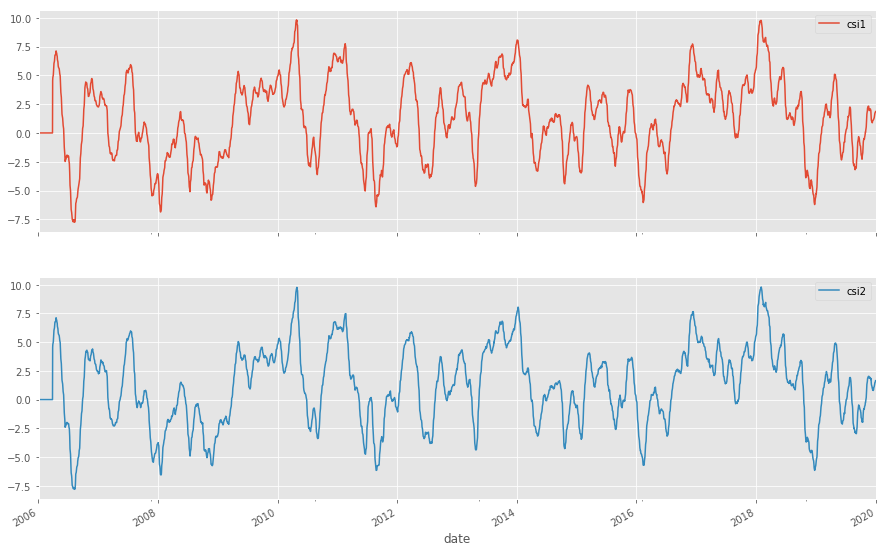

In [5]:
with plt.style.context(("ggplot")):
    csi_data.plot(y=["csi1", "csi2"], figsize=(15,10), subplots=True)

In [6]:
# # Pick 15 random tickers to complete a small test

# import random

# df_new = pd.DataFrame(index = df_subset.index)
# pool = df_subset.columns 

# for i in range(0, 15, 1):    
#     choice = random.choice(pool)    
#     df_new[choice] = df_subset[choice]
    
# df_new['csi1'] = df_subset['csi1']
# df_new['csi_difference'] = df_subset['csi_difference']

## Decomposing Time-Series 

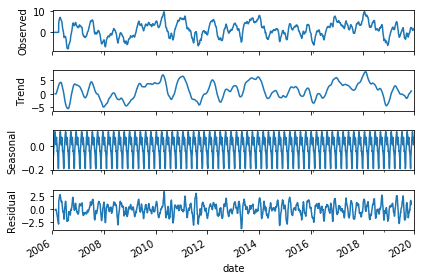

In [7]:
decompose_result = seasonal_decompose(csi_data.csi1, model="additive", freq=52)

trend = decompose_result.trend
seasonal = decompose_result.seasonal
residual = decompose_result.resid

decompose_result.plot();

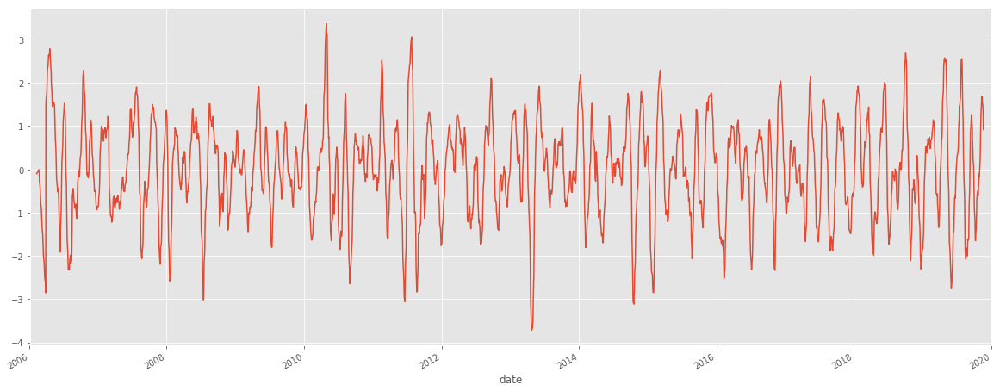

In [8]:
with plt.style.context(("ggplot")):
    residual.plot(figsize=(20,8));

## Statistical Tests to Check Distribution 

In [9]:
stat,p = stats.normaltest(csi_data.csi1)
print("Statistics = %.3f, p=%.3f" % (stat,p))
alpha = 0.05
if p> alpha:
    print('CSI1 : Data looks Gaussian (fail to reject null hypothesis)')
else:
    print('CSI1 : Data looks non-Gaussian (reject null hypothesis)')

Statistics = 63.913, p=0.000
CSI1 : Data looks non-Gaussian (reject null hypothesis)


In [10]:
stat,p = stats.normaltest(csi_data.csi2)
print("Statistics = %.3f, p=%.3f" % (stat,p))
if p> alpha:
    print('CSI2 : Data looks Gaussian (fail to reject null hypothesis)')
else:
    print('CSI2 : Data looks non-Gaussian (reject null hypothesis)')

Statistics = 64.194, p=0.000
CSI2 : Data looks non-Gaussian (reject null hypothesis)


In [11]:
print("Kurtosis of normal distribution (CSI1) : ", stats.kurtosis(csi_data.csi1))
print("Kurtosis of normal distribution (CSI2) : ", stats.kurtosis(csi_data.csi2))

Kurtosis of normal distribution (CSI1) :  -0.473222631779874
Kurtosis of normal distribution (CSI2) :  -0.47594590627204125


Kurtosis test results values near to 0 indicates normal distribution.

In [12]:
print("Skewness of normal distribution (CSI1) : ", stats.kurtosis(csi_data.csi1))
print("Skewness of normal distribution (CSI2) : ", stats.skew(csi_data.csi2))

Skewness of normal distribution (CSI1) :  -0.473222631779874
Skewness of normal distribution (CSI2) :  -0.10136310685550566


#### CSI1

count    3523.000000
mean        1.229909
std         3.357615
min        -7.756103
25%        -1.129128
50%         1.317779
75%         3.666903
max         9.809280
Name: csi1, dtype: float64

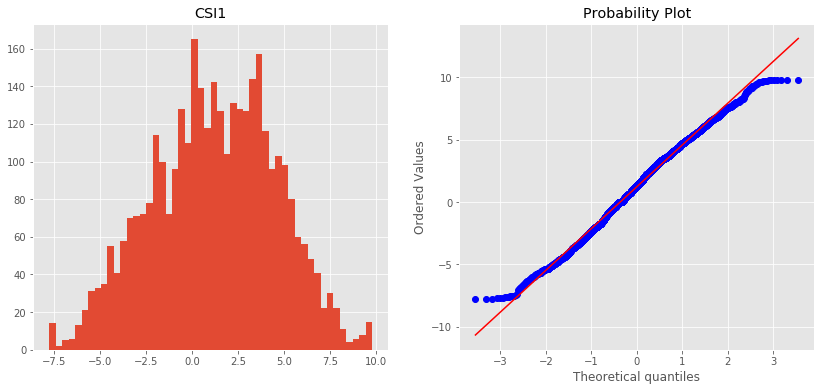

In [13]:
with plt.style.context(("ggplot")):
    plt.figure(figsize=(14,6))
    plt.subplot(1,2,1)
    csi_data['csi1'].hist(bins=50)
    plt.title('CSI1')
    plt.subplot(1,2,2)
    stats.probplot(csi_data['csi1'], plot=plt);

csi_data.csi1.describe().T

#### CSI2

count    3523.000000
mean        1.201384
std         3.341931
min        -7.814654
25%        -1.164718
50%         1.285738
75%         3.624636
max         9.799463
Name: csi2, dtype: float64

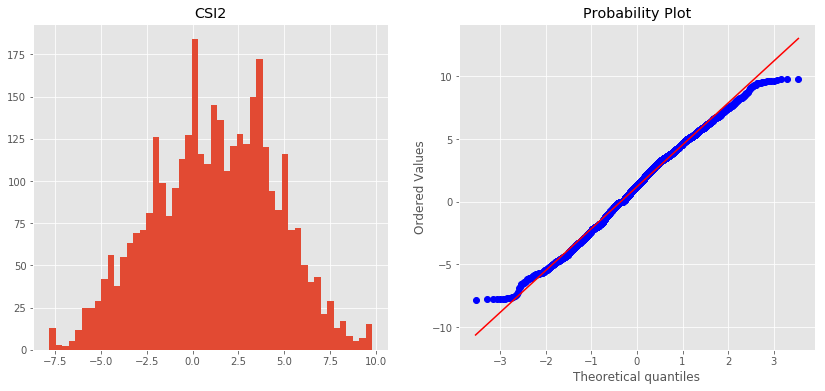

In [14]:
with plt.style.context(("ggplot")):
    plt.figure(figsize=(14,6))
    plt.subplot(1,2,1)
    csi_data['csi2'].hist(bins=50)
    plt.title('CSI2')
    plt.subplot(1,2,2)
    stats.probplot(csi_data['csi2'], plot=plt);

csi_data.csi2.describe().T

## ACF & PACF

### CSI1

#### ACF

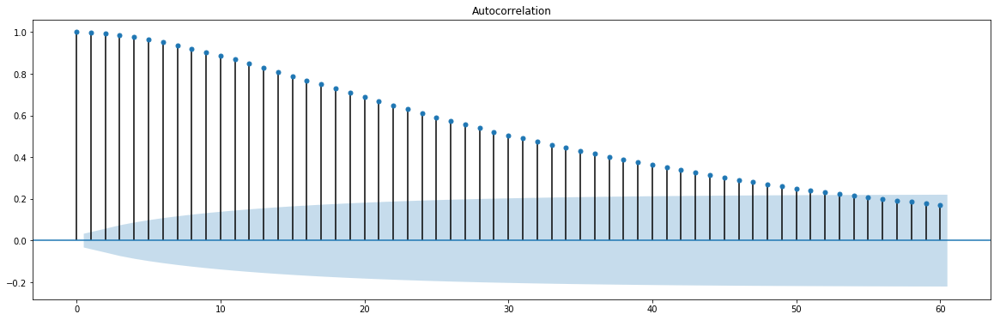

In [15]:
fig = plt.figure(figsize=(20,6))
ax = fig.add_subplot(111)
plot_acf(csi_data.csi1, lags=60, ax=ax);

#### PACF

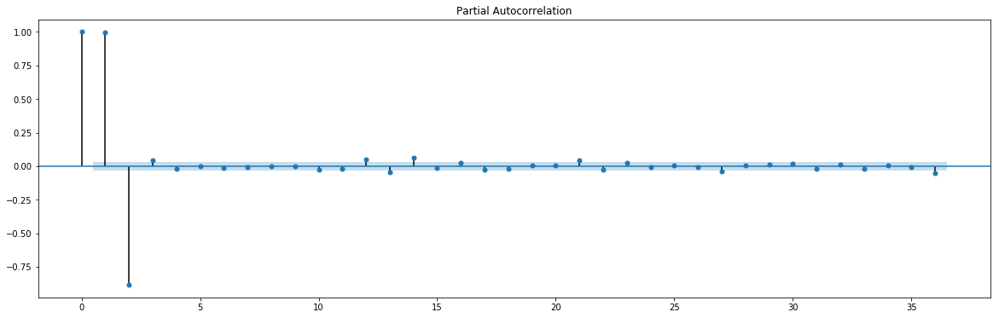

In [16]:
fig = plt.figure(figsize=(20,6))
ax = fig.add_subplot(111)
plot_pacf(csi_data.csi1, ax=ax);

### CSI1

#### ACF

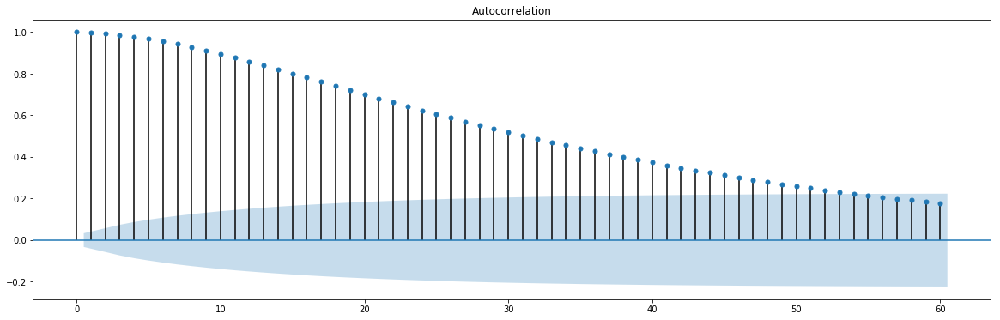

In [17]:
fig = plt.figure(figsize=(20,6))
ax = fig.add_subplot(111)
plot_acf(csi_data.csi2, lags=60, ax=ax);

#### PACF

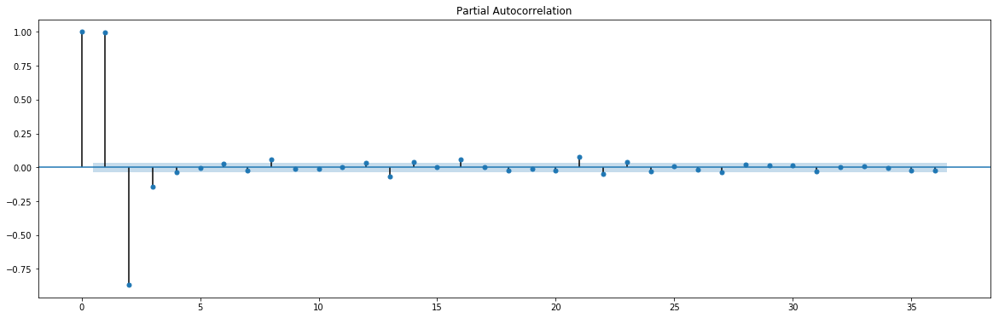

In [18]:
fig = plt.figure(figsize=(20,6))
ax = fig.add_subplot(111)
plot_pacf(csi_data.csi2, ax=ax);

## Dataset Creation For Machine Learning

In [61]:
## Create subset and drop columns with any zeros

# Import dataframe of all tickers and convert to a list
tickers = pd.read_csv('SP500_tickers.csv')
tickers = [x for x in tickers['ticker']]

# Reduce size of total data
df_subset = df_data.iloc[-1000:]

print("Dataset Size : ", df_subset.shape)
# Eliminate any tickers that have NaNs as some or all values
for col in df_subset.columns:    
    # count NaN occurences     
    count_null = df_data[col].isnull().sum()
    if count_null == 0:
        continue
    else:
        df_subset.drop(columns = col, inplace = True)
        #print('Dropped: ', col)
        
# Isolate only SP500 names
for col in df_subset.columns:
    # Check if the column's ticker is in the S&P500 ticker list
    if col in tickers:
        continue
        
    else:
        df_subset.drop(columns = col, inplace = True)
        

# Add CSI data into the master dataframe        
df_subset['csi1'] = csi_data['csi1'].iloc[-1000:]
#df_subset['csi_difference'] = csi_data['difference'].iloc[-1000:]
df_subset['csi2'] = csi_data['csi2'].iloc[-1000:]

cols = ["csi1", "csi2"] + df_subset.columns.tolist()[:-2]

df_subset = df_subset[cols]

print("Dataset Size : ", df_subset.shape)

df_subset.head()

Dataset Size :  (2500, 1974)



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Dataset Size :  (2500, 403)



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


,csi1,csi2,A,AAL,AAP,AAPL,ABC,ABMD,ABT,ACN,ADBE,ADI,ADM,ADP,ADSK,AEE,AEP,AES,AFL,AIG,AIZ,AJG,AKAM,ALB,ALGN,ALK,ALL,ALXN,AMAT,AMD,AME,AMGN,AMP,AMT,AMZN,ANSS,ANTM,AON,APA,APD,APH,ARE,ATO,ATVI,AVB,AVY,AXP,AZO,BA,BAC,BAX,BBY,BDX,BIIB,BIO,BK,BKNG,BKR,BLK,BLL,BMY,BSX,BWA,BXP,C,CAG,CAH,CAT,CB,CCI,CCL,CDNS,CE,CERN,CF,CHD,CHRW,CI,CINF,CL,CLX,CMA,CMCSA,CME,CMI,CNC,CNP,COF,COG,COO,COP,COST,CPB,CPRT,CRM,CSCO,CSX,CTAS,CTL,CTSH,CTXS,CVS,CVX,D,DD,DE,DGX,DHI,DHR,DIS,DISCA,DISH,DLR,DLTR,DOV,DPZ,DRI,DTE,DUK,DVA,DVN,DXC,DXCM,EA,EBAY,ECL,ED,EFX,EIX,EL,EMN,EMR,EOG,EQIX,EQR,ES,ESS,ETFC,ETN,ETR,EW,EXC,EXPD,EXPE,EXR,F,FAST,FCX,FDX,FE,FFIV,FIS,FISV,FITB,FLIR,FMC,FRT,FTI,GD,GE,GILD,GIS,GL,GLW,GOOG,GOOGL,GPC,GPN,GPS,GRMN,GS,GWW,HAL,HAS,HBAN,HD,HES,HFC,HIG,HOLX,HON,HPQ,HRB,HRL,HSIC,HST,HSY,HUM,IBM,ICE,IDXX,IEX,IFF,ILMN,INCY,INTC,INTU,IP,IPG,IRM,ISRG,IT,ITW,IVZ,J,JBHT,JCI,JKHY,JNJ,JNPR,JPM,K,KEY,KLAC,KMB,KMX,KO,KR,KSS,KSU,LB,LEG,LEN,LH,LHX,LIN,LKQ,LLY,LMT,LNC,LOW,LRCX,LUV,LVS,LYV,MAA,MAR,MAS,MCD,MCHP,MCK,MCO,MDLZ,MDT,MET,MGM,MHK,MKC,MKTX,MLM,MMC,MMM,MNST,MO,MOS,MRK,MRO,MS,MSFT,MSI,MTB,MTD,MU,MXIM,MYL,NBL,NDAQ,NEE,NEM,NFLX,NI,NKE,NOC,NOV,NRG,NSC,NTAP,NTRS,NUE,NVDA,NWL,O,ODFL,OKE,OMC,ORCL,ORLY,OXY,PAYX,PBCT,PCAR,PEP,PFE,PG,PGR,PH,PHM,PKG,PKI,PLD,PNC,PNW,PPG,PPL,PRGO,PRU,PSA,PVH,PWR,PXD,QCOM,RCL,RE,REGN,RF,RJF,RL,RMD,ROK,ROP,ROST,RSG,SBAC,SBUX,SCHW,SEE,SHW,SIVB,SJM,SLB,SLG,SNA,SNPS,SO,SPG,SPGI,SRE,STE,STT,STX,STZ,SWK,SWKS,SYK,SYY,T,TAP,TDY,TFC,TFX,TGT,TIF,TJX,TMO,TPR,TROW,TRV,TSCO,TSN,TTWO,TXN,TXT,TYL,UAA,UHS,UNH,UNP,UPS,URI,USB,VAR,VFC,VLO,VMC,VRSN,VRTX,VTR,VZ,WAB,WAT,WBA,WDC,WEC,WELL,WFC,WHR,WLTW,WM,WMB,WMT,WRB,WST,WY,WYNN,XEL,XLNX,XOM,XRAY,XRX,YUM,ZBH,ZBRA,ZION
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2010-01-27,3.674661,3.844850,0.189980,0.044250,0.369571,0.270392,0.248202,0.075298,0.235466,0.381772,0.301739,0.252208,0.270873,0.327907,0.222799,0.236638,0.323500,0.117272,0.226760,0.226805,0.289994,0.204680,0.235182,0.335610,0.151962,0.083083,0.275699,0.208231,0.118729,0.074570,0.146489,0.525722,0.372485,0.388418,1.117636,0.384139,0.588364,0.356733,0.923245,0.664217,0.185696,0.554220,0.255304,0.094328,0.704270,0.349995,0.352090,1.423837,0.563871,0.138305,0.291349,0.336156,0.691979,0.487845,0.864154,0.270964,1.889466,0.433397,2.064736,0.114837,0.221251,0.081307,0.160521,0.592461,0.291359,0.162614,0.285077,0.486570,0.445780,0.348265,0.308477,0.054539,0.285350,0.187767,0.175544,0.138714,0.523172,0.314941,0.240827,0.365975,0.539379,0.322225,0.072157,0.535974,0.422562,0.044819,0.128198,0.332787,0.090481,0.326231,0.345725,0.523810,0.300920,0.078895,0.148866,0.210780,0.138214,0.229628,0.314122,0.209824,0.304369,0.295639,0.671037,0.345989,0.365958,0.477010,0.515615,0.106255,0.256065,0.266958,0.140553,0.169899,0.442775,0.148442,0.261286,0.101703,0.298048,0.389238,0.457252,0.276200,0.631430,0.237166,0.086953,0.155968,0.091855,0.406537,0.401074,0.292725,0.310025,0.244196,0.264318,0.382955,0.420605,0.903669,0.295366,0.232723,0.746608,0.150232,0.288264,0.716744,0.069471,0.421378,0.316034,0.402804,0.103797,0.105163,0.096171,0.324365,0.732222,0.402622,0.470090,0.220523,0.104730,0.110899,0.278339,0.206777,0.592461,0.246790,0.612128,0.142703,0.218702,0.325594,0.185296,0.174269,2.458689,2.470375,0.346536,0.207184,0.174816,0.305563,1.379405,0.911591,0.276882,0.286716,0.044432,0.253483,0.536192,0.119913,0.227260,0.139761,0.349473,0.204469,0.200492,0.088591,0.192526,0.099882,0.339525,0.446326,1.150232,0.176746,0.258126,0.266594,0.366749,0.337248,0.091596,0.184285,0.273240,0.214425,0.058909,0.195311,1.029500,0.195393,0.400528,0.197487,0.358918,0.298917,0.172987,0.202677,0.577620,0.227807,0.358099,0.501229,0.065101,0.2

In [62]:
df_subset.describe()

,csi1,csi2,A,AAL,AAP,AAPL,ABC,ABMD,ABT,ACN,ADBE,ADI,ADM,ADP,ADSK,AEE,AEP,AES,AFL,AIG,AIZ,AJG,AKAM,ALB,ALGN,ALK,ALL,ALXN,AMAT,AMD,AME,AMGN,AMP,AMT,AMZN,ANSS,ANTM,AON,APA,APD,APH,ARE,ATO,ATVI,AVB,AVY,AXP,AZO,BA,BAC,BAX,BBY,BDX,BIIB,BIO,BK,BKNG,BKR,BLK,BLL,BMY,BSX,BWA,BXP,C,CAG,CAH,CAT,CB,CCI,CCL,CDNS,CE,CERN,CF,CHD,CHRW,CI,CINF,CL,CLX,CMA,CMCSA,CME,CMI,CNC,CNP,COF,COG,COO,COP,COST,CPB,CPRT,CRM,CSCO,CSX,CTAS,CTL,CTSH,CTXS,CVS,CVX,D,DD,DE,DGX,DHI,DHR,DIS,DISCA,DISH,DLR,DLTR,DOV,DPZ,DRI,DTE,DUK,DVA,DVN,DXC,DXCM,EA,EBAY,ECL,ED,EFX,EIX,EL,EMN,EMR,EOG,EQIX,EQR,ES,ESS,ETFC,ETN,ETR,EW,EXC,EXPD,EXPE,EXR,F,FAST,FCX,FDX,FE,FFIV,FIS,FISV,FITB,FLIR,FMC,FRT,FTI,GD,GE,GILD,GIS,GL,GLW,GOOG,GOOGL,GPC,GPN,GPS,GRMN,GS,GWW,HAL,HAS,HBAN,HD,HES,HFC,HIG,HOLX,HON,HPQ,HRB,HRL,HSIC,HST,HSY,HUM,IBM,ICE,IDXX,IEX,IFF,ILMN,INCY,INTC,INTU,IP,IPG,IRM,ISRG,IT,ITW,IVZ,J,JBHT,JCI,JKHY,JNJ,JNPR,JPM,K,KEY,KLAC,KMB,KMX,KO,KR,KSS,KSU,LB,LEG,LEN,LH,LHX,LIN,LKQ,LLY,LMT,LNC,LOW,LRCX,LUV,LVS,LYV,MAA,MAR,MAS,MCD,MCHP,MCK,MCO,MDLZ,MDT,MET,MGM,MHK,MKC,MKTX,MLM,MMC,MMM,MNST,MO,MOS,MRK,MRO,MS,MSFT,MSI,MTB,MTD,MU,MXIM,MYL,NBL,NDAQ,NEE,NEM,NFLX,NI,NKE,NOC,NOV,NRG,NSC,NTAP,NTRS,NUE,NVDA,NWL,O,ODFL,OKE,OMC,ORCL,ORLY,OXY,PAYX,PBCT,PCAR,PEP,PFE,PG,PGR,PH,PHM,PKG,PKI,PLD,PNC,PNW,PPG,PPL,PRGO,PRU,PSA,PVH,PWR,PXD,QCOM,RCL,RE,REGN,RF,RJF,RL,RMD,ROK,ROP,ROST,RSG,SBAC,SBUX,SCHW,SEE,SHW,SIVB,SJM,SLB,SLG,SNA,SNPS,SO,SPG,SPGI,SRE,STE,STT,STX,STZ,SWK,SWKS,SYK,SYY,T,TAP,TDY,TFC,TFX,TGT,TIF,TJX,TMO,TPR,TROW,TRV,TSCO,TSN,TTWO,TXN,TXT,TYL,UAA,UHS,UNH,UNP,UPS,URI,USB,VAR,VFC,VLO,VMC,VRSN,VRTX,VTR,VZ,WAB,WAT,WBA,WDC,WEC,WELL,WFC,WHR,WLTW,WM,WMB,WMT,WRB,WST,WY,WYNN,XEL,XLNX,XOM,XRAY,XRX,YUM,ZBH,ZBRA,ZION
count,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.000000,2500.

#### Visualizing Data

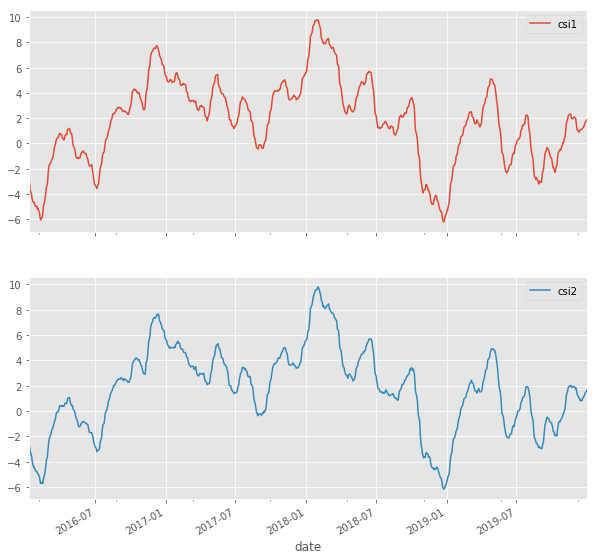

In [21]:
with plt.style.context(("ggplot")):
    df_subset.plot(y=["csi1", "csi2"], figsize=(10,10), subplots=True)

## Loading Grangers Causality Matrix Data

In [63]:
# Create grangers causality matrix for all tickers

# gc_test = grangers_causality_matrix(df_subset)

gc_test = pd.read_csv('CSI_SP500_granger_causality_FULL.csv', index_col = 0) # I ran the function previously (it took a long time)
print("Dataset Size : ", gc_test.shape)
gc_test.head()
#grangers_result = grangers_causality_matrix(df_subset)
#grangers_result.to_csv("grangers_result.csv")
#grangers_result.head()

Dataset Size :  (403, 403)


,A_x,AAL_x,AAP_x,AAPL_x,ABC_x,ABMD_x,ABT_x,ACN_x,ADBE_x,ADI_x,ADM_x,ADP_x,ADSK_x,AEE_x,AEP_x,AES_x,AFL_x,AIG_x,AIZ_x,AJG_x,AKAM_x,ALB_x,ALGN_x,ALK_x,ALL_x,ALXN_x,AMAT_x,AMD_x,AME_x,AMGN_x,AMP_x,AMT_x,AMZN_x,ANSS_x,ANTM_x,AON_x,APA_x,APD_x,APH_x,ARE_x,ATO_x,ATVI_x,AVB_x,AVY_x,AXP_x,AZO_x,BA_x,BAC_x,BAX_x,BBY_x,BDX_x,BIIB_x,BIO_x,BK_x,BKNG_x,BKR_x,BLK_x,BLL_x,BMY_x,BSX_x,BWA_x,BXP_x,C_x,CAG_x,CAH_x,CAT_x,CB_x,CCI_x,CCL_x,CDNS_x,CE_x,CERN_x,CF_x,CHD_x,CHRW_x,CI_x,CINF_x,CL_x,CLX_x,CMA_x,CMCSA_x,CME_x,CMI_x,CNC_x,CNP_x,COF_x,COG_x,COO_x,COP_x,COST_x,CPB_x,CPRT_x,CRM_x,CSCO_x,CSX_x,CTAS_x,CTL_x,CTSH_x,CTXS_x,CVS_x,CVX_x,D_x,DD_x,DE_x,DGX_x,DHI_x,DHR_x,DIS_x,DISCA_x,DISH_x,DLR_x,DLTR_x,DOV_x,DPZ_x,DRI_x,DTE_x,DUK_x,DVA_x,DVN_x,DXC_x,DXCM_x,EA_x,EBAY_x,ECL_x,ED_x,EFX_x,EIX_x,EL_x,EMN_x,EMR_x,EOG_x,EQIX_x,EQR_x,ES_x,ESS_x,ETFC_x,ETN_x,ETR_x,EW_x,EXC_x,EXPD_x,EXPE_x,EXR_x,F_x,FAST_x,FCX_x,FDX_x,FE_x,FFIV_x,FIS_x,FISV_x,FITB_x,FLIR_x,FMC_x,FRT_x,FTI_x,GD_x,GE_x,GILD_x,GIS_x,GL_x,GLW_x,GOOG_x,GOOGL_x,GPC_x,GPN_x,GPS_x,GRMN_x,GS_x,GWW_x,HAL_x,HAS_x,HBAN_x,HD_x,HES_x,HFC_x,HIG_x,HOLX_x,HON_x,HPQ_x,HRB_x,HRL_x,HSIC_x,HST_x,HSY_x,HUM_x,IBM_x,ICE_x,IDXX_x,IEX_x,IFF_x,ILMN_x,INCY_x,INTC_x,INTU_x,IP_x,IPG_x,IRM_x,ISRG_x,IT_x,ITW_x,IVZ_x,J_x,JBHT_x,JCI_x,JKHY_x,JNJ_x,JNPR_x,JPM_x,K_x,KEY_x,KLAC_x,KMB_x,KMX_x,KO_x,KR_x,KSS_x,KSU_x,LB_x,LEG_x,LEN_x,LH_x,LHX_x,LIN_x,LKQ_x,LLY_x,LMT_x,LNC_x,LOW_x,LRCX_x,LUV_x,LVS_x,LYV_x,MAA_x,MAR_x,MAS_x,MCD_x,MCHP_x,MCK_x,MCO_x,MDLZ_x,MDT_x,MET_x,MGM_x,MHK_x,MKC_x,MKTX_x,MLM_x,MMC_x,MMM_x,MNST_x,MO_x,MOS_x,MRK_x,MRO_x,MS_x,MSFT_x,MSI_x,MTB_x,MTD_x,MU_x,MXIM_x,MYL_x,NBL_x,NDAQ_x,NEE_x,NEM_x,NFLX_x,NI_x,NKE_x,NOC_x,NOV_x,NRG_x,NSC_x,NTAP_x,NTRS_x,NUE_x,NVDA_x,NWL_x,O_x,ODFL_x,OKE_x,OMC_x,ORCL_x,ORLY_x,OXY_x,PAYX_x,PBCT_x,PCAR_x,PEP_x,PFE_x,PG_x,PGR_x,PH_x,PHM_x,PKG_x,PKI_x,PLD_x,PNC_x,PNW_x,PPG_x,PPL_x,PRGO_x,PRU_x,PSA_x,PVH_x,PWR_x,PXD_x,QCOM_x,RCL_x,RE_x,REGN_x,RF_x,RJF_x,RL_x,RMD_x,ROK_x,ROP_x,ROST_x,RSG_x,SBAC_x,SBUX_x,SCHW_x,SEE_x,SHW_x,SIVB_x,SJM_x,SLB_x,SLG_x,SNA_x,SNPS_x,SO_x,SPG_x,SPGI_x,SRE_x,STE_x,STT_x,STX_x,STZ_x,SWK_x,SWKS_x,SYK_x,SYY_x,T_x,TAP_x,TDY_x,TFC_x,TFX_x,TGT_x,TIF_x,TJX_x,TMO_x,TPR_x,TROW_x,TRV_x,TSCO_x,TSN_x,TTWO_x,TXN_x,TXT_x,TYL_x,UAA_x,UHS_x,UNH_x,UNP_x,UPS_x,URI_x,USB_x,VAR_x,VFC_x,VLO_x,VMC_x,VRSN_x,VRTX_x,VTR_x,VZ_x,WAB_x,WAT_x,WBA_x,WDC_x,WEC_x,WELL_x,WFC_x,WHR_x,WLTW_x,WM_x,WMB_x,WMT_x,WRB_x,WST_x,WY_x,WYNN_x,XEL_x,XLNX_x,XOM_x,XRAY_x,XRX_x,YUM_x,ZBH_x,ZBRA_x,ZION_x,csi1_x,csi_difference_x
A_y,1.0000,0.5326,0.1110,0.0225,0.0051,0.0068,0.4126,0.9281,0.5480,0.1671,0.2060,0.2274,0.1408,0.0356,0.1362,0.0588,0.9212,0.0244,0.6572,0.6138,0.3622,0.2992,0.2046,0.6298,0.2904,0.3459,0.2258,0.0092,0.0051,0.0529,0.1519,0.0307,0.5942,0.1682,0.0732,0.1265,0.1785,0.1409,0.0809,0.1568,0.0336,0.0053,0.0337,0.1743,0.0904,0.3522,0.3893,0.3460,0.0381,0.1071,0.1866,0.6510,0.0098,0.3929,0.4455,0.7606,0.7437,0.1266,0.1341,0.2509,0.4633,0.4313,0.5651,0.4503,0.0000,0.4203,0.2308,0.1709,0.1302,0.0267,0.0312,0.2498,0.0001,0.5346,0.0569,0.0816,0.7412,0.3190,0.4589,0.2398,0.0139,0.1130,0.5869,0.0490,0.1941,0.1975,0.4687,0.3036,0.2635,0.7802,0.2267,0.0455,0.2848,0.8317,0.3029,0.1498,0.1251,0.0114,0.0842,0.1213,0.1778,0.1585,0.5041,0.3339,0.1180,0.2330,0.2787,0.0018,0.1345,0.0987,0.1610,0.3347,0.8684,0.3509,0.2550,0.0907,0.0707,0.0827,0.3298,0.2111,0.0138,0.1845,0.0408,0.1449,0.0871,0.3424,0.0257,0.4579,0.1879,0.5456,0.0447,0.0938,0.1103,0.1016,0.0378,0.5572,0.6301,0.0479,0.2855,0.2672,0.0055,0.6945,0.0654,0.2431,0.6531,0.5590,0.3427,0.2084,0.6928,0.0866,0.4217,0.8936,0.1528,0.0007,0.1959,0.6255,0.7766,0.6616,0.4464,0.4787,0.8642,0.0368,0.0048,0.0041,0.0371,0.4240,0.0439,0.1587,0.6598,0.3776,0.0928,0.0041,0.6668,0.1303,0.4556,0.0920,0.7028,0.6568,0.1564,0.0253,0.0845,0.5689,0.3971,0.0937,0.6109,0.0154,0.0458,0.6349,0.0979,0.0096,0.1861,0.0643,0.4447,0.2891,0.0115,0.0444,0.2171,0.5650,0.7845,0.3547,0.3572,0.5552,0.1756,0.7853,0.1936,0.2400,0.1354,0.9316,0.7633,0.7140,0.5691,0.0286,0.5375,0.0239,0.1741,0.4342,0.1680,

## Filtering Training Data Based on X & Y values of CSI1 from Grangers Causality Matrix

In [64]:
## Columns has been first filtered with values less than 0.05, then columns are sorted according to
## p-values in ascending order so that least p-values will be in begining and most at last.
csi1_x_columns = gc_test[gc_test["csi1_x"] < 0.05].sort_values(by="csi1_x").index.tolist()
csi1_x_columns = [val.split("_")[0] for val in csi1_x_columns]
print("Number of Columns : ", len(csi1_x_columns))
print("\nColumns : ",csi1_x_columns)

csi1_y_columns = gc_test.T[gc_test.T["csi1_y"] < 0.05].sort_values(by="csi1_y").index.tolist()
csi1_y_columns = [val.split("_")[0] for val in csi1_y_columns]
print("\nNumber of Columns : ", len(csi1_y_columns))
print("\nColumns : ", csi1_y_columns)

Number of Columns :  131

Columns :  ['csi', 'WELL', 'ARE', 'CLX', 'TTWO', 'CHD', 'LNC', 'RE', 'VRSN', 'O', 'EXR', 'K', 'FE', 'FLIR', 'PLD', 'FIS', 'AVB', 'ADSK', 'HAL', 'OXY', 'ATVI', 'TYL', 'ESS', 'HES', 'AAPL', 'CAH', 'PSA', 'WST', 'TDY', 'APA', 'MDT', 'RJF', 'USB', 'PEP', 'BXP', 'NBL', 'EQR', 'MAA', 'VLO', 'WY', 'PWR', 'PRU', 'ECL', 'SLB', 'HRB', 'ADBE', 'MSFT', 'AMP', 'EXC', 'WM', 'DVN', 'EOG', 'XLNX', 'HST', 'MOS', 'HD', 'AKAM', 'PXD', 'CTAS', 'GOOGL', 'COST', 'NKE', 'CTXS', 'MRO', 'ODFL', 'DLR', 'INTU', 'DVA', 'TSN', 'BAC', 'PFE', 'ALB', 'MS', 'WRB', 'LRCX', 'GPN', 'AMD', 'VTR', 'GOOG', 'NVDA', 'COO', 'SLG', 'AMZN', 'SPG', 'AAP', 'HUM', 'SPGI', 'NOV', 'EFX', 'PPL', 'RF', 'FRT', 'GL', 'STT', 'AEE', 'AZO', 'PHM', 'MRK', 'SCHW', 'IBM', 'CME', 'SIVB', 'RMD', 'HBAN', 'URI', 'CAT', 'CERN', 'DPZ', 'TFC', 'TXT', 'FMC', 'ZION', 'ATO', 'BLK', 'AIG', 'CPRT', 'IP', 'NFLX', 'ADP', 'PH', 'CMA', 'PGR', 'KEY', 'DE', 'HSY', 'EXPE', 'MCO', 'RCL', 'EA', 'CMCSA', 'BSX']

Number of Columns :  108

C

### Dataset Based on CSI1_X

In [65]:
cols_x = ["csi1", "csi2"] + [col for col in df_subset.columns if col in csi1_x_columns]
df_subset_csi_x = df_subset[cols_x]
print("Dataset Size : ", df_subset_csi_x.shape)
df_subset_csi_x.head()

Dataset Size :  (2500, 132)


,csi1,csi2,AAP,AAPL,ADBE,ADP,ADSK,AEE,AIG,AKAM,ALB,AMD,AMP,AMZN,APA,ARE,ATO,ATVI,AVB,AZO,BAC,BLK,BSX,BXP,CAH,CAT,CERN,CHD,CLX,CMA,CMCSA,CME,COO,COST,CPRT,CTAS,CTXS,DE,DLR,DPZ,DVA,DVN,EA,ECL,EFX,EOG,EQR,ESS,EXC,EXPE,EXR,FE,FIS,FLIR,FMC,FRT,GL,GOOG,GOOGL,GPN,HAL,HBAN,HD,HES,HRB,HST,HSY,HUM,IBM,INTU,IP,K,KEY,LNC,LRCX,MAA,MCO,MDT,MOS,MRK,MRO,MS,MSFT,NBL,NFLX,NKE,NOV,NVDA,O,ODFL,OXY,PEP,PFE,PGR,PH,PHM,PLD,PPL,PRU,PSA,PWR,PXD,RCL,RE,RF,RJF,RMD,SCHW,SIVB,SLB,SLG,SPG,SPGI,STT,TDY,TFC,TSN,TTWO,TXT,TYL,URI,USB,VLO,VRSN,VTR,WELL,WM,WRB,WST,WY,XLNX,ZION
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2010-01-27,3.674661,3.844850,0.369571,0.270392,0.301739,0.327907,0.222799,0.236638,0.226805,0.235182,0.335610,0.074570,0.372485,1.117636,0.923245,0.554220,0.255304,0.094328,0.704270,1.423837,0.138305,2.064736,0.081307,0.592461,0.285077,0.486570,0.187767,0.138714,0.539379,0.322225,0.072157,0.535974,0.326231,0.523810,0.078895,0.229628,0.304369,0.477010,0.442775,0.101703,0.276200,0.631430,0.155968,0.406537,0.292725,0.420605,0.295366,0.746608,0.421378,0.402804,0.103797,0.402622,0.220523,0.278339,0.206777,0.592461,0.185296,2.458689,2.470375,0.207184,0.276882,0.044432,0.253483,0.536192,0.200492,0.099882,0.339525,0.446326,1.150232,0.273240,0.214425,0.501229,0.065101,0.232086,0.323591,0.423564,0.262497,0.396886,0.528453,0.351816,0.164943,0.254484,0.270145,0.341437,0.066297,0.145680,0.352377,0.151598,0.253483,0.073487,0.666709,0.548939,0.172995,0.154420,0.522626,0.094054,0.224438,0.254835,0.470090,0.728034,0.168533,0.413366,0.231540,0.782027,0.056178,0.239097,0.239780,0.170627,0.407084,0.598197,0.418192,0.620132,0.325139,0.405263,0.362469,0.257489,0.125467,0.084949,0.191205,0.174087,0.075936,0.228717,0.155550,0.214969,0.447919,0.395338,0.296640,0.149929,0.166211,0.375580,0.222890,0.172448
2010-01-28,3.400242,3.579100,0.366307,0.262227,0.302938,0.328963,0.219121,0.236990,0.222529,0.233121,0.335636,0.072580,0.368150,1.160818,0.936631,0.555034,0.258082,0.094409,0.708944,1.431519,0.141568,2.023027,0.080317,0.602284,0.303122,0.477664,0.184835,0.140186,0.546099,0.324215,0.071935,0.535157,0.326333,0.528231,0.078636,0.229898,0.313256,0.470756,0.441927,0.102422,0.276780,0.631114,0.154463,0.404347,0.292254,0.421433,0.297320,0.749931,0.423321,0.399374,0.104080,0.402137,0.218753,0.276319,0.204304,0.594455,0.184909,2.451390,2.463041,0.208529,0.273096,0.045961,0.251819,0.533020,0.200608,0.100120,0.341991,0.449388,1.139818,0.273188,0.209556,0.504836,0.066961,0.228608,0.307451,0.428479,0.260846,0.397624,0.511744,0.349728,0.165759,0.253201,0.268582,0.343373,0.082948,0.146265,0.344590,0.148199,0.255872,0.075377,0.683888,0.550244,0.171594,0.154278,0.518744,0.097264,0.221240,0.254876,0.465967,0.723496,0.167634,0.416598,0.239385,0.782076,0.059224,0.236622,0.239937,0.169660,0.405913,0.595284,0.420374,0.624556,0.327531,0.403703,0.354702,0.260846,0.127015,0.085475,0.180344,0.172884,0.076725,0.230174,0.155167,0.212582,0.449120,0.398729,0.295754,0.150256,0.165561,0.372847,0.221148,0.178134
2010-01-29,3.069967,3.250172,0.367353,0.255491,0.300773,0.333477,0.221529,0.237918,0.225626,0.230003,0.332619,0.069466,0.356085,1.167800,0.919732,0.556197,0.257193,0.094608,0.713381,1.443617,0.141354,1.991061,0.080361,0.604060,0.307943,0.486451,0.176134,0.140353,0.550982,0.321352,0.073703,0.534165,0.328895,0.534780,0.078592,0.233821,0.308096,0.465127,0.446969,0.105224,0.278238,0.623056,0.151597,0.408790,0.297979,0.420989,0.298445,0.742062,0.424807,0.398734,0.105690,0.406183,0.219387,0.275445,0.205701,0.599497,0.185823,2.458148,2.469832,0.207189,0.271999,0.044604,0.260825,0.538132,0.200391,0.098706,0.339231,0.452742,1.139678,0.275724,0.210389,0.506751,0.066859,0.228885,0.307384,0.436912,0.256914,0.399385,0.498277,0.355527,0.165580,0.249371,0.262408,0.344259,0.082809,0.148408,0.343422,0.143309,0.260080,0.075874,0.698897,0.555173,0.173759,0.154391,0.520626,0.097961,0.223484,0.255769,0.465500,0.737313,0.1696

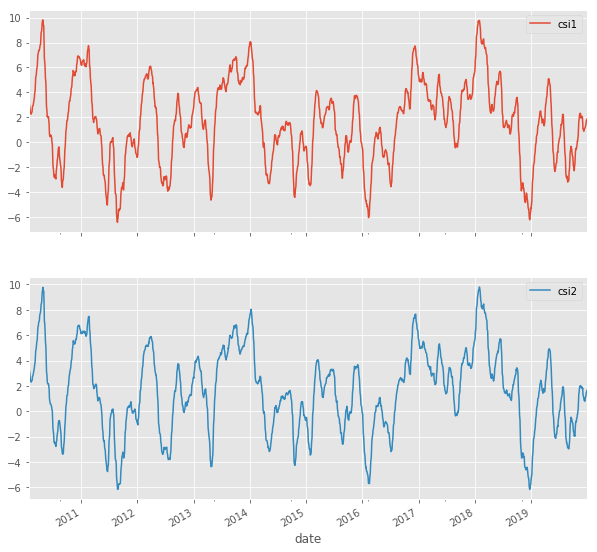

In [66]:
with plt.style.context(("ggplot")):
    df_subset_csi_x.plot(y=["csi1", "csi2"], figsize=(10,10), subplots=True)

#### Correlation Between Tickers & CSI1,CSI2 [CSI1_X]

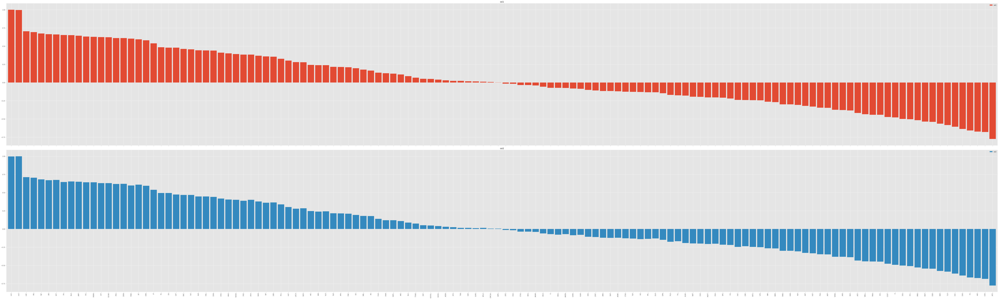

In [26]:
with plt.style.context("ggplot"):
    corr_csi = df_subset_csi_x.corr()[["csi1", "csi2"]]

    corr_csi.sort_values(by="csi1", ascending=False).plot.bar(y=["csi1", "csi2"], width=0.85, subplots=True, figsize=(100,30))

    plt.tight_layout()

    plt.savefig("correlation_csi1_x.png", dpi=150);

### Dataset Based on CSI1_Y

In [67]:
cols_y = ["csi1", "csi2"] + [col for col in df_subset.columns if col in csi1_y_columns]
df_subset_csi_y = df_subset[cols_y]
print("Dataset Size : ", df_subset_csi_y.shape)
df_subset_csi_y.head()

Dataset Size :  (2500, 109)


,csi1,csi2,AAPL,ADM,AIZ,AJG,ALB,AMD,AME,AMT,AMZN,AVY,BIIB,BKNG,BWA,CAT,CDNS,CF,CHRW,CINF,CL,CLX,CME,CMI,CNC,CNP,COF,CSCO,DGX,DISH,DLR,DPZ,DVA,DXC,EBAY,ECL,EMN,EMR,EOG,EQIX,ETN,EW,FCX,FDX,GIS,GOOG,GOOGL,GRMN,GWW,HD,HOLX,INTU,IP,IPG,IT,ITW,J,JBHT,JKHY,JNJ,KO,KSS,LHX,LKQ,LNC,LRCX,LVS,MAS,MCD,MHK,MMM,MSFT,MTD,MXIM,MYL,NBL,NDAQ,NUE,PCAR,PH,PHM,PKG,PPG,PPL,PVH,PWR,PXD,RE,RL,ROK,SEE,SHW,SNA,SNPS,SWK,SYK,SYY,TIF,TSN,TXN,TXT,URI,VAR,VLO,VTR,WAB,WHR,XLNX,YUM
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2010-01-27,3.674661,3.844850,0.270392,0.270873,0.289994,0.204680,0.335610,0.074570,0.146489,0.388418,1.117636,0.349995,0.487845,1.889466,0.160521,0.486570,0.054539,0.175544,0.523172,0.240827,0.365975,0.539379,0.535974,0.422562,0.044819,0.128198,0.332787,0.210780,0.515615,0.169899,0.442775,0.101703,0.276200,0.237166,0.091855,0.406537,0.264318,0.382955,0.420605,0.903669,0.288264,0.069471,0.324365,0.732222,0.325594,2.458689,2.470375,0.305563,0.911591,0.253483,0.139761,0.273240,0.214425,0.058909,0.195393,0.400528,0.358918,0.298917,0.202677,0.577620,0.248156,0.459893,0.426113,0.087726,0.232086,0.323591,0.147865,0.108652,0.580260,0.396158,0.749340,0.270145,0.894382,0.167532,0.166166,0.341437,0.167076,0.387781,0.326960,0.522626,0.094054,0.204134,0.270919,0.254835,0.366202,0.168533,0.413366,0.782027,0.755804,0.462897,0.183830,0.581535,0.384230,0.196030,0.477738,0.481745,0.251389,0.376673,0.125467,0.214240,0.191205,0.075936,0.390984,0.155550,0.447919,0.176500,0.690886,0.222890,0.227854
2010-01-28,3.400242,3.579100,0.262227,0.275859,0.290872,0.208161,0.335636,0.072580,0.149253,0.389795,1.160818,0.350926,0.490651,1.857603,0.158423,0.477664,0.053790,0.175555,0.520770,0.241595,0.368380,0.546099,0.535157,0.419545,0.044948,0.129870,0.338399,0.207424,0.516257,0.169844,0.441927,0.102422,0.276780,0.238591,0.090440,0.404347,0.262411,0.383808,0.421433,0.900433,0.287971,0.069494,0.316938,0.728286,0.331353,2.451390,2.463041,0.302201,0.928065,0.251819,0.138897,0.273188,0.209556,0.060053,0.197568,0.404624,0.350741,0.285162,0.201253,0.587639,0.249516,0.465414,0.408400,0.087271,0.228608,0.307451,0.146081,0.110075,0.578705,0.395505,0.743760,0.268582,0.896564,0.166897,0.165147,0.343373,0.168002,0.381321,0.324491,0.518744,0.097264,0.201621,0.271760,0.254876,0.368426,0.167634,0.416598,0.782076,0.754536,0.459980,0.182095,0.585613,0.380031,0.194713,0.473335,0.480704,0.253661,0.375979,0.127015,0.212305,0.180344,0.076725,0.401983,0.155167,0.449120,0.174081,0.697062,0.221148,0.227386
2010-01-29,3.069967,3.250172,0.255491,0.279076,0.292672,0.209982,0.332619,0.069466,0.150811,0.395288,1.167800,0.302728,0.500419,1.819071,0.163376,0.486451,0.054102,0.172940,0.527330,0.245740,0.372614,0.550982,0.534165,0.420523,0.044813,0.129900,0.343235,0.209237,0.518391,0.170034,0.446969,0.105224,0.278238,0.237327,0.090218,0.408790,0.263200,0.386814,0.420989,0.896080,0.285129,0.069544,0.310504,0.729584,0.332014,2.458148,2.469832,0.300866,0.924481,0.260825,0.140330,0.275724,0.210389,0.060155,0.199274,0.405904,0.351895,0.285501,0.204488,0.585343,0.252584,0.469038,0.399665,0.087299,0.228885,0.307384,0.144334,0.110957,0.581339,0.385604,0.749511,0.262408,0.907626,0.162771,0.169755,0.344259,0.167520,0.379924,0.335506,0.520626,0.097961,0.205233,0.273210,0.255769,0.365863,0.169662,0.409535,0.798398,0.763572,0.449204,0.184747,0.589906,0.380669,0.198063,0.477233,0.483471,0.260639,0.378154,0.128690,0.209517,0.181861,0.074588,0.410646,0.156786,0.448738,0.178462,0.700065,0.219574,0.229014
2010-02-01,2.854584,3.033730,0.255076,0.276545,0.290391,0.208876,0.332386,0.073171,0.149805,0.395012,1.089951,0.305703,0.494315,1.872364,0.164588,0.485421,0.054190,0.174730,0.526316,0.241243,0.366496,0.545388,0.534055,0.430405,0.044196,0.130754,0.337246,0.208417,0.517513,0.174308,0.442875,0.104163,0.277049,0.239205,0.089416,0.406840,0.274940,0.389510,0.438062,0.878874,0.295113,0.068945,0.328214,0.739685,0.325646,2.434575,2.446147,0.298276,0.916376,0.260

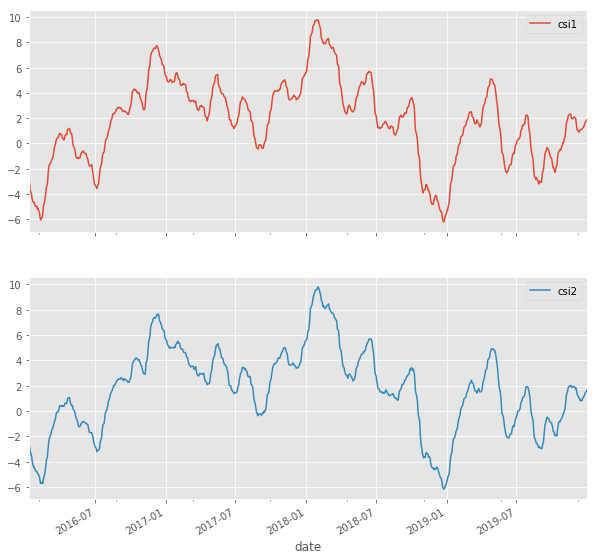

In [28]:
with plt.style.context(("ggplot")):
    df_subset_csi_y.plot(y=["csi1", "csi2"], figsize=(10,10), subplots=True)

#### Correlation Between Tickers & CSI1,CSI2 [CSI1_Y]

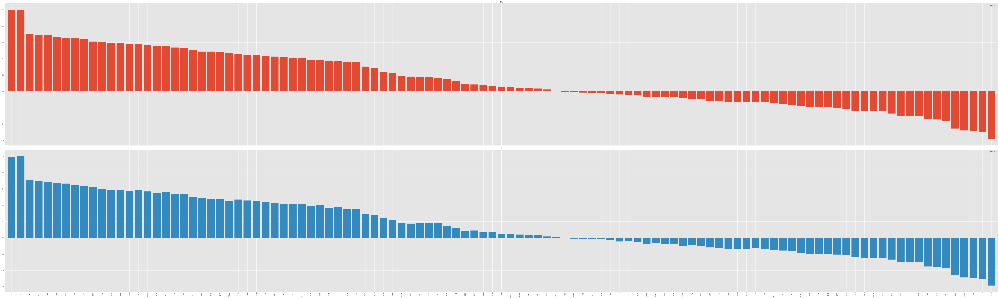

In [29]:
with plt.style.context("ggplot"):
    corr_csi = df_subset_csi_y.corr()[["csi1", "csi2"]]

    corr_csi.sort_values(by="csi1", ascending=False).plot.bar(y=["csi1", "csi2"], width=0.85, subplots=True, figsize=(100,30))

    plt.tight_layout()

    plt.savefig("correlation_csi1_y.png", dpi=150);

## Testing for Stationarity of Time Series [CSI1 & CSI2]

### CSI1

In [30]:
dftest = adfuller(df_subset['csi1'], autolag = 'AIC')

print("1. ADF : ",dftest[0])
print("2. P-Value : ", dftest[1])
print("2. P-Value : %.3f"%(dftest[1]))
print("3. Num Of Lags : ", dftest[2])
print("4. Num Of Observations Used For ADF Regression and Critical Values Calculation :", dftest[3])
print("5. Critical Values :")
for key, val in dftest[4].items():
    print("\t",key, ": ", val)

1. ADF :  -4.054647691314602
2. P-Value :  0.0011498983311168398
2. P-Value : 0.001
3. Num Of Lags :  3
4. Num Of Observations Used For ADF Regression and Critical Values Calculation : 996
5. Critical Values :
	 1% :  -3.4369325637409154
	 5% :  -2.8644462162311934
	 10% :  -2.568317409920808


P-value of `0.001` is less than `0.05` implies that time-series is **stationary**.

### CSI2

In [31]:
dftest = adfuller(df_subset['csi2'], autolag = 'AIC')

print("1. ADF : ",dftest[0])
print("2. P-Value : ", dftest[1])
print("2. P-Value : %.3f"%(dftest[1]))
print("3. Num Of Lags : ", dftest[2])
print("4. Num Of Observations Used For ADF Regression and Critical Values Calculation :", dftest[3])
print("5. Critical Values :")
for key, val in dftest[4].items():
    print("\t",key, ": ", val)

1. ADF :  -3.58842699993108
2. P-Value :  0.005986172342860774
2. P-Value : 0.006
3. Num Of Lags :  8
4. Num Of Observations Used For ADF Regression and Critical Values Calculation : 991
5. Critical Values :
	 1% :  -3.4369658620871286
	 5% :  -2.8644609013346485
	 10% :  -2.56832523159495


P-value of `0.005` is less than `0.05` implies that time-series is **stationary**.

## Method 1 : Using CSI1_X to Determine Columns of Data

### Dividing Dataset into Train/Test Sets

In [72]:
# "Difference" the data (statistics term)
n_obs=5 ## Beyond 5 results detriorate for majority of predictions

final_cols = df_subset_csi_x.columns[:46] ## Beyond 46 , it fails with memory error.

X_train, X_test = df_subset_csi_x[final_cols][0:-n_obs], df_subset_csi_x[final_cols][-n_obs:]
print(X_train.shape, X_test.shape)

(2490, 100) (10, 100)


### Differencing Time-Series to Remove Trend/Seasonality i.e converting it to Stationary Time-Series

In [73]:
X_train_transformed = X_train.diff().dropna()
print("Dataset Size : ", X_train_transformed.shape)
X_train_transformed.head()

Dataset Size :  (2489, 100)


,csi1,csi2,AAP,AAPL,ADBE,ADP,ADSK,AEE,AIG,AKAM,ALB,AMD,AMP,AMZN,APA,ARE,ATO,ATVI,AVB,AZO,BAC,BLK,BSX,BXP,CAH,CAT,CERN,CHD,CLX,CMA,CMCSA,CME,COO,COST,CPRT,CTAS,CTXS,DE,DLR,DPZ,DVA,DVN,EA,ECL,EFX,EOG,EQR,ESS,EXC,EXPE,EXR,FE,FIS,FLIR,FMC,FRT,GL,GOOG,GOOGL,GPN,HAL,HBAN,HD,HES,HRB,HST,HSY,HUM,IBM,INTU,IP,K,KEY,LNC,LRCX,MAA,MCO,MDT,MOS,MRK,MRO,MS,MSFT,NBL,NFLX,NKE,NOV,NVDA,O,ODFL,OXY,PEP,PFE,PGR,PH,PHM,PLD,PPL,PRU,PSA
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2010-01-28,-0.274419,-0.265749,-0.003264,-0.008165,0.001199,0.001056,-0.003678,0.000352,-0.004276,-0.002060,0.000026,-0.001990,-0.004335,0.043182,0.013386,0.000813,0.002779,0.000082,0.004673,0.007682,0.003263,-0.041710,-0.000991,0.009823,0.018045,-0.008906,-0.002933,0.001472,0.006720,0.001990,-0.000222,-0.000817,0.000102,0.004421,-0.000259,0.000270,0.008887,-0.006254,-0.000848,0.000720,0.000580,-0.000317,-0.001506,-0.002190,-0.000471,0.000829,0.001954,0.003323,0.001943,-0.003431,0.000284,-0.000485,-0.001770,-0.002020,-0.002473,0.001994,-0.000388,-0.007299,-0.007334,0.001345,-0.003787,0.001529,-0.001664,-0.003172,0.000116,0.000238,0.002467,0.003061,-0.010415,-0.000053,-0.004869,0.003606,0.001861,-0.003478,-0.016140,0.004916,-0.001651,0.000738,-0.016709,-0.002088,0.000815,-0.001284,-0.001562,0.001936,0.016651,0.000585,-0.007787,-0.003399,0.002389,0.001890,0.017180,0.001305,-0.001400,-0.000142,-0.003882,0.003210,-0.003198,0.000041,-0.004123,-0.004538
2010-01-29,-0.330275,-0.328929,0.001045,-0.006736,-0.002165,0.004514,0.002408,0.000928,0.003097,-0.003119,-0.003017,-0.003113,-0.012064,0.006982,-0.016899,0.001163,-0.000889,0.000199,0.004438,0.012098,-0.000214,-0.031966,0.000044,0.001776,0.004821,0.008787,-0.008701,0.000167,0.004883,-0.002863,0.001768,-0.000992,0.002561,0.006549,-0.000044,0.003923,-0.005159,-0.005629,0.005042,0.002802,0.001458,-0.008057,-0.002866,0.004443,0.005725,-0.000444,0.001125,-0.007869,0.001485,-0.000640,0.001609,0.004046,0.000634,-0.000875,0.001397,0.005042,0.000914,0.006758,0.006790,-0.001340,-0.001096,-0.001357,0.009006,0.005112,-0.000217,-0.001414,-0.002761,0.003355,-0.000140,0.002536,0.000833,0.001915,-0.000102,0.000277,-0.000067,0.008433,-0.003931,0.001762,-0.013466,0.005798,-0.000178,-0.003829,-0.006174,0.000886,-0.000139,0.002143,-0.001168,-0.004890,0.004208,0.000497,0.015008,0.004929,0.002165,0.000112,0.001882,0.000696,0.002245,0.000892,-0.000467,0.013816
2010-02-01,-0.215383,-0.216442,0.003911,-0.000415,-0.002955,-0.002852,-0.003209,-0.004193,-0.005931,0.010049,-0.000234,0.003704,0.008485,-0.077849,0.019201,0.000561,-0.004122,-0.002182,0.002280,-0.008627,0.000036,-0.005273,-0.003156,0.009089,0.000694,-0.001030,0.001956,-0.002310,-0.005595,0.003698,-0.000624,-0.000111,-0.006595,-0.003788,-0.000607,-0.002572,0.000831,0.005715,-0.004094,-0.001061,-0.001189,0.016592,0.001897,-0.001950,0.008274,0.017073,0.002032,0.000557,-0.004304,0.006548,-0.000610,-0.005028,-0.001526,-0.001284,0.003530,0.004574,-0.000645,-0.023573,-0.023685,-0.000880,0.009039,0.000326,-0.000510,0.009456,-0.002518,0.001606,-0.001710,-0.006107,0.003454,-0.001471,0.005731,-0.005009,0.000443,-0.000296,0.000886,-0.002381,-0.000908,-0.003732,0.017677,-0.004344,0.002059,0.003333,-0.001909,0.003348,-0.002866,-0.001470,0.004580,0.008625,-0.004624,0.000495,0.002387,0.001402,-0.001469,-0.000805,0.003306,-0.001133,0.001988,-0.002806,0.004150,0.000538
2010-02-02,-0.135485,-0.185680,0.001902,-0.001588,0.000968,-0.003079,-0.001342,-0.000258,-0.002537,-0.001149,0.001914,-0.001509,-0.002367,-0.019829,0.008974,0.000408,-0.002392,0.000435,0.005303,-0.007376,-0.000060,-0.028911,-0.001104,0.001093,0.001654,-0.000279,0.000588,0.002652,0.000544,-0.006152,0.000712,-0.002781,0.002034,0.001441,-0.000072,-0.000772,-0.003406,0.004335,0.006210,-0.003420,0.001534,0.006484,0.001154,-0.002057,-0.003844,0.001465,0.001661,0.003803,-0.002492,-0.005390,0.001099,-0.001626,-0.000884,-0.001648,-0.000145,0.010261,0.000846,-0.037689,-0.037868,-0.001018,-0.002364,-0

### Stationarity Test on Transformed Time-Series

#### CSI1

In [74]:
dftest = adfuller(X_train_transformed['csi1'], autolag = 'AIC')

print("1. ADF : ",dftest[0])
print("2. P-Value : ", dftest[1])
print("2. P-Value : %.3f"%(dftest[1]))
print("3. Num Of Lags : ", dftest[2])
print("4. Num Of Observations Used For ADF Regression and Critical Values Calculation :", dftest[3])
print("5. Critical Values :")
for key, val in dftest[4].items():
    print("\t",key, ": ", val)

1. ADF :  -13.151548166624005
2. P-Value :  1.3637241409088112e-24
2. P-Value : 0.000
3. Num Of Lags :  1
4. Num Of Observations Used For ADF Regression and Critical Values Calculation : 2487
5. Critical Values :
	 1% :  -3.4329821119179256
	 5% :  -2.862702850392563
	 10% :  -2.5673890307492004


P-value of `2.11e-14` is less than 0.05 implies that time-series is **stationary**.

#### CSI2

In [45]:
dftest = adfuller(X_train_transformed['csi2'], autolag = 'AIC')

print("1. ADF : ",dftest[0])
print("2. P-Value : ", dftest[1])
print("2. P-Value : %.3f"%(dftest[1]))
print("3. Num Of Lags : ", dftest[2])
print("4. Num Of Observations Used For ADF Regression and Critical Values Calculation :", dftest[3])
print("5. Critical Values :")
for key, val in dftest[4].items():
    print("\t",key, ": ", val)

1. ADF :  -9.608048389945159
2. P-Value :  1.8433640726476437e-16
2. P-Value : 0.000
3. Num Of Lags :  19
4. Num Of Observations Used For ADF Regression and Critical Values Calculation : 1969
5. Critical Values :
	 1% :  -3.433675467561267
	 5% :  -2.863008999826203
	 10% :  -2.5675520348463654


P-value of `4.59e-11` is less than 0.05 implies that time-series is **stationary**.

### Fitting VAR Model on Transformed Train Data

In [75]:
model = VAR(X_train_transformed)
res = model.fit(maxlags=15, ic='aic')

#aic : Akaike
#fpe : Final prediction error
#hqic : Hannan-Quinn
#bic : Bayesian a.k.a. Schwarz

print(res.summary())

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Mon, 17, Aug, 2020
Time:                     21:46:06
--------------------------------------------------------------------
No. of Equations:         100.000    BIC:                   -1081.29
Nobs:                     2488.00    HQIC:                  -1096.33
Log likelihood:       1.03158e+06    FPE:                    0.00000
AIC:                     -1104.91    Det(Omega_mle):         0.00000
--------------------------------------------------------------------
Results for equation csi1
              coefficient       std. error           t-stat            prob
---------------------------------------------------------------------------
const            0.000779         0.001987            0.392           0.695
L1.csi1          0.892169         0.028175           31.665           0.000
L1.csi2         -0.028626         0.028053           -1.020           0.308
L1.AA

### Plotting Prediction vs Residuals

#### CSI1

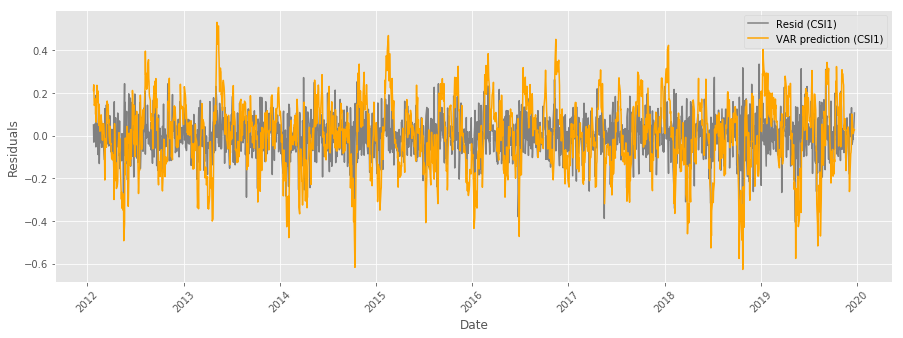

In [26]:
with plt.style.context(("ggplot")):
    y_fitted = res.fittedvalues
    plt.figure(figsize = (15,5))
    plt.plot(res.resid[["csi1"]], label='Resid (CSI1)', color="gray")
    plt.plot(y_fitted["csi1"], label='VAR prediction (CSI1)', color="orange")
    plt.xlabel('Date')
    plt.xticks(rotation=45)
    plt.ylabel('Residuals')
    plt.grid(True)
    plt.legend()

#### CSI2

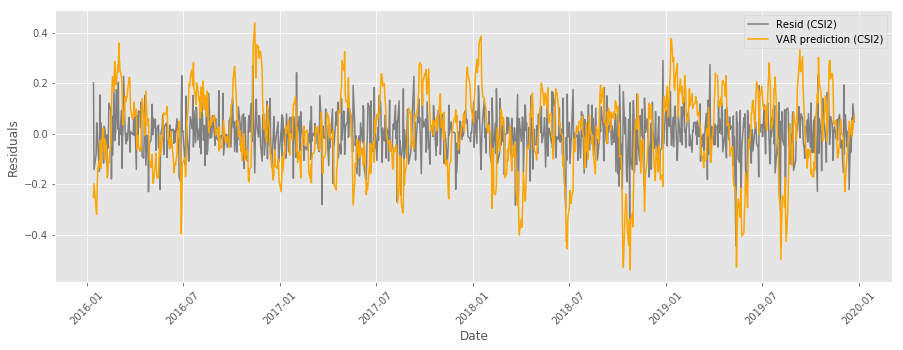

In [38]:
with plt.style.context(("ggplot")):
    y_fitted = res.fittedvalues
    plt.figure(figsize = (15,5))
    plt.plot(res.resid[["csi2"]], label='Resid (CSI2)', color="gray")
    plt.plot(y_fitted["csi2"], label='VAR prediction (CSI2)', color="orange")
    plt.xlabel('Date')
    plt.xticks(rotation=45)
    plt.ylabel('Residuals')
    plt.grid(True)
    plt.legend()

### Durbin Watson Test

In [28]:
out = durbin_watson(res.resid)
out.shape

(60,)

In [29]:
for col, val in zip(final_cols, out):
    print(col , " : ", val)

csi1  :  1.9874394775572775
csi2  :  2.1769630368099104
AAP  :  2.0021030130689077
AAPL  :  1.986271535496019
ADBE  :  1.9851546528114918
ADP  :  2.017820948958628
ADSK  :  1.9891064298417283
AEE  :  2.010778841814976
AIG  :  2.0084600637446073
AKAM  :  2.0003377251242553
ALB  :  1.9917211380980409
AMD  :  2.0079850564815014
AMP  :  2.0078236573298116
AMZN  :  1.998372716362462
APA  :  1.9949802701874357
ARE  :  1.9964707628779286
ATO  :  2.007930011055327
ATVI  :  1.9911656914113947
AVB  :  1.9982485340040257
AZO  :  2.0045366657989234
BAC  :  2.0074008065503293
BLK  :  2.0162134625594383
BSX  :  2.0252418464606183
BXP  :  2.000842316482272
CAH  :  2.002881083042223
CAT  :  2.003020927440072
CERN  :  1.9995601221488981
CHD  :  1.98239723069407
CLX  :  1.995175518561992
CMA  :  2.0042630237530363
CMCSA  :  1.9965419931171788
CME  :  2.021275138715378
COO  :  1.9903784598857215
COST  :  2.0005777333950108
CPRT  :  2.0124880214360923
CTAS  :  2.010130771304544
CTXS  :  2.0024267927488313

### Future Prediction

In [76]:
lag_order = res.k_ar

print("Lag samples to use for future predictions : ", lag_order)
# Input data for forecasting
input_data = X_train_transformed.values[-lag_order:]
#print(input_data)
# forecasting
pred = res.forecast(y=input_data, steps=n_obs)
pred = (pd.DataFrame(pred, index=X_test.index, columns=X_test.columns + '_pred'))
pred

Lag samples to use for future predictions :  1


,csi1_pred,csi2_pred,AAP_pred,AAPL_pred,ADBE_pred,ADP_pred,ADSK_pred,AEE_pred,AIG_pred,AKAM_pred,ALB_pred,AMD_pred,AMP_pred,AMZN_pred,APA_pred,ARE_pred,ATO_pred,ATVI_pred,AVB_pred,AZO_pred,BAC_pred,BLK_pred,BSX_pred,BXP_pred,CAH_pred,CAT_pred,CERN_pred,CHD_pred,CLX_pred,CMA_pred,CMCSA_pred,CME_pred,COO_pred,COST_pred,CPRT_pred,CTAS_pred,CTXS_pred,DE_pred,DLR_pred,DPZ_pred,DVA_pred,DVN_pred,EA_pred,ECL_pred,EFX_pred,EOG_pred,EQR_pred,ESS_pred,EXC_pred,EXPE_pred,EXR_pred,FE_pred,FIS_pred,FLIR_pred,FMC_pred,FRT_pred,GL_pred,GOOG_pred,GOOGL_pred,GPN_pred,HAL_pred,HBAN_pred,HD_pred,HES_pred,HRB_pred,HST_pred,HSY_pred,HUM_pred,IBM_pred,INTU_pred,IP_pred,K_pred,KEY_pred,LNC_pred,LRCX_pred,MAA_pred,MCO_pred,MDT_pred,MOS_pred,MRK_pred,MRO_pred,MS_pred,MSFT_pred,NBL_pred,NFLX_pred,NKE_pred,NOV_pred,NVDA_pred,O_pred,ODFL_pred,OXY_pred,PEP_pred,PFE_pred,PGR_pred,PH_pred,PHM_pred,PLD_pred,PPL_pred,PRU_pred,PSA_pred
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-12-17,0.036243,0.022072,0.002792,-0.001953,-0.002370,-0.001326,-0.000022,2.709580e-04,0.000893,0.000067,0.000811,-0.000020,0.002351,0.007459,-0.000689,0.001739,-0.000268,0.000177,1.714473e-03,0.004530,0.000041,0.001031,0.000560,0.001861,0.000858,0.000562,0.000452,0.000879,0.000118,-5.684951e-04,0.000222,0.000283,0.000263,0.000039,-0.000413,-0.000241,0.000035,-0.000546,0.001264,-0.001857,7.900237e-04,-0.000052,-0.000456,0.001183,-0.001509,-0.000052,0.001008,0.001992,0.000266,0.001628,0.000374,-0.000500,-0.000878,0.000122,0.000416,0.000514,0.000250,0.006491,0.006462,-0.000059,0.000139,-0.000027,-0.000843,0.000588,0.000031,0.000162,-0.001013,-0.000267,0.000749,0.000165,0.000189,0.000785,-3.436107e-05,9.660340e-05,-0.000515,0.000009,-0.000223,0.000090,0.000397,-0.000343,-0.000172,-0.000146,-0.001115,-0.000387,-0.002002,0.000319,0.000346,0.001263,0.000301,0.000192,-0.000275,0.000154,0.000240,0.000478,0.000334,0.000315,0.000646,-0.000279,0.000333,0.001049
2019-12-18,0.030259,0.029416,-0.000323,0.000334,0.000705,0.000396,0.000476,-1.136065e-04,-0.000096,-0.000209,0.000005,-0.000005,0.000043,0.000736,-0.000721,-0.000212,0.000019,0.000129,-8.970048e-04,-0.000565,-0.000061,-0.000916,-0.000119,-0.000340,-0.000172,0.000038,0.000006,-0.000005,0.000113,1.596790e-05,0.000024,0.000432,0.000011,-0.000271,0.000111,0.000392,0.000084,-0.000142,-0.000368,-0.000077,7.367149e-05,-0.000196,0.000007,-0.000198,-0.000183,-0.000289,-0.000285,-0.000851,-0.000108,-0.000765,-0.000064,-0.000122,0.000228,0.000022,0.000028,-0.000291,0.000047,0.002169,0.002517,0.000264,-0.000252,0.000003,0.000247,-0.000426,-0.000114,-0.000036,0.000164,0.000277,0.000141,0.000266,-0.000184,-0.000287,2.900143e-05,6.261189e-05,0.000086,-0.000322,0.000046,-0.000029,-0.000237,0.000137,-0.000153,-0.000074,0.000221,-0.000223,0.000942,-0.000087,-0.000332,0.000653,-0.000155,0.000274,-0.000216,0.000129,-0.000010,-0.000047,0.000469,-0.000027,-0.000014,-0.000101,-0.000126,-0.000865
2019-12-19,0.026256,0.026713,0.000028,0.000274,0.000266,-0.000003,0.000155,1.228742e-06,-0.000003,-0.000002,-0.000174,0.000038,0.000185,0.001980,-0.000285,0.000003,-0.000010,-0.000026,4.980721e-07,0.000828,0.000005,-0.000328,0.000029,-0.000062,-0.000074,-0.000043,-0.000038,-0.000029,-0.000056,-4.010075e-07,0.000032,0.000026,0.000177,0.000210,0.000066,0.000187,0.000096,0.000027,-0.000009,0.000357,-8.233054e-05,-0.000231,0.000088,0.000083,0.000008,-0.000014,-0.000018,0.000125,-0.000107,-0.000055,0.000002,-0.000102,0.000062,-0.000091,0.000037,-0.000149,0.000054,0.000929,0.000854,0.000092,-0.000090,0.000011,0.000160,-0.000054,-0.000072,-0.000002,0.000023,0.000307,-0.000221,0.000173,-0.000001,-0.000117,5.333297e-06,-2.986503e-06,0.000236,-0.000049,0.000140,-0.000050,-0.000216,-0.000066,-0.000012,-0.000023,0.000078,-0.000108,0.000537,0.000053,-0.000133,0.000190,-0.000019,0.000107,-0.000241,-0.000153,-0.000035,0.000009,-0.000090,0.000003,0.000025,-0.000066,-0.000026,-0.000187
2019-12-20,0.022326,0.023003,0.000051,

### Inverting Predictions to Get Original Predictions

In [77]:
def invert_transformation(X_train, pred):
    forecast = pred.copy()
    columns = X_train.columns
    for col in columns:
        forecast[str(col)+'_pred'] = X_train[col].iloc[-1] + forecast[str(col)+'_pred'].cumsum()
    return forecast

output = invert_transformation(X_train, pred)

output

,csi1_pred,csi2_pred,AAP_pred,AAPL_pred,ADBE_pred,ADP_pred,ADSK_pred,AEE_pred,AIG_pred,AKAM_pred,ALB_pred,AMD_pred,AMP_pred,AMZN_pred,APA_pred,ARE_pred,ATO_pred,ATVI_pred,AVB_pred,AZO_pred,BAC_pred,BLK_pred,BSX_pred,BXP_pred,CAH_pred,CAT_pred,CERN_pred,CHD_pred,CLX_pred,CMA_pred,CMCSA_pred,CME_pred,COO_pred,COST_pred,CPRT_pred,CTAS_pred,CTXS_pred,DE_pred,DLR_pred,DPZ_pred,DVA_pred,DVN_pred,EA_pred,ECL_pred,EFX_pred,EOG_pred,EQR_pred,ESS_pred,EXC_pred,EXPE_pred,EXR_pred,FE_pred,FIS_pred,FLIR_pred,FMC_pred,FRT_pred,GL_pred,GOOG_pred,GOOGL_pred,GPN_pred,HAL_pred,HBAN_pred,HD_pred,HES_pred,HRB_pred,HST_pred,HSY_pred,HUM_pred,IBM_pred,INTU_pred,IP_pred,K_pred,KEY_pred,LNC_pred,LRCX_pred,MAA_pred,MCO_pred,MDT_pred,MOS_pred,MRK_pred,MRO_pred,MS_pred,MSFT_pred,NBL_pred,NFLX_pred,NKE_pred,NOV_pred,NVDA_pred,O_pred,ODFL_pred,OXY_pred,PEP_pred,PFE_pred,PGR_pred,PH_pred,PHM_pred,PLD_pred,PPL_pred,PRU_pred,PSA_pred
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-12-17,1.132706,0.876347,0.483230,0.873979,1.011089,0.526343,0.577036,0.237391,0.163335,0.267673,0.208009,0.132531,0.526420,5.544893,0.068387,0.491160,0.339106,0.183620,0.657020,3.839334,0.108649,1.572393,0.142032,0.426431,0.168933,0.455522,0.227901,0.216591,0.474578,0.224314,0.136466,0.636214,0.998604,0.918662,0.281872,0.815815,0.349643,0.540456,0.362735,0.912541,0.227644,0.074596,0.330436,0.583280,0.431198,0.243798,0.256094,0.944058,0.140172,0.359156,0.323503,0.151331,0.427948,0.165005,0.311902,0.402549,0.332456,4.266804,4.265303,0.561130,0.076352,0.047986,0.673742,0.202779,0.073083,0.057345,0.458392,1.144897,0.420562,0.824891,0.144790,0.208234,0.062908,0.189205,0.889157,0.408585,0.738745,0.358588,0.061367,0.279125,0.040924,0.158602,0.485677,0.070849,0.950142,0.309584,0.074994,0.705958,0.228908,0.388320,0.119662,0.429136,0.122744,0.223013,0.650068,0.125573,0.277203,0.113179,0.296076,0.646370
2019-12-18,1.162965,0.905763,0.482907,0.874313,1.011794,0.526739,0.577512,0.237278,0.163238,0.267463,0.208014,0.132525,0.526463,5.545629,0.067666,0.490947,0.339126,0.183749,0.656123,3.838769,0.108587,1.571477,0.141913,0.426091,0.168761,0.455561,0.227906,0.216586,0.474691,0.224330,0.136490,0.636645,0.998615,0.918390,0.281983,0.816208,0.349728,0.540313,0.362367,0.912464,0.227718,0.074400,0.330442,0.583083,0.431015,0.243509,0.255809,0.943207,0.140064,0.358391,0.323439,0.151209,0.428176,0.165026,0.311931,0.402258,0.332503,4.268973,4.267820,0.561394,0.076101,0.047989,0.673989,0.202353,0.072969,0.057309,0.458556,1.145174,0.420702,0.825157,0.144606,0.207947,0.062937,0.189267,0.889242,0.408263,0.738791,0.358559,0.061130,0.279262,0.040771,0.158528,0.485898,0.070626,0.951084,0.309496,0.074662,0.706611,0.228753,0.388594,0.119446,0.429265,0.122734,0.222966,0.650537,0.125546,0.277189,0.113078,0.295951,0.645505
2019-12-19,1.189222,0.932476,0.482936,0.874587,1.012060,0.526736,0.577668,0.237279,0.163236,0.267462,0.207841,0.132563,0.526648,5.547609,0.067381,0.490951,0.339115,0.183723,0.656123,3.839598,0.108592,1.571149,0.141942,0.426030,0.168687,0.455518,0.227868,0.216557,0.474634,0.224330,0.136522,0.636671,0.998792,0.918600,0.282050,0.816395,0.349824,0.540340,0.362359,0.912821,0.227636,0.074169,0.330531,0.583166,0.431024,0.243494,0.255791,0.943331,0.139957,0.358335,0.323441,0.151107,0.428238,0.164936,0.311968,0.402109,0.332557,4.269902,4.268674,0.561486,0.076010,0.048000,0.674149,0.202299,0.072897,0.057306,0.458579,1.145481,0.420481,0.825331,0.144605,0.207831,0.062942,0.189264,0.889479,0.408214,0.738931,0.358509,0.060914,0.279196,0.040759,0.158505,0.485976,0.070518,0.951621,0.309549,0.074529,0.706801,0.228733,0.388701,0.119205,0.429112,0.122699,0.222976,0.650447,0.125548,0.277214,0.113012,0.295925,0.645318
2019-12-20,1.211548,0.955479,0.482987,0.874834,1.012254,0.526813,0.577794,0.237280,0.163225,0.267444,0.207777,0.132585,0.526743,5.549267,0.067065,0.490947,0.339144,0.183737,0.656079,3.840525,0.108588,1.571050,0.141965,0.425950,0.168672,0.455500,0

### Checking Model Performance

#### CSI1

In [78]:
#combining predicted and real data set
combine_csi1_x = pd.concat([output['csi1_pred'], X_test['csi1']], axis=1)
combine_csi1_x['accuracy'] = round(combine_csi1_x.apply(lambda row: row.csi1_pred /row.csi1 *100, axis = 1),2)
combine_csi1_x['accuracy'] = pd.Series(["{0:.2f}%".format(val) for val in combine_csi1_x['accuracy']],index = combine_csi1_x.index)
combine_csi1_x = combine_csi1_x.round(decimals=2).reset_index()
combine_csi1_x = combine_csi1_x.sort_values(by='date', ascending=False)
combine_csi1_x

,date,csi1_pred,csi1,accuracy
9,2019-12-31,1.29,1.86,69.61%
8,2019-12-30,1.28,1.79,71.58%
7,2019-12-27,1.27,1.73,73.81%
6,2019-12-26,1.26,1.61,78.14%
5,2019-12-24,1.25,1.44,86.74%
4,2019-12-23,1.23,1.34,91.72%
3,2019-12-20,1.21,1.21,100.24%
2,2019-12-19,1.19,1.17,101.28%
1,2019-12-18,1.16,1.14,101.65%
0,2019-12-17,1.13,1.13,100.42%


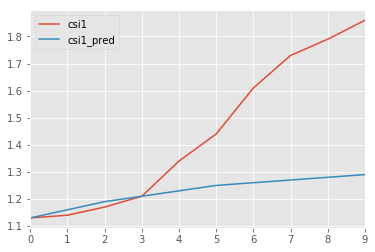

In [79]:
with plt.style.context("ggplot"):
    combine_csi1_x.plot(y=["csi1", "csi1_pred"])

In [80]:
#Forecast bias
forecast_errors = [combine_csi1_x['csi1'][i]- combine_csi1_x['csi1_pred'][i] for i in range(len(combine_csi1_x['csi1']))]
bias = sum(forecast_errors) * 1.0/len(combine_csi1_x['csi1'])
print('Bias: %f' % bias)
print('Mean absolute error:', mean_absolute_error(combine_csi1_x['csi1'].values, combine_csi1_x['csi1_pred'].values))
print('Mean squared error:', mean_squared_error(combine_csi1_x['csi1'].values, combine_csi1_x['csi1_pred'].values))
print('Root mean squared error:', np.sqrt(mean_squared_error(combine_csi1_x['csi1'].values, combine_csi1_x['csi1_pred'].values)))

Bias: 0.215000
Mean absolute error: 0.223
Mean squared error: 0.09681
Root mean squared error: 0.31114305391571895


#### CSI2

In [81]:
#combining predicted and real data set
combine_csi2_x = pd.concat([output['csi2_pred'], X_test['csi2']], axis=1)
combine_csi2_x['accuracy'] = round(combine_csi2_x.apply(lambda row: row.csi2_pred /row.csi2 *100, axis = 1),2)
combine_csi2_x['accuracy'] = pd.Series(["{0:.2f}%".format(val) for val in combine_csi2_x['accuracy']],index = combine_csi2_x.index)
combine_csi2_x = combine_csi2_x.round(decimals=2)
combine_csi2_x = combine_csi2_x.reset_index()
combine_csi2_x = combine_csi2_x.sort_values(by='date', ascending=False)
combine_csi2_x

,date,csi2_pred,csi2,accuracy
9,2019-12-31,1.04,1.65,63.15%
8,2019-12-30,1.03,1.56,65.96%
7,2019-12-27,1.02,1.48,68.99%
6,2019-12-26,1.01,1.37,73.31%
5,2019-12-24,0.99,1.22,81.32%
4,2019-12-23,0.98,1.15,85.05%
3,2019-12-20,0.96,1.03,93.12%
2,2019-12-19,0.93,0.89,104.53%
1,2019-12-18,0.91,0.84,107.35%
0,2019-12-17,0.88,0.79,110.49%


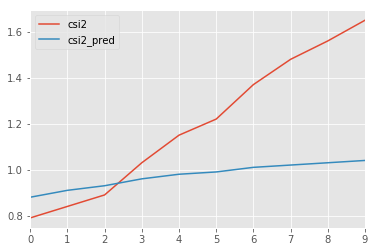

In [82]:
with plt.style.context("ggplot"):
    combine_csi2_x.plot(y=["csi2", "csi2_pred"])

In [83]:
#Forecast bias
forecast_errors = [combine_csi2_x['csi2'][i]- combine_csi2_x['csi2_pred'][i] for i in range(len(combine_csi2_x['csi2']))]
bias = sum(forecast_errors) * 1.0/len(combine_csi2_x['csi2'])
print('Bias: %f' % bias)
print('Mean absolute error:', mean_absolute_error(combine_csi2_x['csi2'].values, combine_csi2_x['csi2_pred'].values))
print('Mean squared error:', mean_squared_error(combine_csi2_x['csi2'].values, combine_csi2_x['csi2_pred'].values))
print('Root mean squared error:', np.sqrt(mean_squared_error(combine_csi2_x['csi2'].values, combine_csi2_x['csi2_pred'].values)))

Bias: 0.223000
Mean absolute error: 0.263
Mean squared error: 0.10955
Root mean squared error: 0.3309833832687073


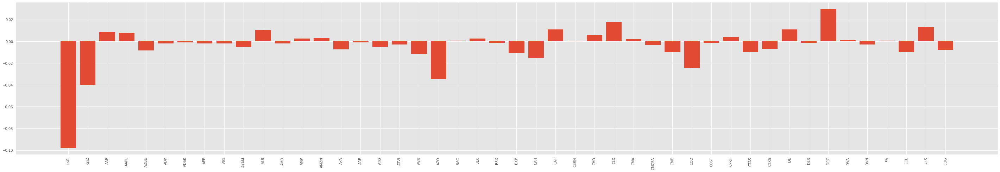

In [49]:
with plt.style.context(('seaborn','ggplot')):
    plt.figure(figsize=(50,8))
    plt.bar(x=X_train_transformed.columns, height=res.coefs.mean(axis=2).flatten(), width=0.8)
    plt.xticks(rotation='vertical')
    plt.savefig("weights_var_11.png", dpi=200)

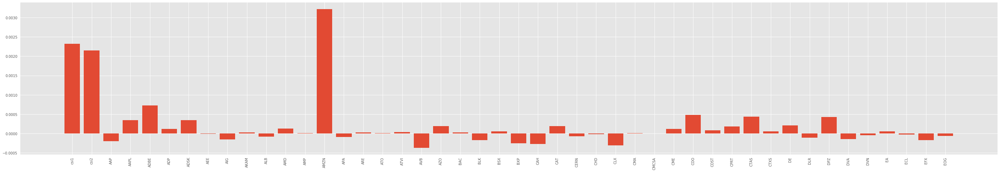

In [50]:
with plt.style.context(('seaborn','ggplot')):
    plt.figure(figsize=(50,8))
    plt.bar(x=X_train_transformed.columns, height=res.coefs_exog.flatten(), width=0.8)
    plt.xticks(rotation='vertical')
    plt.savefig("weights_var_12.png", dpi=200)

## Method 2 : Using CSI1_y to Determine Columns of Data

### Dividing Dataset into Train/Test Sets

In [84]:
# "Difference" the data (statistics term)
n_obs=5 ## Beyond 5 results detriorate for majority of predictions

final_cols = df_subset_csi_y.columns[:47] ## Beyond 47 , it fails with memory error.

X_train, X_test = df_subset_csi_y[final_cols][0:-n_obs], df_subset_csi_y[final_cols][-n_obs:]
print(X_train.shape, X_test.shape)

(2493, 100) (7, 100)


### Differencing Time-Series to Remove Trend/Seasonality i.e converting it to Stationary Time-Series

In [85]:
X_train_transformed = X_train.diff().dropna()
print("Dataset Size : ", X_train_transformed.shape)
X_train_transformed.head()

Dataset Size :  (2492, 100)


,csi1,csi2,AAPL,ADM,AIZ,AJG,ALB,AMD,AME,AMT,AMZN,AVY,BIIB,BKNG,BWA,CAT,CDNS,CF,CHRW,CINF,CL,CLX,CME,CMI,CNC,CNP,COF,CSCO,DGX,DISH,DLR,DPZ,DVA,DXC,EBAY,ECL,EMN,EMR,EOG,EQIX,ETN,EW,FCX,FDX,GIS,GOOG,GOOGL,GRMN,GWW,HD,HOLX,INTU,IP,IPG,IT,ITW,J,JBHT,JKHY,JNJ,KO,KSS,LHX,LKQ,LNC,LRCX,LVS,MAS,MCD,MHK,MMM,MSFT,MTD,MXIM,MYL,NBL,NDAQ,NUE,PCAR,PH,PHM,PKG,PPG,PPL,PVH,PWR,PXD,RE,RL,ROK,SEE,SHW,SNA,SNPS,SWK,SYK,SYY,TIF,TSN,TXN
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2010-01-28,-0.274419,-0.265749,-0.008165,0.004986,0.000879,0.003481,0.000026,-0.001990,0.002764,0.001376,0.043182,0.000930,0.002806,-0.031862,-0.002098,-0.008906,-0.000749,0.000011,-0.002402,0.000769,0.002405,0.006720,-0.000817,-0.003017,0.000129,0.001672,0.005612,-0.003357,0.000642,-0.000055,-0.000848,0.000720,0.000580,0.001425,-0.001415,-0.002190,-0.001906,0.000852,0.000829,-0.003236,-0.000293,0.000023,-0.007427,-0.003937,0.005759,-0.007299,-0.007334,-0.003362,0.016474,-0.001664,-0.000865,-0.000053,-0.004869,0.001144,0.002176,0.004096,-0.008177,-0.013755,-0.001424,0.010019,0.001360,0.005521,-0.017713,-0.000456,-0.003478,-0.016140,-0.001784,0.001423,-0.001555,-0.000652,-0.005580,-0.001562,0.002182,-0.000635,-0.001019,0.001936,0.000926,-0.006460,-0.002469,-0.003882,0.003210,-0.002513,0.000841,0.000041,0.002224,-0.000899,0.003231,0.000049,-0.001268,-0.002917,-0.001735,0.004078,-0.004199,-0.001317,-0.004403,-0.001041,0.002273,-0.000694,0.001548,-0.001935
2010-01-29,-0.330275,-0.328929,-0.006736,0.003217,0.001799,0.001822,-0.003017,-0.003113,0.001557,0.005494,0.006982,-0.048197,0.009768,-0.038533,0.004953,0.008787,0.000312,-0.002615,0.006560,0.004145,0.004234,0.004883,-0.000992,0.000978,-0.000135,0.000030,0.004836,0.001814,0.002134,0.000190,0.005042,0.002802,0.001458,-0.001264,-0.000221,0.004443,0.000788,0.003007,-0.000444,-0.004353,-0.002842,0.000050,-0.006435,0.001298,0.000661,0.006758,0.006790,-0.001335,-0.003584,0.009006,0.001433,0.002536,0.000833,0.000101,0.001705,0.001280,0.001153,0.000340,0.003236,-0.002296,0.003068,0.003624,-0.008735,0.000028,0.000277,-0.000067,-0.001747,0.000882,0.002634,-0.009901,0.005751,-0.006174,0.011062,-0.004126,0.004608,0.000886,-0.000482,-0.001397,0.011015,0.001882,0.000696,0.003612,0.001450,0.000892,-0.002563,0.002028,-0.007062,0.016322,0.009036,-0.010776,0.002653,0.004293,0.000637,0.003350,0.003897,0.002768,0.006978,0.002176,0.001675,-0.002789
2010-02-01,-0.215383,-0.216442,-0.000415,-0.002531,-0.002281,-0.001106,-0.000234,0.003704,-0.001005,-0.000276,-0.077849,0.002975,-0.006104,0.053293,0.001212,-0.001030,0.000088,0.001790,-0.001014,-0.004496,-0.006118,-0.005595,-0.000111,0.009882,-0.000617,0.000853,-0.005989,-0.000820,-0.000878,0.004273,-0.004094,-0.001061,-0.001189,0.001878,-0.000803,-0.001950,0.011741,0.002696,0.017073,-0.017206,0.009984,-0.000599,0.017710,0.010101,-0.006368,-0.023573,-0.023685,-0.002590,-0.008105,-0.000510,-0.000498,-0.001471,0.005731,0.000363,-0.003143,-0.005207,-0.000620,-0.002446,0.001820,-0.006854,-0.003272,-0.002139,0.010568,-0.001795,-0.000296,0.000886,0.012552,0.001766,0.004485,0.006199,-0.011935,-0.001909,-0.011973,0.001359,-0.003608,0.003348,0.001378,0.004910,-0.004404,0.003306,-0.001133,-0.001125,-0.000332,-0.002806,-0.000834,-0.001131,0.010784,-0.013784,-0.001239,0.006967,-0.002279,0.002612,0.001598,-0.002208,0.001678,-0.004836,-0.000507,-0.001298,-0.000412,0.001835
2010-02-02,-0.135485,-0.185680,-0.001588,0.010011,0.000514,-0.003223,0.001914,-0.001509,0.000343,-0.005177,-0.019829,-0.001844,0.003420,-0.020398,-0.000519,-0.000279,0.000983,-0.000278,-0.006113,0.000105,0.000645,0.000544,-0.002781,0.032450,-0.000642,0.000248,0.001856,0.000135,-0.001115,-0.003172,0.006210,-0.003420,0.001534,-0.000385,-0.001412,-0.002057,-0.004919,0.034208,0.001465,-0.003897,0.000004,0.001289,0.000242,0.006193,-0.003894,-0.037689,-0.037868,0.003228,0.011237,0.002685,0.010377,-0.002827,-0.001512,0.000363,-0.004067,-0.001893,-0.012898,-0.005287,-0.000112,0.001236,0.000054,0.

### Stationarity Test on Transformed Time-Series

#### CSI1

In [86]:
dftest = adfuller(X_train_transformed['csi1'], autolag = 'AIC')

print("1. ADF : ",dftest[0])
print("2. P-Value : ", dftest[1])
print("2. P-Value : %.3f"%(dftest[1]))
print("3. Num Of Lags : ", dftest[2])
print("4. Num Of Observations Used For ADF Regression and Critical Values Calculation :", dftest[3])
print("5. Critical Values :")
for key, val in dftest[4].items():
    print("\t",key, ": ", val)

1. ADF :  -13.158958154040379
2. P-Value :  1.3193990771022615e-24
2. P-Value : 0.000
3. Num Of Lags :  1
4. Num Of Observations Used For ADF Regression and Critical Values Calculation : 2490
5. Critical Values :
	 1% :  -3.4329789374204935
	 5% :  -2.8627014485379787
	 10% :  -2.5673882843825098


P-value of `2.11e-14` is less than 0.05 implies that time-series is **stationary**.

#### CSI2

In [54]:
dftest = adfuller(X_train_transformed['csi2'], autolag = 'AIC')

print("1. ADF : ",dftest[0])
print("2. P-Value : ", dftest[1])
print("2. P-Value : %.3f"%(dftest[1]))
print("3. Num Of Lags : ", dftest[2])
print("4. Num Of Observations Used For ADF Regression and Critical Values Calculation :", dftest[3])
print("5. Critical Values :")
for key, val in dftest[4].items():
    print("\t",key, ": ", val)

1. ADF :  -7.487783858591548
2. P-Value :  4.590095304550526e-11
2. P-Value : 0.000
3. Num Of Lags :  7
4. Num Of Observations Used For ADF Regression and Critical Values Calculation : 986
5. Critical Values :
	 1% :  -3.4369994990319355
	 5% :  -2.8644757356011743
	 10% :  -2.5683331327427803


P-value of `4.59e-11` is less than 0.05 implies that time-series is **stationary**.

### Fitting VAR Model on Transformed Train Data

In [87]:
model = VAR(X_train_transformed)
res = model.fit(maxlags=15, ic='aic')

#aic : Akaike
#fpe : Final prediction error
#hqic : Hannan-Quinn
#bic : Bayesian a.k.a. Schwarz

print(res.summary())

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Mon, 17, Aug, 2020
Time:                     21:51:27
--------------------------------------------------------------------
No. of Equations:         100.000    BIC:                   -1062.74
Nobs:                     2491.00    HQIC:                  -1077.77
Log likelihood:       1.00967e+06    FPE:                    0.00000
AIC:                     -1086.33    Det(Omega_mle):         0.00000
--------------------------------------------------------------------
Results for equation csi1
              coefficient       std. error           t-stat            prob
---------------------------------------------------------------------------
const            0.000492         0.001957            0.251           0.802
L1.csi1          0.893295         0.028066           31.828           0.000
L1.csi2         -0.027781         0.027971           -0.993           0.321
L1.AA

### Plotting Prediction vs Residuals

#### CSI1

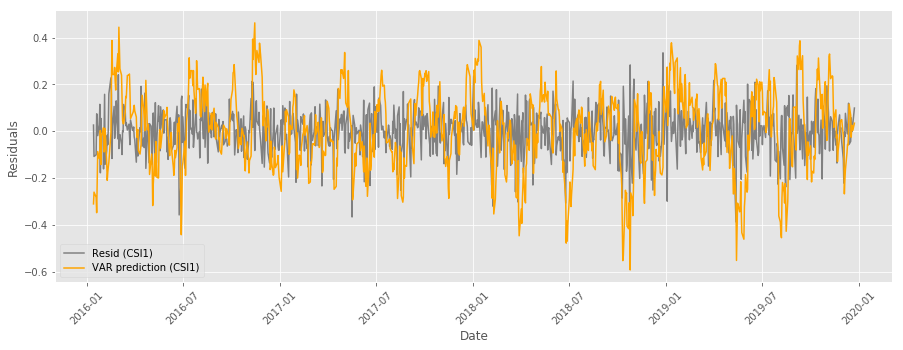

In [56]:
with plt.style.context(("ggplot")):
    y_fitted = res.fittedvalues
    plt.figure(figsize = (15,5))
    plt.plot(res.resid[["csi1"]], label='Resid (CSI1)', color="gray")
    plt.plot(y_fitted["csi1"], label='VAR prediction (CSI1)', color="orange")
    plt.xlabel('Date')
    plt.xticks(rotation=45)
    plt.ylabel('Residuals')
    plt.grid(True)
    plt.legend()

#### CSI2

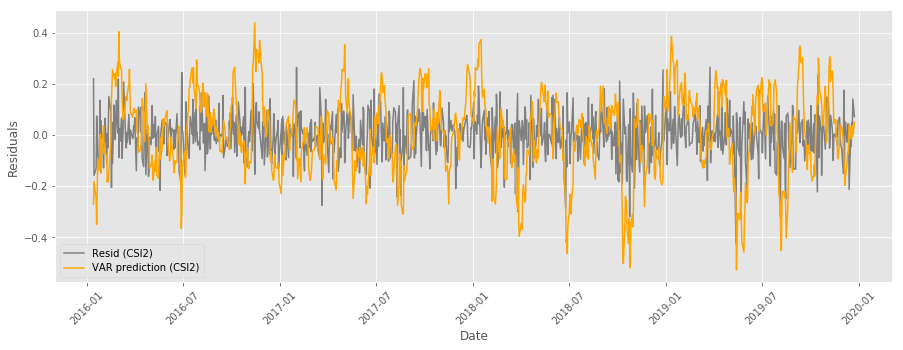

In [57]:
with plt.style.context(("ggplot")):
    y_fitted = res.fittedvalues
    plt.figure(figsize = (15,5))
    plt.plot(res.resid[["csi2"]], label='Resid (CSI2)', color="gray")
    plt.plot(y_fitted["csi2"], label='VAR prediction (CSI2)', color="orange")
    plt.xlabel('Date')
    plt.xticks(rotation=45)
    plt.ylabel('Residuals')
    plt.grid(True)
    plt.legend()

### Durbin Watson Test

In [58]:
out = durbin_watson(res.resid)
out.shape

(47,)

In [59]:
for col, val in zip(final_cols, out):
    print(col , " : ", val)

csi1  :  1.9980108677758301
csi2  :  2.1212537775093065
AAPL  :  2.005930163831181
ADM  :  1.9860349721067605
AIZ  :  1.9916509843809793
AJG  :  2.0128939391891145
ALB  :  1.9918021996116806
AMD  :  2.001125871172347
AME  :  2.038012102111208
AMT  :  2.015004892291334
AMZN  :  2.0026517744021897
AVY  :  2.0172446784040754
BIIB  :  1.982240138441298
BKNG  :  1.9711442360580715
BWA  :  2.0411467681066906
CAT  :  1.9982983815691377
CDNS  :  1.9961965351421536
CF  :  1.9857852050855702
CHRW  :  2.008585822975007
CINF  :  2.037605708459076
CL  :  1.967154514152075
CLX  :  1.99533279968515
CME  :  1.9833856791289914
CMI  :  1.9863060664473444
CNC  :  2.0132483948751947
CNP  :  1.990649624957484
COF  :  1.9861123756387
CSCO  :  2.0119926682712563
DGX  :  1.9888728095924806
DISH  :  2.0096173025586275
DLR  :  1.9886396700852706
DPZ  :  1.999452116499095
DVA  :  1.9921738507612692
DXC  :  1.9764804826723732
EBAY  :  2.009694922567498
ECL  :  1.9848825255118214
EMN  :  2.0026083588560915
EMR  : 

### Future Prediction

In [88]:
lag_order = res.k_ar

print("Lag samples to use for future predictions : ", lag_order)
# Input data for forecasting
input_data = X_train_transformed.values[-lag_order:]
#print(input_data)
# forecasting
pred = res.forecast(y=input_data, steps=n_obs)
pred = (pd.DataFrame(pred, index=X_test.index, columns=X_test.columns + '_pred'))
pred

Lag samples to use for future predictions :  1


,csi1_pred,csi2_pred,AAPL_pred,ADM_pred,AIZ_pred,AJG_pred,ALB_pred,AMD_pred,AME_pred,AMT_pred,AMZN_pred,AVY_pred,BIIB_pred,BKNG_pred,BWA_pred,CAT_pred,CDNS_pred,CF_pred,CHRW_pred,CINF_pred,CL_pred,CLX_pred,CME_pred,CMI_pred,CNC_pred,CNP_pred,COF_pred,CSCO_pred,DGX_pred,DISH_pred,DLR_pred,DPZ_pred,DVA_pred,DXC_pred,EBAY_pred,ECL_pred,EMN_pred,EMR_pred,EOG_pred,EQIX_pred,ETN_pred,EW_pred,FCX_pred,FDX_pred,GIS_pred,GOOG_pred,GOOGL_pred,GRMN_pred,GWW_pred,HD_pred,HOLX_pred,INTU_pred,IP_pred,IPG_pred,IT_pred,ITW_pred,J_pred,JBHT_pred,JKHY_pred,JNJ_pred,KO_pred,KSS_pred,LHX_pred,LKQ_pred,LNC_pred,LRCX_pred,LVS_pred,MAS_pred,MCD_pred,MHK_pred,MMM_pred,MSFT_pred,MTD_pred,MXIM_pred,MYL_pred,NBL_pred,NDAQ_pred,NUE_pred,PCAR_pred,PH_pred,PHM_pred,PKG_pred,PPG_pred,PPL_pred,PVH_pred,PWR_pred,PXD_pred,RE_pred,RL_pred,ROK_pred,SEE_pred,SHW_pred,SNA_pred,SNPS_pred,SWK_pred,SYK_pred,SYY_pred,TIF_pred,TSN_pred,TXN_pred
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-12-20,0.009519,0.010074,-0.000090,0.000562,-0.001795,0.000318,0.000138,-0.000240,0.000516,-0.000320,-0.003451,-0.000597,-0.001592,-0.003742,-0.000024,-1.699808e-03,0.000248,0.001443,-0.001562,0.000925,-0.000035,-0.000272,-0.000217,0.002146,-0.000530,0.000021,0.001759,0.000040,0.001666,0.000615,-0.000070,0.001281,0.000713,0.001329,-0.000240,-0.000425,-0.000402,0.000087,-0.001465,-0.005358,8.580623e-04,0.000412,0.000395,0.000948,0.000213,-0.011587,-0.014724,-0.000368,0.002698,-0.000029,0.000773,0.000456,0.000053,0.000377,0.001507,0.001590,0.000976,0.001341,0.000530,-0.000467,0.000415,0.000002,0.000823,-0.000300,0.000467,0.002010,0.001237,0.000224,0.000543,0.004432,-0.001806,-0.000724,-0.000741,0.000821,0.001123,-0.000114,-0.000927,0.000691,0.000691,0.000871,-0.000054,0.000144,0.000038,-0.000142,0.000977,0.000797,-0.001474,0.005972,-0.000693,0.001713,0.000046,0.001957,-0.000349,0.000709,0.002114,-0.001197,-0.000446,0.000022,0.000380,0.001103
2019-12-23,0.017161,0.011133,0.000923,-0.000280,0.000059,-0.000190,-0.000167,0.000158,0.000036,-0.000504,0.000025,-0.000255,-0.001872,-0.000745,0.000213,6.975114e-04,0.000011,0.000189,-0.000194,-0.000094,-0.000087,-0.000434,0.000305,0.000297,0.000214,-0.000065,0.000131,0.000130,-0.000189,0.000229,-0.000700,0.000569,0.000077,-0.000045,0.000029,-0.000156,0.000270,0.000404,-0.000177,-0.000920,-1.798819e-05,0.000145,0.000163,0.000299,-0.000079,0.002095,0.002244,0.000072,0.000568,0.000450,-0.000101,0.000243,0.000135,0.000093,-0.000002,0.000197,0.000060,-0.000298,-0.000044,-0.000230,-0.000100,-0.000015,0.000309,0.000137,0.000100,-0.000173,0.000209,0.000123,-0.000343,0.000219,0.000260,0.000144,0.002466,0.000048,-0.000169,-0.000144,0.000131,-0.000105,0.000322,0.000675,-0.000060,-0.000013,0.000042,-0.000075,-0.000057,-0.000125,0.000518,-0.000363,0.000722,0.000518,-0.000147,0.000694,0.000218,0.000071,-0.000087,-0.000034,-0.000037,0.000083,-0.000092,0.000336
2019-12-24,0.016778,0.012612,0.000350,-0.000025,0.000035,0.000062,0.000097,0.000070,0.000081,0.000104,0.002866,0.000099,0.000010,0.001891,-0.000038,-1.171967e-05,0.000062,-0.000087,-0.000149,-0.000011,-0.000115,-0.000038,0.000027,0.000068,0.000049,-0.000015,-0.000006,-0.000057,-0.000121,-0.000027,-0.000097,0.000371,-0.000099,-0.000039,0.000033,0.000079,-0.000012,-0.000079,-0.000065,0.000450,1.271506e-05,0.000092,-0.000114,-0.000003,-0.000103,0.000808,0.000753,0.000047,0.000045,0.000204,0.000022,0.000328,-0.000039,0.000010,0.000083,0.000010,-0.000011,0.000028,0.000119,-0.000124,-0.000062,-0.000086,0.000023,0.000005,0.000039,0.000273,0.000054,0.000005,0.000039,0.000051,-0.000085,0.000078,0.000423,-0.000036,-0.000028,-0.000181,0.000075,-0.000042,-0.000102,-0.000080,0.000002,0.000063,0.000053,-0.000070,0.000035,-0.000020,0.000042,0.000007,-0.000158,-0.000065,0.000013,0.000519,0.000231,0.000072,0.000146,0.000060,0.000006,0.000031,0.000068,0.000040
2019-12-26,0.014182,0.012976,0.000235,-0.000056,0.000050,0.000038,-0.000089,0.000013,0.000058,0.000085

### Inverting Predictions to Get Original Predictions

In [89]:
output = invert_transformation(X_train, pred)

### Checking Model Performance

#### CSI1

In [90]:
#combining predicted and real data set
combine_csi1_y = pd.concat([output['csi1_pred'], X_test['csi1']], axis=1)
combine_csi1_y['accuracy'] = round(combine_csi1_y.apply(lambda row: row.csi1_pred /row.csi1 *100, axis = 1),2)
combine_csi1_y['accuracy'] = pd.Series(["{0:.2f}%".format(val) for val in combine_csi1_y['accuracy']],index = combine_csi1_y.index)
combine_csi1_y = combine_csi1_y.round(decimals=2)
combine_csi1_y = combine_csi1_y.reset_index()
combine_csi1_y = combine_csi1_y.sort_values(by='date', ascending=False)
combine_csi1_y

,date,csi1_pred,csi1,accuracy
6,2019-12-31,1.26,1.86,68.00%
5,2019-12-30,1.25,1.79,69.92%
4,2019-12-27,1.24,1.73,72.09%
3,2019-12-26,1.23,1.61,76.30%
2,2019-12-24,1.22,1.44,84.68%
1,2019-12-23,1.20,1.34,89.50%
0,2019-12-20,1.18,1.21,97.94%


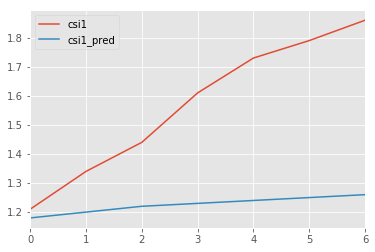

In [91]:
with plt.style.context("ggplot"):
    combine_csi1_y.plot(y=["csi1", "csi1_pred"])

In [92]:
#Forecast bias for CSI1
forecast_errors = [combine_csi1_y['csi1'][i]- combine_csi1_y['csi1_pred'][i] for i in range(len(combine_csi1_y['csi1']))]
bias = sum(forecast_errors) * 1.0/len(combine_csi1_y['csi1'])
print('Bias: %f' % bias)
print('Mean absolute error:', mean_absolute_error(combine_csi1_y['csi1'].values, combine_csi1_y['csi1_pred'].values))
print('Mean squared error:', mean_squared_error(combine_csi1_y['csi1'].values, combine_csi1_y['csi1_pred'].values))
print('Root mean squared error:', np.sqrt(mean_squared_error(combine_csi1_y['csi1'].values, combine_csi1_y['csi1_pred'].values)))

Bias: 0.342857
Mean absolute error: 0.3428571428571429
Mean squared error: 0.1578571428571429
Root mean squared error: 0.3973123995763823


#### CSI2

In [93]:
#combining predicted and real data set
combine_csi2_y = pd.concat([output['csi2_pred'], X_test['csi2']], axis=1)
combine_csi2_y['accuracy'] = round(combine_csi2_y.apply(lambda row: row.csi2_pred /row.csi2 *100, axis = 1),2)
combine_csi2_y['accuracy'] = pd.Series(["{0:.2f}%".format(val) for val in combine_csi2_y['accuracy']],index = combine_csi2_y.index)
combine_csi2_y = combine_csi2_y.round(decimals=2)
combine_csi2_y = combine_csi2_y.reset_index()
combine_csi2_y = combine_csi2_y.sort_values(by='date', ascending=False)
combine_csi2_y

,date,csi2_pred,csi2,accuracy
6,2019-12-31,0.97,1.65,58.98%
5,2019-12-30,0.96,1.56,61.56%
4,2019-12-27,0.95,1.48,64.35%
3,2019-12-26,0.94,1.37,68.35%
2,2019-12-24,0.93,1.22,75.87%
1,2019-12-23,0.91,1.15,79.64%
0,2019-12-20,0.90,1.03,87.92%


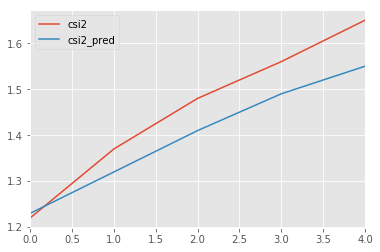

In [66]:
with plt.style.context("ggplot"):
    combine_csi2_y.plot(y=["csi2", "csi2_pred"])

In [67]:
#Forecast bias for CSI2
forecast_errors = [combine_csi2_y['csi2'][i]- combine_csi2_y['csi2_pred'][i] for i in range(len(combine_csi2_y['csi2']))]
bias = sum(forecast_errors) * 1.0/len(combine_csi2_y['csi2'])
print('Bias: %f' % bias)
print('Mean absolute error:', mean_absolute_error(combine_csi2_y['csi2'].values, combine_csi2_y['csi2_pred'].values))
print('Mean squared error:', mean_squared_error(combine_csi2_y['csi2'].values, combine_csi2_y['csi2_pred'].values))
print('Root mean squared error:', np.sqrt(mean_squared_error(combine_csi2_y['csi2'].values, combine_csi2_y['csi2_pred'].values)))

Bias: 0.056000
Mean absolute error: 0.06000000000000001
Mean squared error: 0.00448
Root mean squared error: 0.06693280212272604


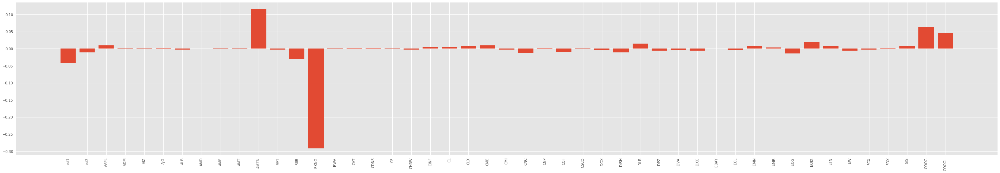

In [68]:
with plt.style.context(('seaborn','ggplot')):
    plt.figure(figsize=(50,8))
    plt.bar(x=X_train_transformed.columns, height=res.coefs.mean(axis=2).flatten(), width=0.8)
    plt.xticks(rotation='vertical')
    plt.savefig("weights_var_21.png", dpi=200)

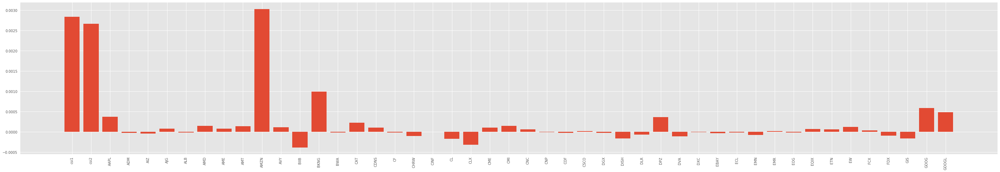

In [69]:
with plt.style.context(('seaborn','ggplot')):
    plt.figure(figsize=(50,8))
    plt.bar(x=X_train_transformed.columns, height=res.coefs_exog.flatten(), width=0.8)
    plt.xticks(rotation='vertical')
    plt.savefig("weights_var_12.png", dpi=200)

## Dense Net

### Method 1 : Full Data

In [70]:
def create_dataset(df, future_pred_cnt):

    X = df.drop(columns=["csi1", "csi2"]).values[:-future_pre_cnt]
    Y = df["csi1"].values[future_pre_cnt:]

    print("Dataset Size : ", X.shape, Y.shape)

    X_train, X_test = X[:-future_pre_cnt], X[-future_pre_cnt:]
    Y_train, Y_test = Y[:-future_pre_cnt], Y[-future_pre_cnt:]

    print("Train/Test Sizes : ", X_train.shape, X_test.shape, Y_train.shape, Y_test.shape)
    
    return X_train, X_test, Y_train, Y_test

In [71]:
future_pre_cnt = 5

X_train, X_test, Y_train, Y_test = create_dataset(df_subset, future_pre_cnt)

Dataset Size :  (995, 401) (995,)
Train/Test Sizes :  (990, 401) (5, 401) (990,) (5,)


In [72]:
dense_model1 = Sequential([ 
                     #Dense(128, activation='relu', input_shape=(X_train.shape[1],)),
                     Dense(15,  activation='relu', input_shape=(X_train.shape[1],)),
                     Dense(15,  activation='relu'),
                     Dense(1)])

print(dense_model1.summary())
#plot_model(dense_model1, to_file=os.path.join(batch, 'dense1.png'), show_shapes=True)
#Image.open(os.path.join(batch, 'dense1.png'))

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 15)                6030      
_________________________________________________________________
dense_2 (Dense)              (None, 15)                240       
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 16        
Total params: 6,286
Trainable params: 6,286
Non-trainable params: 0
_________________________________________________________________
None


In [73]:
dense_model1.compile(optimizer="adam", loss="mse", metrics=["mae"])

In [74]:
history = dense_model1.fit(X_train, Y_train, 
                           batch_size=1, epochs=5, verbose=1, validation_data=(X_test, Y_test), shuffle=False, use_multiprocessing=True);

Train on 990 samples, validate on 5 samples
Epoch 1/5
990/990 [==============================] - 1s 1ms/step - loss: 12.1767 - mae: 2.8440 - val_loss: 0.7054 - val_mae: 0.8267
Epoch 2/5
990/990 [==============================] - 2s 2ms/step - loss: 11.1158 - mae: 2.6489 - val_loss: 0.1403 - val_mae: 0.3440
Epoch 3/5
990/990 [==============================] - 1s 684us/step - loss: 10.7807 - mae: 2.5915 - val_loss: 0.0419 - val_mae: 0.1841
Epoch 4/5
990/990 [==============================] - 1s 759us/step - loss: 10.7134 - mae: 2.5774 - val_loss: 0.0260 - val_mae: 0.1407
Epoch 5/5
990/990 [==============================] - 1s 568us/step - loss: 10.6976 - mae: 2.5730 - val_loss: 0.0231 - val_mae: 0.1348


In [75]:
preds = dense_model1.predict(X_test).flatten()
preds = pd.DataFrame(preds, index=df_subset.index[-future_pre_cnt:], columns=["Preds"])
preds

,Preds
date,
2019-12-24,1.651622
2019-12-26,1.651622
2019-12-27,1.651622
2019-12-30,1.651622
2019-12-31,1.651622


In [76]:
def combine_results(preds, actual):
    combine_csi1 = pd.concat([preds, actuals], axis=1)
    combine_csi1['accuracy'] = round(combine_csi1.apply(lambda row: row.Preds /row.Actual *100, axis = 1),2)
    combine_csi1['accuracy'] = pd.Series(["{0:.2f}%".format(val) for val in combine_csi1['accuracy']],index = combine_csi1.index)
    combine_csi1 = combine_csi1.round(decimals=2)
    combine_csi1 = combine_csi1.reset_index()
    combine_csi1 = combine_csi1.sort_values(by='date', ascending=False)
    return combine_csi1

actuals = pd.DataFrame(Y_test, index=df_subset.index[-future_pre_cnt:], columns=["Actual"])
combine_csi1 = combine_results(preds, actuals)
combine_csi1

,date,Preds,Actual,accuracy
4,2019-12-31,1.65,1.86,88.89%
3,2019-12-30,1.65,1.79,92.05%
2,2019-12-27,1.65,1.73,95.70%
1,2019-12-26,1.65,1.61,102.31%
0,2019-12-24,1.65,1.44,114.86%


In [77]:
def calculate_errors(combine_csi1):
    forecast_errors = [combine_csi1['Actual'][i]- combine_csi1['Preds'][i] for i in range(combine_csi1.shape[0])]
    bias = sum(forecast_errors) * 1.0/len(combine_csi1['Actual'])
    print('Bias: %f' % bias)
    print('Mean absolute error:', mean_absolute_error(combine_csi1['Actual'].values, combine_csi1['Preds'].values))
    print('Mean squared error:', mean_squared_error(combine_csi1['Actual'].values, combine_csi1['Preds'].values))
    print('Root mean squared error:', np.sqrt(mean_squared_error(combine_csi1['Actual'].values, combine_csi1['Preds'].values)))
    
calculate_errors(combine_csi1)

Bias: 0.036000
Mean absolute error: 0.1360000047683716
Mean squared error: 0.02316000171661435
Root mean squared error: 0.15218410467790108


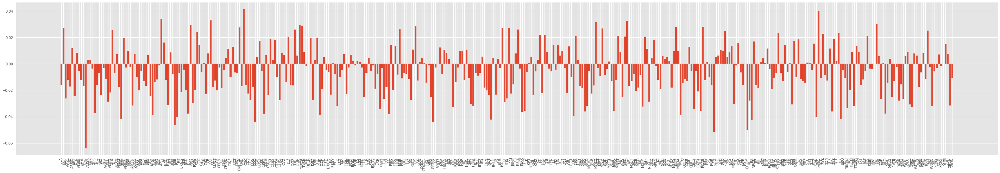

In [78]:
dense_weights = dense_model1.get_weights()
important_weights = dense_weights[0].mean(axis=1)

with plt.style.context(('seaborn','ggplot')):
    plt.figure(figsize=(50,8))
    plt.bar(x=df_subset.drop(columns=["csi1", "csi2"]).columns, height=important_weights, width=0.8)
    plt.xticks(rotation='vertical')
    plt.savefig("weights_dense_v1_1.png", dpi=200)

In [79]:
def plot_lime_viz(j, feature_cols, pred_func):
    explainer = lime.lime_tabular.LimeTabularExplainer(X_train, feature_names=feature_cols,
                                                       mode="regression",
                                                       training_labels=Y_train,
                                                       verbose=True,)

    exp_model = explainer.explain_instance(X_test[j], 
                                           pred_func, 
                                           num_features=X_train.shape[0])

    exp_model.show_in_notebook(show_table=True)

In [80]:
feature_cols =  df_subset.drop(columns=["csi1", "csi2"]).columns
j=0

plot_lime_viz(j, feature_cols, dense_model1.predict)

Intercept 1.6513042186592752
Prediction_local [1.65198262]
Right: 1.6516219


### Method 2 : CSI1_X Data

In [81]:
future_pre_cnt = 5

X_train, X_test, Y_train, Y_test = create_dataset(df_subset_csi_x, future_pre_cnt)

Dataset Size :  (995, 130) (995,)
Train/Test Sizes :  (990, 130) (5, 130) (990,) (5,)


In [82]:
dense_model1 = Sequential([ 
                     #Dense(128, activation='relu', input_shape=(X_train.shape[1],)),
                     Dense(10,  activation='relu', input_shape=(X_train.shape[1],)),
                     Dense(3,  activation='relu'),
                     Dense(1)])

print(dense_model1.summary())
#plot_model(dense_model1, to_file=os.path.join(batch, 'dense1.png'), show_shapes=True)
#Image.open(os.path.join(batch, 'dense1.png'))

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 10)                1310      
_________________________________________________________________
dense_5 (Dense)              (None, 3)                 33        
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 4         
Total params: 1,347
Trainable params: 1,347
Non-trainable params: 0
_________________________________________________________________
None


In [83]:
dense_model1.compile(optimizer="adam", loss="mse", metrics=["mae"])

In [84]:
history = dense_model1.fit(X_train, Y_train, 
                           batch_size=1, epochs=5, verbose=1, validation_data=(X_test, Y_test), shuffle=False, use_multiprocessing=True);

Train on 990 samples, validate on 5 samples
Epoch 1/5
990/990 [==============================] - 1s 571us/step - loss: 8.7276 - mae: 2.4469 - val_loss: 2.2872 - val_mae: 1.5051
Epoch 2/5
990/990 [==============================] - 0s 493us/step - loss: 12.5889 - mae: 2.8967 - val_loss: 1.2066 - val_mae: 1.0884
Epoch 3/5
990/990 [==============================] - 0s 486us/step - loss: 11.7379 - mae: 2.7676 - val_loss: 0.6482 - val_mae: 0.7914
Epoch 4/5
990/990 [==============================] - 0s 489us/step - loss: 11.2688 - mae: 2.6890 - val_loss: 0.3442 - val_mae: 0.5677
Epoch 5/5
990/990 [==============================] - 0s 481us/step - loss: 11.0034 - mae: 2.6435 - val_loss: 0.1808 - val_mae: 0.3986


In [85]:
preds = dense_model1.predict(X_test).flatten()
preds = pd.DataFrame(preds, index=df_subset.index[-future_pre_cnt:], columns=["Preds"])
preds

,Preds
date,
2019-12-24,1.287481
2019-12-26,1.287481
2019-12-27,1.287481
2019-12-30,1.287481
2019-12-31,1.287481


In [86]:
actuals = pd.DataFrame(Y_test, index=df_subset.index[-future_pre_cnt:], columns=["Actual"])
combine_csi1 = combine_results(preds, actuals)
combine_csi1

,date,Preds,Actual,accuracy
4,2019-12-31,1.29,1.86,69.29%
3,2019-12-30,1.29,1.79,71.76%
2,2019-12-27,1.29,1.73,74.60%
1,2019-12-26,1.29,1.61,79.75%
0,2019-12-24,1.29,1.44,89.54%


In [87]:
calculate_errors(combine_csi1)

Bias: 0.396000
Mean absolute error: 0.3960000381469727
Mean squared error: 0.17868003021240383
Root mean squared error: 0.42270560702740134


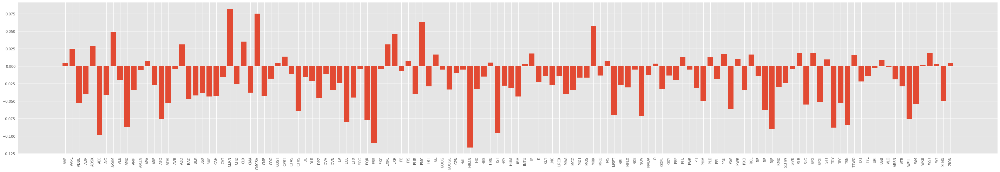

In [88]:
dense_weights = dense_model1.get_weights()
important_weights = dense_weights[0].mean(axis=1)

with plt.style.context(('seaborn','ggplot')):
    plt.figure(figsize=(50,8))
    plt.bar(x=df_subset_csi_x.drop(columns=["csi1", "csi2"]).columns, height=important_weights, width=0.8)
    plt.xticks(rotation='vertical')
    plt.savefig("weights_dense_v1_2.png", dpi=200)

In [89]:
feature_cols =  df_subset_csi_x.drop(columns=["csi1", "csi2"]).columns
j=0

plot_lime_viz(j, feature_cols, dense_model1.predict)

Intercept 1.2874732636722706
Prediction_local [1.28759621]
Right: 1.2874813


### Method 3 : CSI_Y Data

In [90]:
future_pre_cnt = 5

X_train, X_test, Y_train, Y_test = create_dataset(df_subset_csi_y, future_pre_cnt)

Dataset Size :  (995, 107) (995,)
Train/Test Sizes :  (990, 107) (5, 107) (990,) (5,)


In [91]:
dense_model1 = Sequential([ 
                     #Dense(128, activation='relu', input_shape=(X_train.shape[1],)),
                     Dense(10,  activation='relu', input_shape=(X_train.shape[1],)),
                     Dense(10,  activation='relu'),
                     Dense(1)])

print(dense_model1.summary())
#plot_model(dense_model1, to_file=os.path.join(batch, 'dense1.png'), show_shapes=True)
#Image.open(os.path.join(batch, 'dense1.png'))

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_7 (Dense)              (None, 10)                1080      
_________________________________________________________________
dense_8 (Dense)              (None, 10)                110       
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 11        
Total params: 1,201
Trainable params: 1,201
Non-trainable params: 0
_________________________________________________________________
None


In [92]:
dense_model1.compile(optimizer="adam", loss="mse", metrics=["mae"])

In [93]:
history = dense_model1.fit(X_train, Y_train, 
                           batch_size=1, epochs=10, verbose=0, validation_data=(X_test, Y_test), shuffle=False, use_multiprocessing=True);

In [94]:
preds = dense_model1.predict(X_test).flatten()
preds = pd.DataFrame(preds, index=df_subset.index[-future_pre_cnt:], columns=["Preds"])
preds

,Preds
date,
2019-12-24,1.636983
2019-12-26,1.636983
2019-12-27,1.636983
2019-12-30,1.636983
2019-12-31,1.636983


In [95]:
actuals = pd.DataFrame(Y_test, index=df_subset.index[-future_pre_cnt:], columns=["Actual"])
combine_csi1 = combine_results(preds, actuals)
combine_csi1

,date,Preds,Actual,accuracy
4,2019-12-31,1.64,1.86,88.10%
3,2019-12-30,1.64,1.79,91.24%
2,2019-12-27,1.64,1.73,94.85%
1,2019-12-26,1.64,1.61,101.40%
0,2019-12-24,1.64,1.44,113.84%


In [96]:
calculate_errors(combine_csi1)

Bias: 0.046000
Mean absolute error: 0.13800000286102296
Mean squared error: 0.023980001316070775
Root mean squared error: 0.1548547749217659


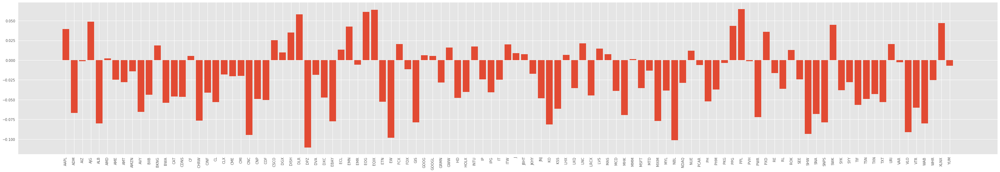

In [97]:
dense_weights = dense_model1.get_weights()
important_weights = dense_weights[0].mean(axis=1)

with plt.style.context(('seaborn','ggplot')):
    plt.figure(figsize=(50,8))
    plt.bar(x=df_subset_csi_y.drop(columns=["csi1", "csi2"]).columns, height=important_weights, width=0.8)
    plt.xticks(rotation='vertical')
    plt.savefig("weights_dense_v1_3.png", dpi=200)

In [98]:
feature_cols =  df_subset_csi_y.drop(columns=["csi1", "csi2"]).columns
j=0

plot_lime_viz(j, feature_cols, dense_model1.predict)

Intercept 1.6369820356384592
Prediction_local [1.63698685]
Right: 1.6369834


## XGBoost

### Method 1 : Full Data

In [99]:
future_pre_cnt = 5

X_train, X_test, Y_train, Y_test = create_dataset(df_subset, future_pre_cnt)

Dataset Size :  (995, 401) (995,)
Train/Test Sizes :  (990, 401) (5, 401) (990,) (5,)


In [100]:
xgb_reg = xgb.XGBRFRegressor(n_estimators=150, max_depth=5,  objective='reg:squarederror', verbosity=1)

In [101]:
xgb_reg.fit(X_train, Y_train)

XGBRFRegressor(base_score=0.5, colsample_bylevel=1, colsample_bynode=0.8,
               colsample_bytree=1, gamma=0, learning_rate=1, max_delta_step=0,
               max_depth=5, min_child_weight=1, missing=None, n_estimators=150,
               n_jobs=1, nthread=None, objective='reg:squarederror',
               random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
               seed=None, silent=None, subsample=0.8, verbosity=1)

In [102]:
preds = xgb_reg.predict(X_test), 
preds = pd.DataFrame(preds[0], index=df_subset.index[-future_pre_cnt:], columns=["Preds"])
preds

,Preds
date,
2019-12-24,1.499771
2019-12-26,1.476315
2019-12-27,1.487314
2019-12-30,1.352597
2019-12-31,1.438982


In [103]:
#combining predicted and real data set
actuals = pd.DataFrame(Y_test, index=df_subset.index[-future_pre_cnt:], columns=["Actual"])

combine_csi1 = combine_results(preds, actuals)
combine_csi1

,date,Preds,Actual,accuracy
4,2019-12-31,1.44,1.86,77.44%
3,2019-12-30,1.35,1.79,75.39%
2,2019-12-27,1.49,1.73,86.18%
1,2019-12-26,1.48,1.61,91.45%
0,2019-12-24,1.50,1.44,104.30%


In [104]:
calculate_errors(combine_csi1)

Bias: 0.234000
Mean absolute error: 0.2579999780654908
Mean squared error: 0.08961998428344815
Root mean squared error: 0.299365970483367


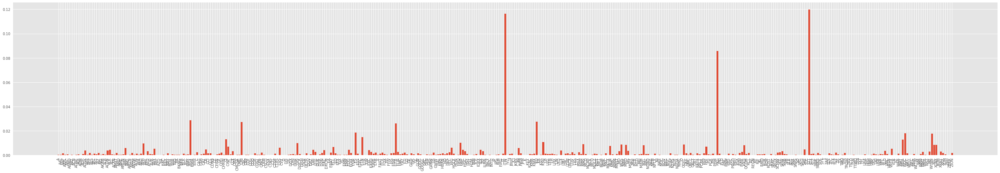

In [105]:
with plt.style.context(('seaborn','ggplot')):
    plt.figure(figsize=(50,8))
    plt.bar(x=df_subset.drop(columns=["csi1", "csi2"]).columns, height=xgb_reg.feature_importances_, width=0.8)
    plt.xticks(rotation='vertical')
    plt.savefig("weights_xgb_1.png", dpi=200)

In [106]:
feature_cols =  df_subset.drop(columns=["csi1", "csi2"]).columns
j=0

plot_lime_viz(j, feature_cols, xgb_reg.predict)

Intercept 1.7020801440642435
Prediction_local [1.72621385]
Right: 1.4997711


In [107]:
%%time

shap.initjs()

explainerXGB = shap.TreeExplainer(xgb_reg, feature_perturbation="tree_path_dependent")
shap_values_XGB_test = explainerXGB.shap_values(X_test, Y_test)

CPU times: user 158 ms, sys: 48 ms, total: 206 ms
Wall time: 240 ms


Setting feature_perturbation = "tree_path_dependent" because no background data was given.


In [108]:
j=0
feature_cols =  df_subset.drop(columns=["csi1", "csi2"]).columns

shap.force_plot(base_value=explainerXGB.expected_value, 
                shap_values=shap_values_XGB_test[j],
                features = X_test[j],
                feature_names=feature_cols)

In [109]:
shap.force_plot(explainerXGB.expected_value, shap_values_XGB_test, X_test, feature_names=feature_cols)

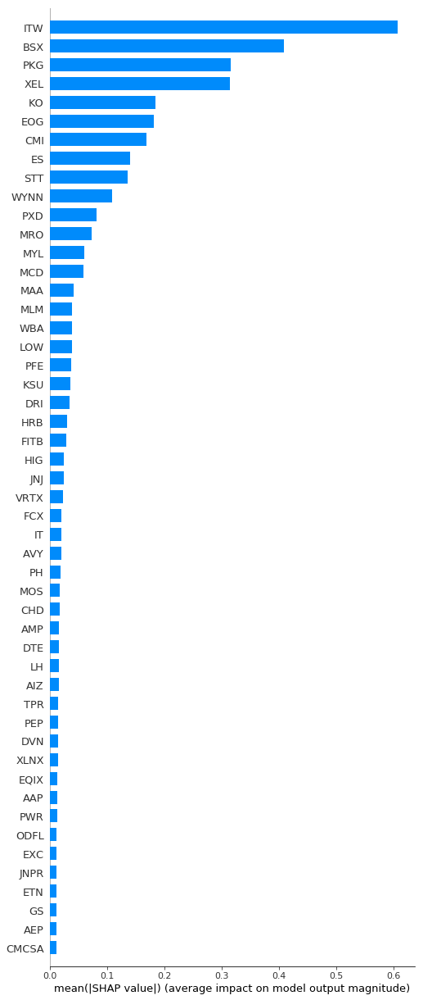

In [110]:
shap.summary_plot(shap_values_XGB_test, X_test, plot_type="bar", feature_names=feature_cols, max_display=50)

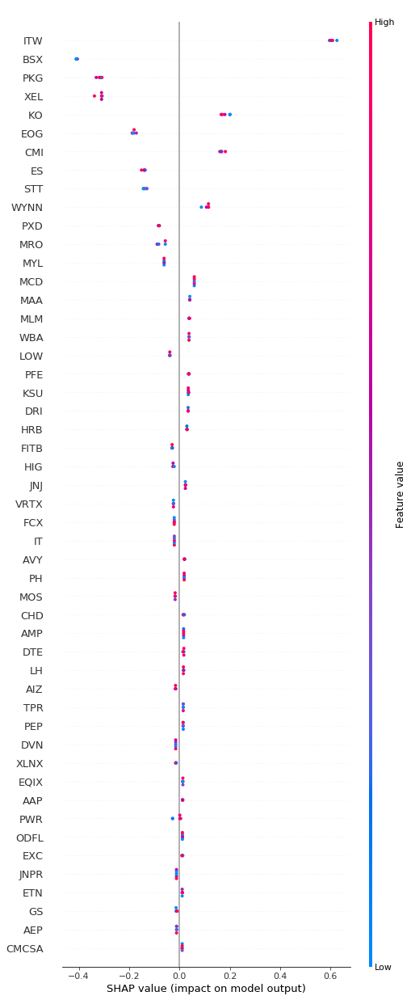

In [111]:
shap.summary_plot(shap_values_XGB_test, X_test, feature_names=feature_cols, max_display=50)

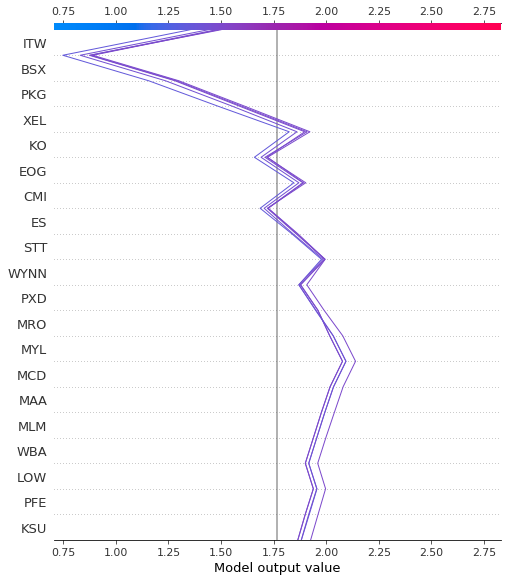

In [112]:
shap.decision_plot(explainerXGB.expected_value, shap_values_XGB_test, X_test, feature_names=feature_cols.tolist())

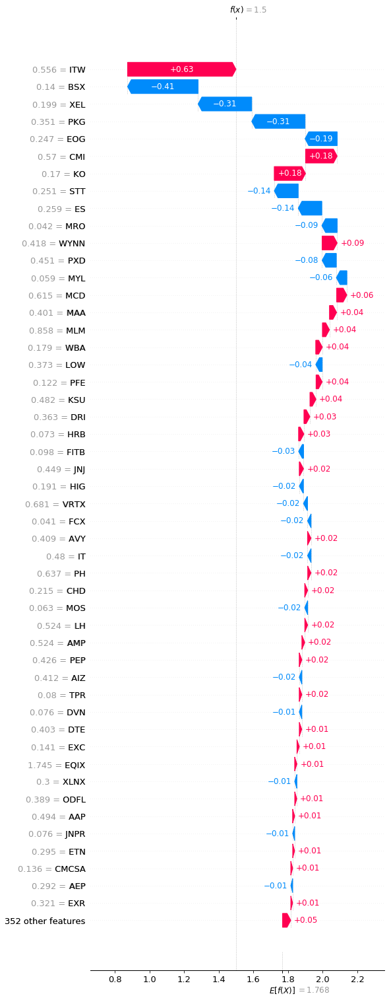

In [113]:
shap.waterfall_plot(explainerXGB.expected_value, shap_values_XGB_test[0], X_test[0], feature_names=feature_cols.tolist(), max_display=50)

### Method 2 : CSI1_X Data

In [114]:
future_pre_cnt = 5

X_train, X_test, Y_train, Y_test = create_dataset(df_subset_csi_x, future_pre_cnt)

Dataset Size :  (995, 130) (995,)
Train/Test Sizes :  (990, 130) (5, 130) (990,) (5,)


In [115]:
xgb_reg = xgb.XGBRFRegressor(n_estimators=150, max_depth=5,  objective='reg:squarederror', verbosity=1)

In [116]:
xgb_reg.fit(X_train, Y_train)

XGBRFRegressor(base_score=0.5, colsample_bylevel=1, colsample_bynode=0.8,
               colsample_bytree=1, gamma=0, learning_rate=1, max_delta_step=0,
               max_depth=5, min_child_weight=1, missing=None, n_estimators=150,
               n_jobs=1, nthread=None, objective='reg:squarederror',
               random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
               seed=None, silent=None, subsample=0.8, verbosity=1)

In [117]:
preds = xgb_reg.predict(X_test), 
preds = pd.DataFrame(preds[0], index=df_subset.index[-future_pre_cnt:], columns=["Preds"])
preds

,Preds
date,
2019-12-24,1.632525
2019-12-26,1.741335
2019-12-27,1.620016
2019-12-30,1.701115
2019-12-31,1.665338


In [118]:
combine_csi1 = combine_results(preds, actuals)
combine_csi1

,date,Preds,Actual,accuracy
4,2019-12-31,1.67,1.86,89.63%
3,2019-12-30,1.70,1.79,94.81%
2,2019-12-27,1.62,1.73,93.87%
1,2019-12-26,1.74,1.61,107.86%
0,2019-12-24,1.63,1.44,113.53%


In [119]:
calculate_errors(combine_csi1)

Bias: 0.014000
Mean absolute error: 0.1419999990463257
Mean squared error: 0.021860001468659303
Root mean squared error: 0.14785128159288746


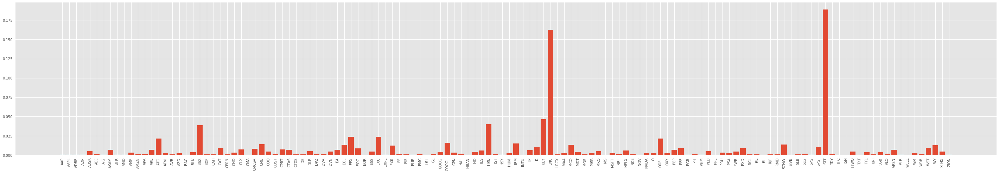

In [120]:
with plt.style.context(('seaborn','ggplot')):
    plt.figure(figsize=(50,8))
    plt.bar(x=df_subset_csi_x.drop(columns=["csi1", "csi2"]).columns, height=xgb_reg.feature_importances_, width=0.8)
    plt.xticks(rotation='vertical')
    plt.savefig("weights_xgb_2.png", dpi=200)

In [121]:
feature_cols =  df_subset_csi_x.drop(columns=["csi1", "csi2"]).columns
j=0

plot_lime_viz(j, feature_cols, xgb_reg.predict)

Intercept 1.952140656619373
Prediction_local [-0.88478841]
Right: 1.6325254


In [122]:
%%time

shap.initjs()

explainerXGB = shap.TreeExplainer(xgb_reg, feature_perturbation="tree_path_dependent")
shap_values_XGB_test = explainerXGB.shap_values(X_test, Y_test)

CPU times: user 202 ms, sys: 37.6 ms, total: 240 ms
Wall time: 137 ms


Setting feature_perturbation = "tree_path_dependent" because no background data was given.


In [123]:
j=0

feature_cols =  df_subset_csi_x.drop(columns=["csi1", "csi2"]).columns

shap.force_plot(base_value=explainerXGB.expected_value, 
                shap_values=shap_values_XGB_test[j],
                features = X_test[j],
                feature_names=feature_cols)

In [124]:
shap.force_plot(explainerXGB.expected_value, shap_values_XGB_test, X_test, feature_names=feature_cols)

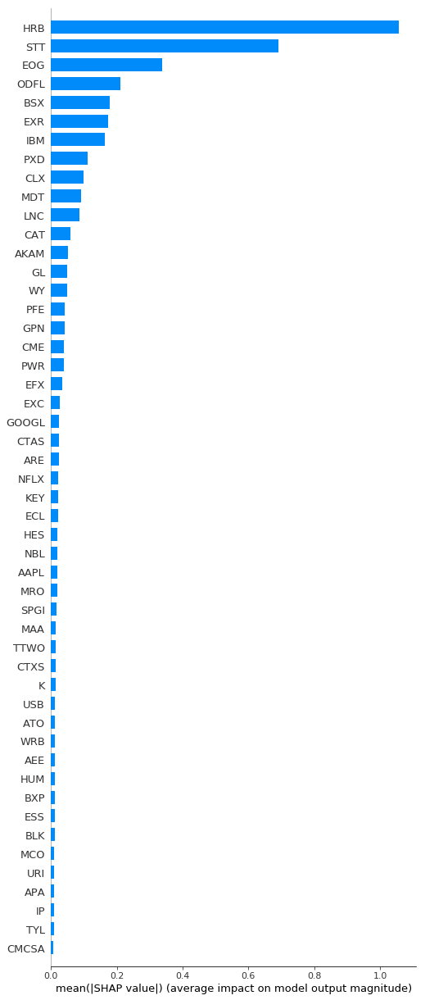

In [125]:
shap.summary_plot(shap_values_XGB_test, X_test, plot_type="bar", feature_names=feature_cols, max_display=50)

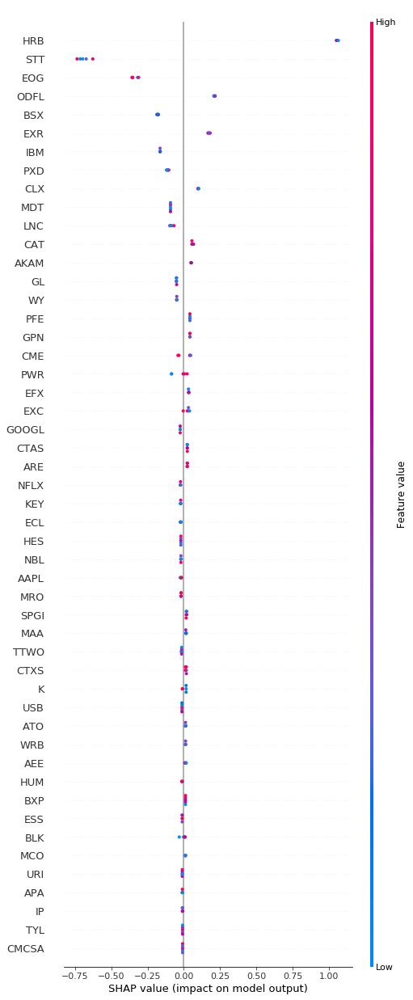

In [126]:
shap.summary_plot(shap_values_XGB_test, X_test, feature_names=feature_cols, max_display=50)

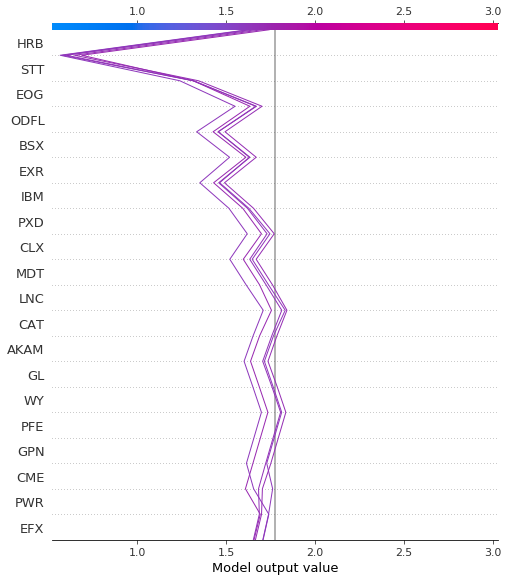

In [127]:
shap.decision_plot(explainerXGB.expected_value, shap_values_XGB_test, X_test, feature_names=feature_cols.tolist())

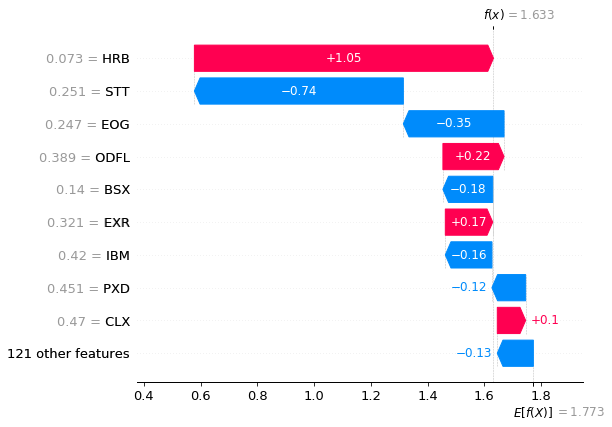

In [128]:
shap.waterfall_plot(explainerXGB.expected_value, shap_values_XGB_test[0], X_test[0], feature_names=feature_cols.tolist())

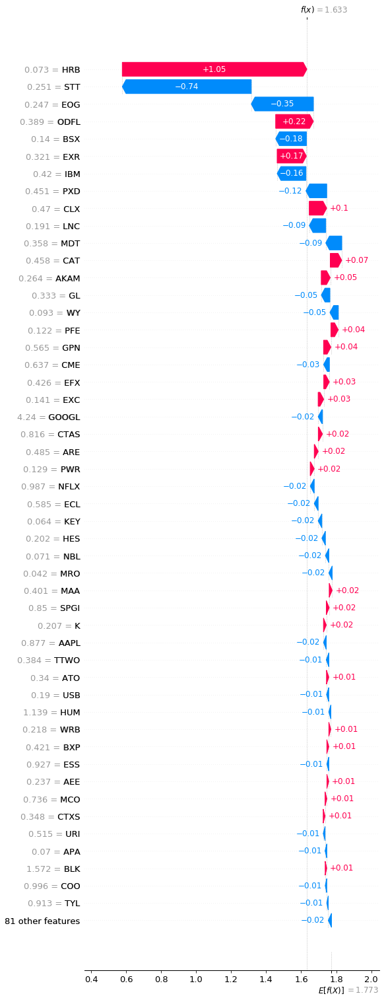

In [129]:
shap.waterfall_plot(explainerXGB.expected_value, shap_values_XGB_test[0], X_test[0], feature_names=feature_cols.tolist(), max_display=50)

### Method 3 : CSI1_Y Data

In [130]:
future_pre_cnt = 5

X_train, X_test, Y_train, Y_test = create_dataset(df_subset_csi_y, future_pre_cnt)

Dataset Size :  (995, 107) (995,)
Train/Test Sizes :  (990, 107) (5, 107) (990,) (5,)


In [131]:
xgb_reg = xgb.XGBRFRegressor(n_estimators=150, max_depth=5,  objective='reg:squarederror', verbosity=1)

In [132]:
xgb_reg.fit(X_train, Y_train)

XGBRFRegressor(base_score=0.5, colsample_bylevel=1, colsample_bynode=0.8,
               colsample_bytree=1, gamma=0, learning_rate=1, max_delta_step=0,
               max_depth=5, min_child_weight=1, missing=None, n_estimators=150,
               n_jobs=1, nthread=None, objective='reg:squarederror',
               random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
               seed=None, silent=None, subsample=0.8, verbosity=1)

In [133]:
preds = xgb_reg.predict(X_test), 
preds = pd.DataFrame(preds[0], index=df_subset.index[-future_pre_cnt:], columns=["Preds"])
preds

,Preds
date,
2019-12-24,1.339128
2019-12-26,1.445290
2019-12-27,1.397194
2019-12-30,1.168794
2019-12-31,1.229756


In [134]:
combine_csi1 = combine_results(preds, actuals)
combine_csi1

,date,Preds,Actual,accuracy
4,2019-12-31,1.23,1.86,66.18%
3,2019-12-30,1.17,1.79,65.14%
2,2019-12-27,1.40,1.73,80.96%
1,2019-12-26,1.45,1.61,89.53%
0,2019-12-24,1.34,1.44,93.13%


In [135]:
calculate_errors(combine_csi1)

Bias: 0.368000
Mean absolute error: 0.3679999933242798
Mean squared error: 0.1851600045967115
Root mean squared error: 0.43030222471736246


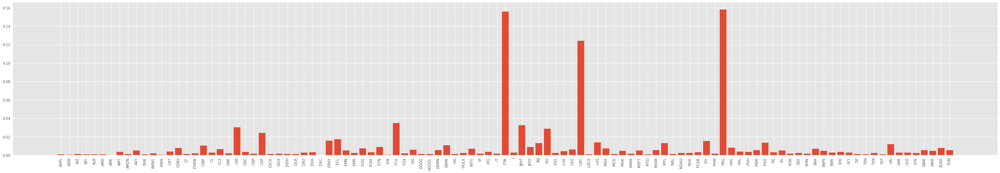

In [136]:
with plt.style.context(('seaborn','ggplot')):
    plt.figure(figsize=(50,8))
    plt.bar(x=df_subset_csi_y.drop(columns=["csi1", "csi2"]).columns, height=xgb_reg.feature_importances_, width=0.8)
    plt.xticks(rotation='vertical')
    plt.savefig("weights_xgb_3.png", dpi=200)

In [137]:
feature_cols =  df_subset_csi_y.drop(columns=["csi1", "csi2"]).columns
j=0

plot_lime_viz(j, feature_cols, xgb_reg.predict)

Intercept 1.5957779500899616
Prediction_local [1.36063583]
Right: 1.3391277


In [138]:
%%time

shap.initjs()

explainerXGB = shap.TreeExplainer(xgb_reg, feature_perturbation="tree_path_dependent")
shap_values_XGB_test = explainerXGB.shap_values(X_test, Y_test)

CPU times: user 165 ms, sys: 23.7 ms, total: 189 ms
Wall time: 126 ms


Setting feature_perturbation = "tree_path_dependent" because no background data was given.


In [139]:
j=0
feature_cols =  df_subset_csi_y.drop(columns=["csi1", "csi2"]).columns

shap.force_plot(base_value=explainerXGB.expected_value, 
                shap_values=shap_values_XGB_test[j],
                features = X_test[j],
                feature_names=feature_cols)

In [140]:
shap.force_plot(explainerXGB.expected_value, shap_values_XGB_test, X_test, feature_names=feature_cols)

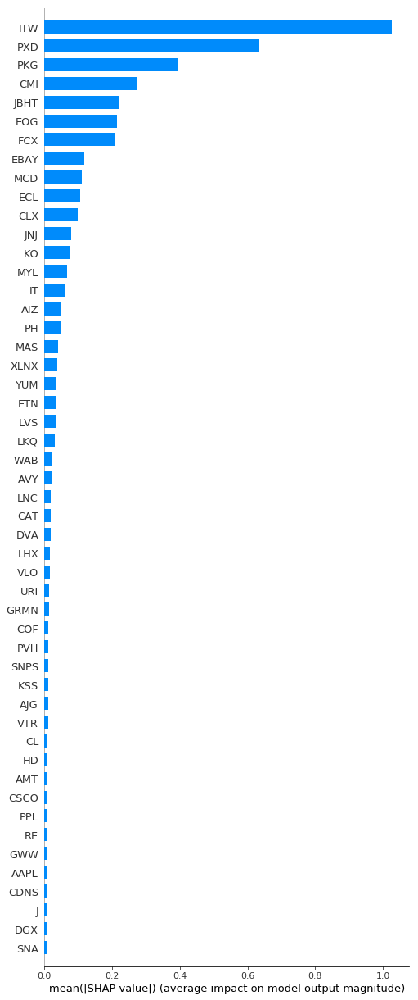

In [141]:
shap.summary_plot(shap_values_XGB_test, X_test, plot_type="bar", feature_names=feature_cols, max_display=50)

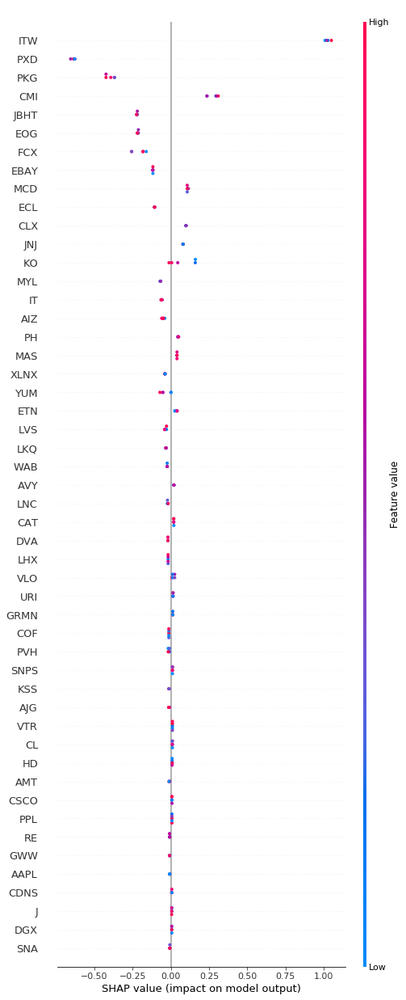

In [142]:
shap.summary_plot(shap_values_XGB_test, X_test, feature_names=feature_cols, max_display=50)

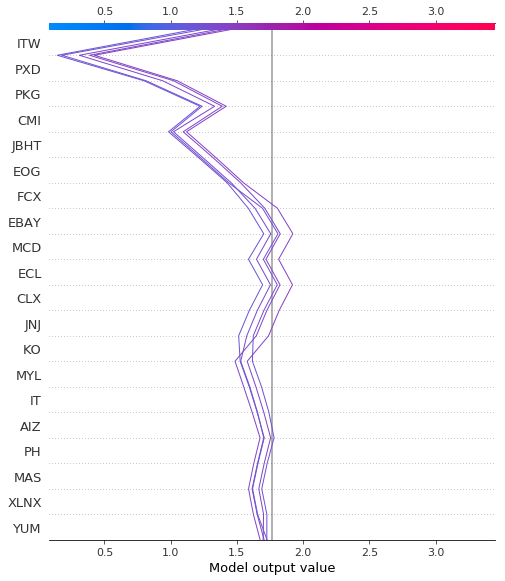

In [143]:
shap.decision_plot(explainerXGB.expected_value, shap_values_XGB_test, X_test, feature_names=feature_cols.tolist())

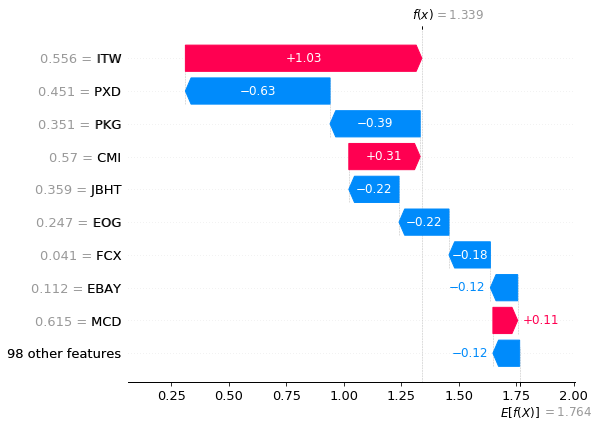

In [144]:
shap.waterfall_plot(explainerXGB.expected_value, shap_values_XGB_test[0], X_test[0], feature_names=feature_cols.tolist())

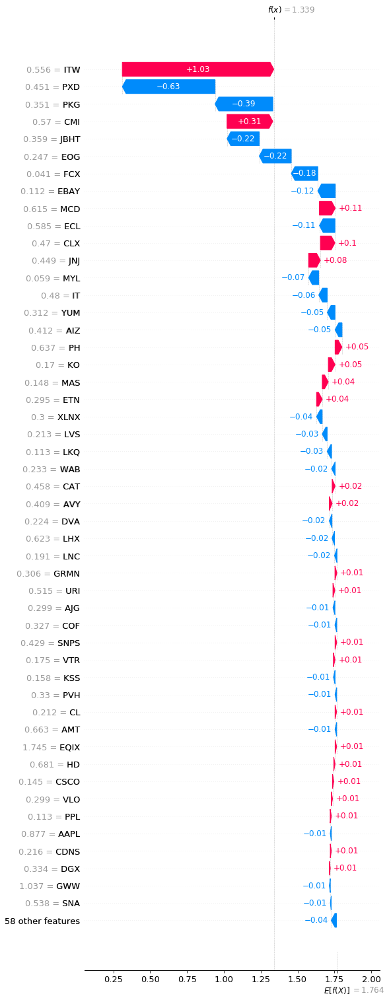

In [145]:
shap.waterfall_plot(explainerXGB.expected_value, shap_values_XGB_test[0], X_test[0], feature_names=feature_cols.tolist(), max_display=50)

## RandomForest

### Method 1 : Full Data

In [146]:
future_pre_cnt = 5

X_train, X_test, Y_train, Y_test = create_dataset(df_subset, future_pre_cnt)

Dataset Size :  (995, 401) (995,)
Train/Test Sizes :  (990, 401) (5, 401) (990,) (5,)


In [147]:
rf = RandomForestRegressor(n_estimators=150, max_depth=5)

In [148]:
rf.fit(X_train, Y_train)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=5,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=150,
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)

In [149]:
preds = rf.predict(X_test), 
preds = pd.DataFrame(preds[0], index=df_subset.index[-future_pre_cnt:], columns=["Preds"])
preds

,Preds
date,
2019-12-24,1.502525
2019-12-26,1.479715
2019-12-27,1.511259
2019-12-30,1.357354
2019-12-31,1.484145


In [150]:
combine_csi1 = combine_results(preds, actuals)
combine_csi1

,date,Preds,Actual,accuracy
4,2019-12-31,1.48,1.86,79.87%
3,2019-12-30,1.36,1.79,75.65%
2,2019-12-27,1.51,1.73,87.57%
1,2019-12-26,1.48,1.61,91.66%
0,2019-12-24,1.50,1.44,104.49%


In [151]:
calculate_errors(combine_csi1)

Bias: 0.220000
Mean absolute error: 0.24400000000000005
Mean squared error: 0.07964000000000002
Root mean squared error: 0.28220559881051266


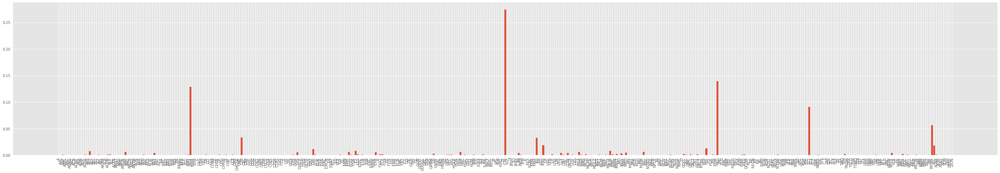

In [152]:
with plt.style.context(('seaborn','ggplot')):
    plt.figure(figsize=(50,8))
    plt.bar(x=df_subset.drop(columns=["csi1", "csi2"]).columns, height=rf.feature_importances_, width=0.8)
    plt.xticks(rotation='vertical')
    plt.savefig("weights_rf_1.png", dpi=200)

In [153]:
feature_cols =  df_subset.drop(columns=["csi1", "csi2"]).columns
j=0

plot_lime_viz(j, feature_cols, rf.predict)

Intercept 1.5537663786756148
Prediction_local [2.61739892]
Right: 1.5025245724648364


In [154]:
%%time

shap.initjs()

explainer = shap.TreeExplainer(rf, feature_perturbation="tree_path_dependent")
shap_values_test = explainer.shap_values(X_test, Y_test)

CPU times: user 39.8 ms, sys: 39.4 ms, total: 79.2 ms
Wall time: 22.1 ms


Setting feature_perturbation = "tree_path_dependent" because no background data was given.


In [155]:
j=0
feature_cols =  df_subset.drop(columns=["csi1", "csi2"]).columns

shap.force_plot(base_value=explainer.expected_value, 
                shap_values=shap_values_test[j],
                features = X_test[j],
                feature_names=feature_cols)

In [156]:
shap.force_plot(explainer.expected_value, shap_values_test, X_test, feature_names=feature_cols)

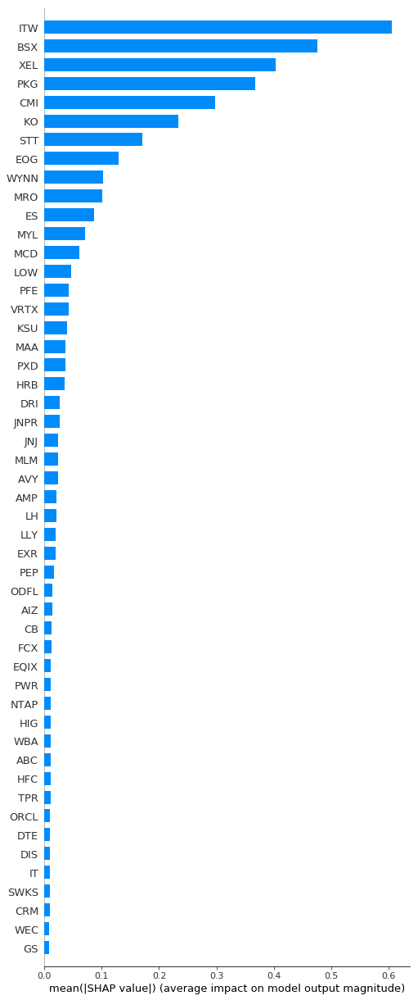

In [157]:
shap.summary_plot(shap_values_test, X_test, plot_type="bar", feature_names=feature_cols, max_display=50)

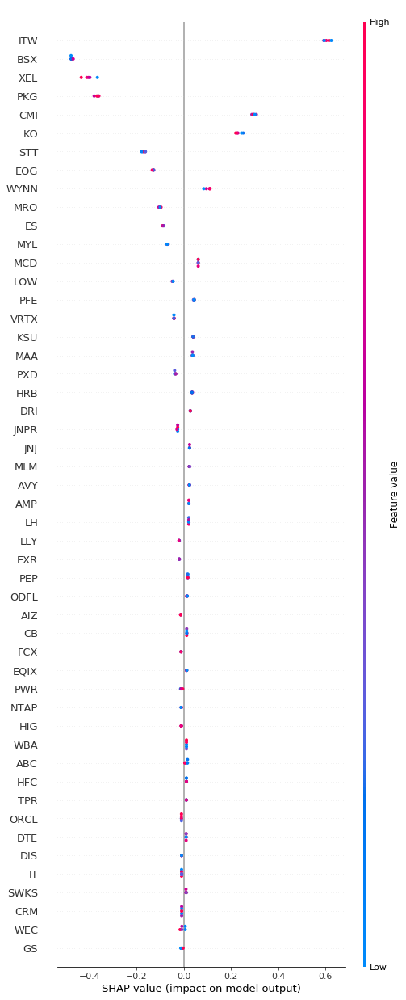

In [158]:
shap.summary_plot(shap_values_test, X_test, feature_names=feature_cols, max_display=50)

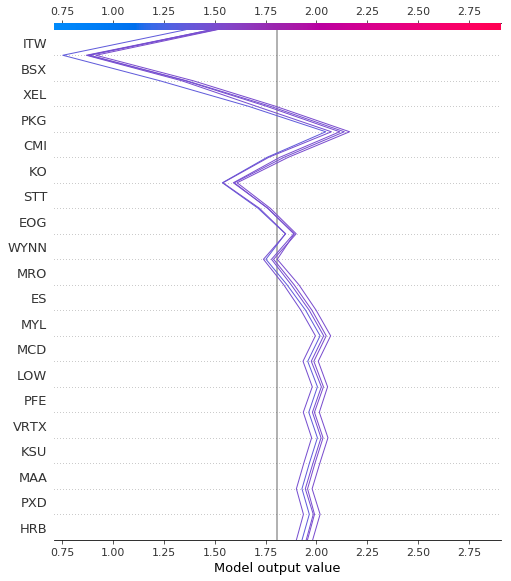

In [159]:
shap.decision_plot(explainer.expected_value, shap_values_test, X_test, feature_names=feature_cols.tolist())

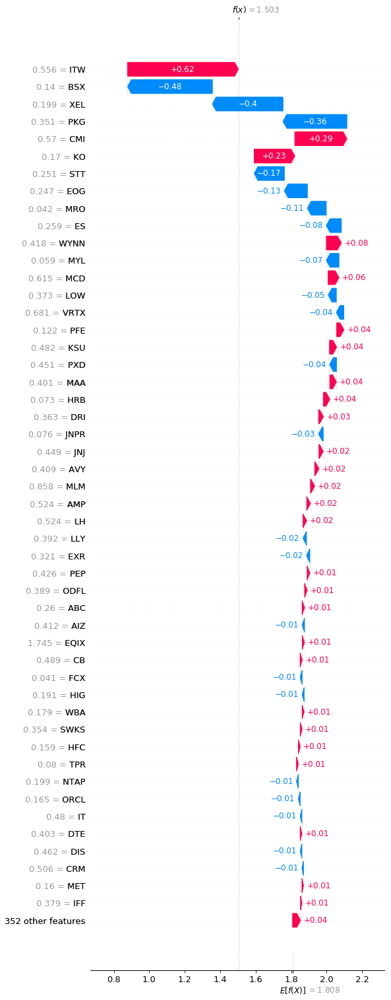

In [160]:
shap.waterfall_plot(explainer.expected_value[j], shap_values_test[0], X_test[0], feature_names=feature_cols.tolist(), max_display=50)

### Method 2 : CSI1_X Data

In [161]:
future_pre_cnt = 5

X_train, X_test, Y_train, Y_test = create_dataset(df_subset_csi_x, future_pre_cnt)

Dataset Size :  (995, 130) (995,)
Train/Test Sizes :  (990, 130) (5, 130) (990,) (5,)


In [162]:
rf = RandomForestRegressor(n_estimators=100, max_depth=5)

In [163]:
rf.fit(X_train, Y_train)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=5,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=100,
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)

In [164]:
preds = rf.predict(X_test), 
preds = pd.DataFrame(preds[0], index=df_subset.index[-future_pre_cnt:], columns=["Preds"])
preds

,Preds
date,
2019-12-24,1.592517
2019-12-26,1.592517
2019-12-27,1.592517
2019-12-30,1.592517
2019-12-31,1.599962


In [165]:
combine_csi1 = combine_results(preds, actuals)
combine_csi1

,date,Preds,Actual,accuracy
4,2019-12-31,1.60,1.86,86.11%
3,2019-12-30,1.59,1.79,88.76%
2,2019-12-27,1.59,1.73,92.28%
1,2019-12-26,1.59,1.61,98.65%
0,2019-12-24,1.59,1.44,110.75%


In [166]:
calculate_errors(combine_csi1)

Bias: 0.094000
Mean absolute error: 0.154
Mean squared error: 0.03002
Root mean squared error: 0.17326280616450837


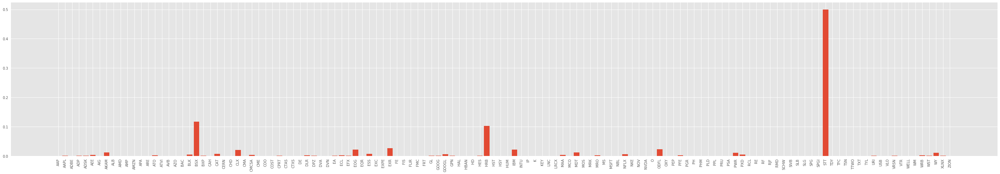

In [167]:
with plt.style.context(('seaborn','ggplot')):
    plt.figure(figsize=(50,8))
    plt.bar(x=df_subset_csi_x.drop(columns=["csi1", "csi2"]).columns, height=rf.feature_importances_, width=0.8)
    plt.xticks(rotation='vertical')
    plt.savefig("weights_rf_2.png", dpi=200)

In [168]:
feature_cols =  df_subset_csi_x.drop(columns=["csi1", "csi2"]).columns
j=0

plot_lime_viz(j, feature_cols, rf.predict)

Intercept 1.8873327609734711
Prediction_local [-0.83689911]
Right: 1.5925165672509864


In [169]:
%%time

shap.initjs()

explainer = shap.TreeExplainer(rf, feature_perturbation="tree_path_dependent")
shap_values_test = explainer.shap_values(X_test, Y_test)

CPU times: user 15.2 ms, sys: 23.2 ms, total: 38.4 ms
Wall time: 12.9 ms


Setting feature_perturbation = "tree_path_dependent" because no background data was given.


In [170]:
j=0
feature_cols =  df_subset_csi_x.drop(columns=["csi1", "csi2"]).columns

shap.force_plot(base_value=explainer.expected_value, 
                shap_values=shap_values_test[j],
                features = X_test[j],
                feature_names=feature_cols)

In [171]:
shap.force_plot(explainer.expected_value, shap_values_test, X_test, feature_names=feature_cols)

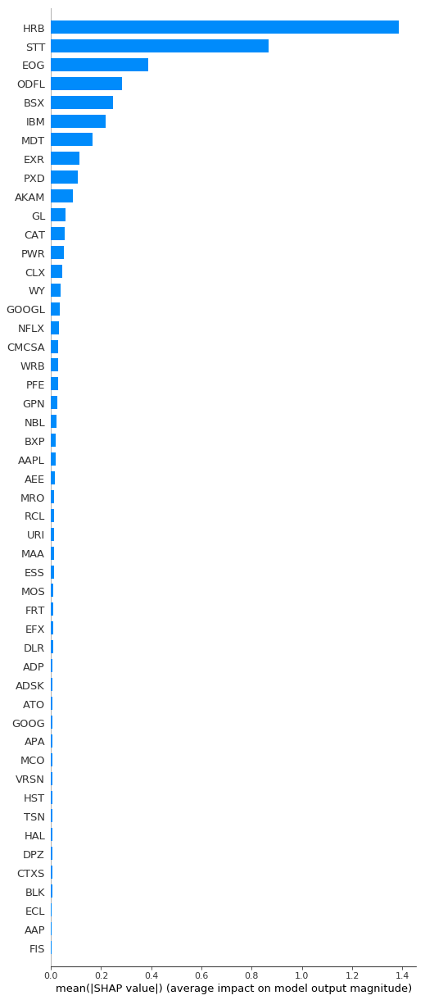

In [172]:
shap.summary_plot(shap_values_test, X_test, plot_type="bar", feature_names=feature_cols, max_display=50)

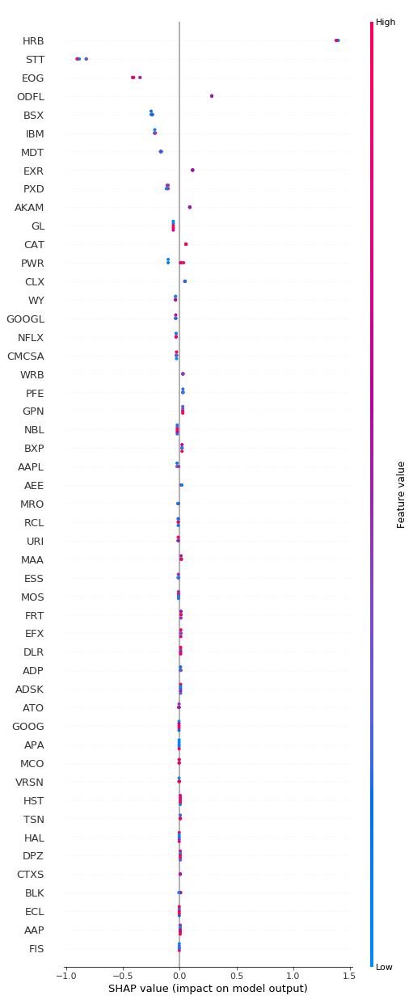

In [173]:
shap.summary_plot(shap_values_test, X_test, feature_names=feature_cols, max_display=50)

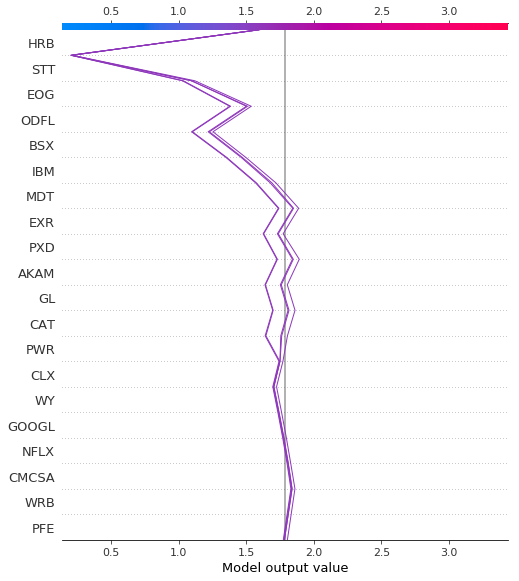

In [174]:
shap.decision_plot(explainer.expected_value, shap_values_test, X_test, feature_names=feature_cols.tolist())

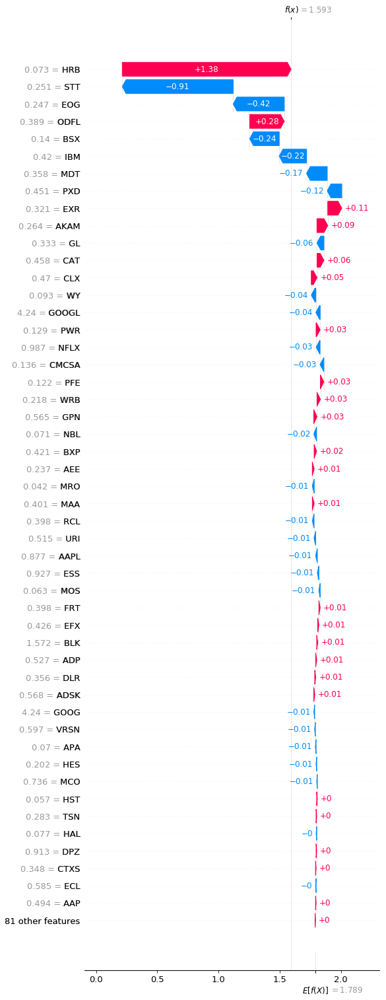

In [175]:
shap.waterfall_plot(explainer.expected_value[j], shap_values_test[0], X_test[0], feature_names=feature_cols.tolist(), max_display=50)

### Method 3 : CSI1_Y Data

In [176]:
future_pre_cnt = 5

X_train, X_test, Y_train, Y_test = create_dataset(df_subset_csi_y, future_pre_cnt)

Dataset Size :  (995, 107) (995,)
Train/Test Sizes :  (990, 107) (5, 107) (990,) (5,)


In [177]:
rf = RandomForestRegressor(n_estimators=100, max_depth=5)

In [178]:
rf.fit(X_train, Y_train)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=5,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=100,
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)

In [179]:
preds = rf.predict(X_test), 
preds = pd.DataFrame(preds[0], index=df_subset.index[-future_pre_cnt:], columns=["Preds"])
preds

,Preds
date,
2019-12-24,1.272190
2019-12-26,1.427421
2019-12-27,1.413959
2019-12-30,1.086739
2019-12-31,1.122099


In [180]:
combine_csi1 = combine_results(preds, actuals)
combine_csi1

,date,Preds,Actual,accuracy
4,2019-12-31,1.12,1.86,60.39%
3,2019-12-30,1.09,1.79,60.57%
2,2019-12-27,1.41,1.73,81.93%
1,2019-12-26,1.43,1.61,88.42%
0,2019-12-24,1.27,1.44,88.47%


In [181]:
calculate_errors(combine_csi1)

Bias: 0.422000
Mean absolute error: 0.42200000000000004
Mean squared error: 0.24025999999999997
Root mean squared error: 0.4901632381156302


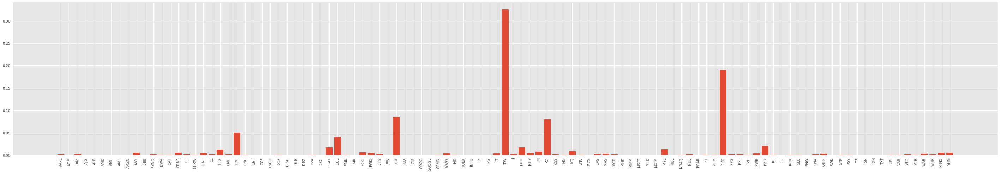

In [182]:
with plt.style.context(('seaborn','ggplot')):
    plt.figure(figsize=(50,8))
    plt.bar(x=df_subset_csi_y.drop(columns=["csi1", "csi2"]).columns, height=rf.feature_importances_, width=0.8)
    plt.xticks(rotation='vertical')
    plt.savefig("weights_rf_3.png", dpi=200)

In [183]:
feature_cols =  df_subset_csi_x.drop(columns=["csi1", "csi2"]).columns
j=0

plot_lime_viz(j, feature_cols, rf.predict)

Intercept 1.7786429177874457
Prediction_local [1.51459477]
Right: 1.272190307309299


In [184]:
%%time

shap.initjs()

explainer = shap.TreeExplainer(rf, feature_perturbation="tree_path_dependent")
shap_values_test = explainer.shap_values(X_test, Y_test)

CPU times: user 26.9 ms, sys: 31.6 ms, total: 58.6 ms
Wall time: 18.3 ms


Setting feature_perturbation = "tree_path_dependent" because no background data was given.


In [185]:
j=0
feature_cols =  df_subset_csi_y.drop(columns=["csi1", "csi2"]).columns

shap.force_plot(base_value=explainer.expected_value, 
                shap_values=shap_values_test[j],
                features = X_test[j],
                feature_names=feature_cols)

In [186]:
shap.force_plot(explainer.expected_value, shap_values_test, X_test, feature_names=feature_cols)

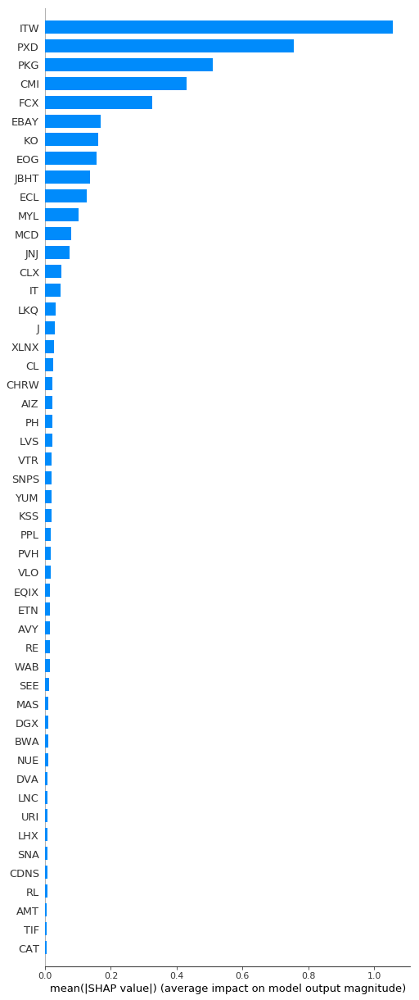

In [187]:
shap.summary_plot(shap_values_test, X_test, plot_type="bar", feature_names=feature_cols, max_display=50)

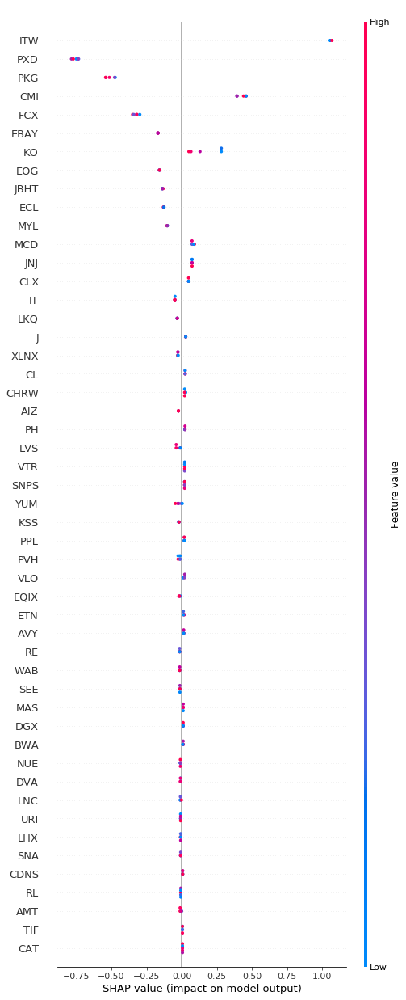

In [188]:
shap.summary_plot(shap_values_test, X_test, feature_names=feature_cols, max_display=50)

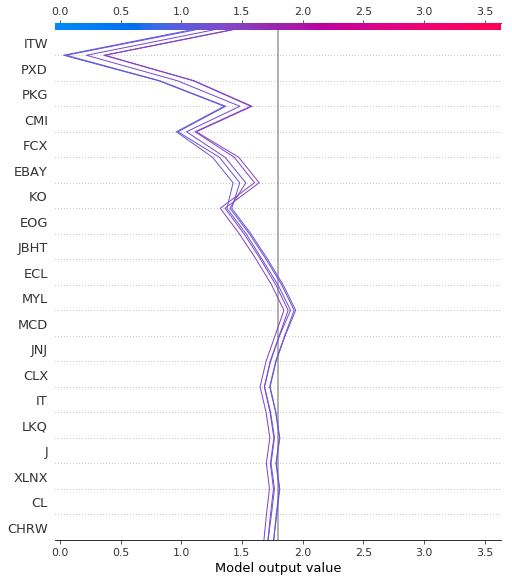

In [189]:
shap.decision_plot(explainer.expected_value, shap_values_test, X_test, feature_names=feature_cols.tolist())

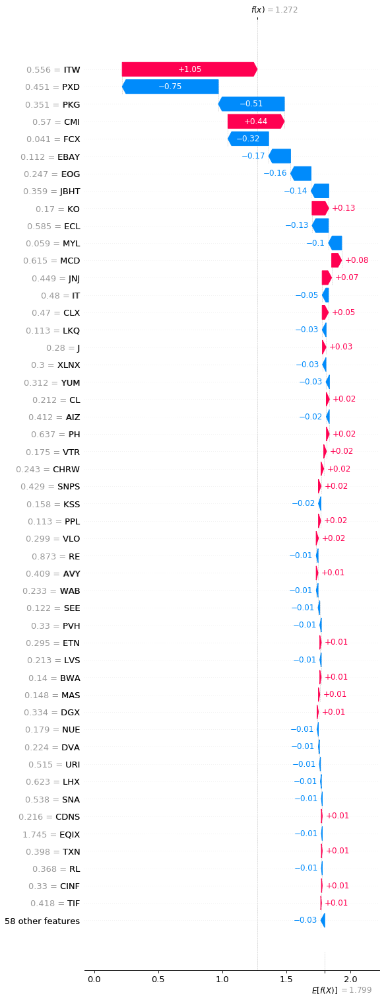

In [190]:
shap.waterfall_plot(explainer.expected_value[j], shap_values_test[0], X_test[0], feature_names=feature_cols.tolist(), max_display=50)

## LSTM v1

### Method 1 : Full Data

In [272]:
def create_dataset_lstm(df, lookback, future_pre_cnt):
    X = df.drop(columns=["csi1", "csi2"]).values
    Y = df["csi1"].values
    
    X_final, Y_final = [], []
    for i in range(X.shape[0]-lookback-future_pre_cnt+1):
        #print(i)
        X_final.append(X[i:i+lookback])
        Y_final.append(Y[i+lookback:i+lookback+future_pre_cnt])
        
    X_final, Y_final = np.array(X_final), np.array(Y_final)

    print("Dataset Size : ", X_final.shape, Y_final.shape)

    X_train, X_test = X_final[:-1], X_final[-1:]
    Y_train, Y_test = Y_final[:-1], Y_final[-1:]

    print("Train/Test Sizes : ", X_train.shape, X_test.shape, Y_train.shape, Y_test.shape)
    
    return X_train, X_test, Y_train, Y_test
    #return X_final, Y_final
    
future_pre_cnt=5
lookback=5
X_train, X_test, Y_train, Y_test = create_dataset_lstm(df_subset, lookback, future_pre_cnt)
X_test, Y_test

Dataset Size :  (991, 5, 401) (991, 5)
Train/Test Sizes :  (990, 5, 401) (1, 5, 401) (990, 5) (1, 5)


(array([[[0.26269673, 0.08849391, 0.49435176, ..., 0.46894263,
          0.79306567, 0.16118533],
         [0.26105323, 0.08761225, 0.4944773 , ..., 0.46584689,
          0.79924277, 0.16067461],
         [0.26335308, 0.08896853, 0.48762854, ..., 0.46369587,
          0.78881274, 0.16045498],
         [0.26561282, 0.09054345, 0.49300031, ..., 0.46868083,
          0.78723536, 0.16097652],
         [0.26542557, 0.09121474, 0.4980076 , ..., 0.47082998,
          0.7992342 , 0.15982816]]]),
 array([[1.43793716, 1.61438911, 1.72580189, 1.79419121, 1.85810752]]))

In [273]:
df_subset.tail(10)

,csi1,csi2,A,AAL,AAP,AAPL,ABC,ABMD,ABT,ACN,ADBE,ADI,ADM,ADP,ADSK,AEE,AEP,AES,AFL,AIG,AIZ,AJG,AKAM,ALB,ALGN,ALK,ALL,ALXN,AMAT,AMD,AME,AMGN,AMP,AMT,AMZN,ANSS,ANTM,AON,APA,APD,APH,ARE,ATO,ATVI,AVB,AVY,AXP,AZO,BA,BAC,BAX,BBY,BDX,BIIB,BIO,BK,BKNG,BKR,BLK,BLL,BMY,BSX,BWA,BXP,C,CAG,CAH,CAT,CB,CCI,CCL,CDNS,CE,CERN,CF,CHD,CHRW,CI,CINF,CL,CLX,CMA,CMCSA,CME,CMI,CNC,CNP,COF,COG,COO,COP,COST,CPB,CPRT,CRM,CSCO,CSX,CTAS,CTL,CTSH,CTXS,CVS,CVX,D,DD,DE,DGX,DHI,DHR,DIS,DISCA,DISH,DLR,DLTR,DOV,DPZ,DRI,DTE,DUK,DVA,DVN,DXC,DXCM,EA,EBAY,ECL,ED,EFX,EIX,EL,EMN,EMR,EOG,EQIX,EQR,ES,ESS,ETFC,ETN,ETR,EW,EXC,EXPD,EXPE,EXR,F,FAST,FCX,FDX,FE,FFIV,FIS,FISV,FITB,FLIR,FMC,FRT,FTI,GD,GE,GILD,GIS,GL,GLW,GOOG,GOOGL,GPC,GPN,GPS,GRMN,GS,GWW,HAL,HAS,HBAN,HD,HES,HFC,HIG,HOLX,HON,HPQ,HRB,HRL,HSIC,HST,HSY,HUM,IBM,ICE,IDXX,IEX,IFF,ILMN,INCY,INTC,INTU,IP,IPG,IRM,ISRG,IT,ITW,IVZ,J,JBHT,JCI,JKHY,JNJ,JNPR,JPM,K,KEY,KLAC,KMB,KMX,KO,KR,KSS,KSU,LB,LEG,LEN,LH,LHX,LIN,LKQ,LLY,LMT,LNC,LOW,LRCX,LUV,LVS,LYV,MAA,MAR,MAS,MCD,MCHP,MCK,MCO,MDLZ,MDT,MET,MGM,MHK,MKC,MKTX,MLM,MMC,MMM,MNST,MO,MOS,MRK,MRO,MS,MSFT,MSI,MTB,MTD,MU,MXIM,MYL,NBL,NDAQ,NEE,NEM,NFLX,NI,NKE,NOC,NOV,NRG,NSC,NTAP,NTRS,NUE,NVDA,NWL,O,ODFL,OKE,OMC,ORCL,ORLY,OXY,PAYX,PBCT,PCAR,PEP,PFE,PG,PGR,PH,PHM,PKG,PKI,PLD,PNC,PNW,PPG,PPL,PRGO,PRU,PSA,PVH,PWR,PXD,QCOM,RCL,RE,REGN,RF,RJF,RL,RMD,ROK,ROP,ROST,RSG,SBAC,SBUX,SCHW,SEE,SHW,SIVB,SJM,SLB,SLG,SNA,SNPS,SO,SPG,SPGI,SRE,STE,STT,STX,STZ,SWK,SWKS,SYK,SYY,T,TAP,TDY,TFC,TFX,TGT,TIF,TJX,TMO,TPR,TROW,TRV,TSCO,TSN,TTWO,TXN,TXT,TYL,UAA,UHS,UNH,UNP,UPS,URI,USB,VAR,VFC,VLO,VMC,VRSN,VRTX,VTR,VZ,WAB,WAT,WBA,WDC,WEC,WELL,WFC,WHR,WLTW,WM,WMB,WMT,WRB,WST,WY,WYNN,XEL,XLNX,XOM,XRAY,XRX,YUM,ZBH,ZBRA,ZION
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-12-17,1.128020,0.793171,0.262697,0.088494,0.494352,0.877460,0.260193,0.559909,0.272429,0.636480,1.010264,0.371812,0.144601,0.526708,0.567919,0.236599,0.291704,0.059205,0.166192,0.162062,0.412054,0.299371,0.263761,0.215195,0.839534,0.219232,0.343743,0.343649,0.190224,0.133836,0.310417,0.759896,0.523641,0.663172,5.603342,0.804425,0.909785,0.649623,0.070313,0.737272,0.334512,0.484714,0.339988,0.182307,0.646619,0.408862,0.390994,3.823356,1.023250,0.109647,0.260506,0.270238,0.841850,0.929718,1.142441,0.160090,6.264261,0.076259,1.571768,0.200864,0.200613,0.140032,0.139656,0.420784,0.243264,0.091341,0.161373,0.458022,0.488782,0.416654,0.147698,0.216322,0.385612,0.224082,0.146822,0.215102,0.243358,0.605564,0.330381,0.212285,0.469631,0.227681,0.135776,0.637012,0.570360,0.184435,0.082642,0.326501,0.052226,0.995932,0.198767,0.924836,0.149451,0.282818,0.505773,0.145320,0.225616,0.815971,0.041086,0.193260,0.347999,0.229527,0.371124,0.255218,0.200958,0.543981,0.334043,0.168038,0.471790,0.462277,0.101292,0.107864,0.356135,0.288012,0.357543,0.912945,0.363019,0.402635,0.283350,0.223988,0.075633,0.115530,0.680070,0.330913,0.112338,0.584848,0.277028,0.426073,0.230153,0.633445,0.248459,0.238289,0.246613,1.744594,0.250681,0.259098,0.926839,0.143005,0.294865,0.371812,0.248167,0.140752,0.239697,0.348938,0.321338,0.029383,0.115374,0.040554,0.510780,0.151078,0.441906,0.431392,0.365429,0.097975,0.164596,0.315799,0.397910,0.062615,0.566699,0.034734,0.207153,0.163251,0.333104,0.089214,4.240448,4.239728,0.331351,0.564728,0.054198,0.306287,0.723316,1.037269,0.077260,0.321964,0.047971,0.681290,0.202366,0.159183,0.190537,0.165942,0.552930,0.063742,0.073223,0.139250,0.213255,0.057390,0.452827,1.138780,0.420002,0.289764,0.804738,0.529430,0.378884,1.012141,0.285728,0.179303,0.814845,0.145790,0.070564,0.098226,1.857871,0.480302,0.556373,0.057014,0.279876,0.358607,0.127296,0.459931,0.449229,0.075758,0.432393,0.206840,0.063711,0.5

In [274]:
lstm_reg_v1 = Sequential([
                        LSTM(40, input_shape=(X_train.shape[1], X_train.shape[2])),
                        Dropout(0.4),
                        Dense(Y_train.shape[1])                        
                        ])

print(lstm_reg_v1.summary())

Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_12 (LSTM)               (None, 40)                70720     
_________________________________________________________________
dropout_12 (Dropout)         (None, 40)                0         
_________________________________________________________________
dense_21 (Dense)             (None, 5)                 205       
Total params: 70,925
Trainable params: 70,925
Non-trainable params: 0
_________________________________________________________________
None


In [275]:
lstm_reg_v1.compile(optimizer="adam", loss="mse", metrics=["mae"])

In [276]:
history = lstm_reg_v1.fit(X_train, Y_train, 
                              batch_size=1, 
                              epochs=5, verbose=1, 
                              validation_data=(X_test, Y_test), 
                              shuffle=False, use_multiprocessing=True);

Train on 990 samples, validate on 1 samples
Epoch 1/5
990/990 [==============================] - 5s 5ms/step - loss: 10.1910 - mae: 2.5426 - val_loss: 1.6549 - val_mae: 1.2537
Epoch 2/5
990/990 [==============================] - 3s 3ms/step - loss: 11.1661 - mae: 2.6546 - val_loss: 0.8380 - val_mae: 0.8632
Epoch 3/5
990/990 [==============================] - 2s 3ms/step - loss: 10.7458 - mae: 2.5943 - val_loss: 0.9974 - val_mae: 0.9496
Epoch 4/5
990/990 [==============================] - 3s 3ms/step - loss: 11.3195 - mae: 2.6600 - val_loss: 0.1263 - val_mae: 0.3409
Epoch 5/5
990/990 [==============================] - 3s 3ms/step - loss: 10.7862 - mae: 2.6063 - val_loss: 0.1754 - val_mae: 0.3902


In [277]:
preds = lstm_reg_v1.predict(X_test).flatten()
preds = pd.DataFrame(preds, index=df_subset.index[-future_pre_cnt:], columns=["Preds"])
preds

,Preds
date,
2019-12-24,1.260478
2019-12-26,1.377881
2019-12-27,1.248080
2019-12-30,1.270324
2019-12-31,1.322587


In [278]:
actuals = pd.DataFrame(Y_test.flatten(), index=df_subset.index[-future_pre_cnt:], columns=["Actual"])
combine_csi1 = combine_results(preds, actuals)
combine_csi1

,date,Preds,Actual,accuracy
4,2019-12-31,1.32,1.86,71.18%
3,2019-12-30,1.27,1.79,70.80%
2,2019-12-27,1.25,1.73,72.32%
1,2019-12-26,1.38,1.61,85.35%
0,2019-12-24,1.26,1.44,87.66%


In [279]:
calculate_errors(combine_csi1)

Bias: 0.390000
Mean absolute error: 0.3899999961853028
Mean squared error: 0.17553999376297064
Root mean squared error: 0.41897493214149534


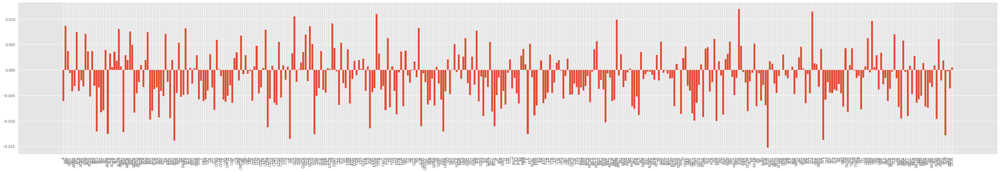

In [199]:
lstm_weights = lstm_reg_v1.get_weights()
important_weights = lstm_weights[0].mean(axis=1)

with plt.style.context(('seaborn','ggplot')):
    plt.figure(figsize=(50,8))
    plt.bar(x=df_subset.drop(columns=["csi1", "csi2"]).columns, height=important_weights, width=0.8)
    plt.xticks(rotation='vertical')
    plt.savefig("weights_lstm_v1_1.png", dpi=200)

### Method 2 : CS1_X Data

In [280]:
future_pre_cnt=5
lookback=5
X_train, X_test, Y_train, Y_test = create_dataset_lstm(df_subset_csi_x, lookback, future_pre_cnt)

Dataset Size :  (991, 5, 130) (991, 5)
Train/Test Sizes :  (990, 5, 130) (1, 5, 130) (990, 5) (1, 5)


In [281]:
lstm_reg_v1 = Sequential([
                        LSTM(40, input_shape=(X_train.shape[1], X_train.shape[2])),
                        Dropout(0.4),
                        Dense(Y_train.shape[1])                        
                        ])

print(lstm_reg_v1.summary())

Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_13 (LSTM)               (None, 40)                27360     
_________________________________________________________________
dropout_13 (Dropout)         (None, 40)                0         
_________________________________________________________________
dense_22 (Dense)             (None, 5)                 205       
Total params: 27,565
Trainable params: 27,565
Non-trainable params: 0
_________________________________________________________________
None


In [282]:
lstm_reg_v1.compile(optimizer="adam", loss="mae", metrics=["mae"])

In [283]:
history = lstm_reg_v1.fit(X_train, Y_train, 
                              batch_size=1, 
                              epochs=5, verbose=1, 
                              validation_data=(X_test, Y_test), 
                              shuffle=False, use_multiprocessing=True);

Train on 990 samples, validate on 1 samples
Epoch 1/5
990/990 [==============================] - 2s 2ms/step - loss: 2.4745 - mae: 2.4745 - val_loss: 1.5834 - val_mae: 1.5834
Epoch 2/5
990/990 [==============================] - 2s 2ms/step - loss: 2.5315 - mae: 2.5315 - val_loss: 1.0753 - val_mae: 1.0753
Epoch 3/5
990/990 [==============================] - 2s 2ms/step - loss: 2.4765 - mae: 2.4765 - val_loss: 0.8844 - val_mae: 0.8844
Epoch 4/5
990/990 [==============================] - 2s 2ms/step - loss: 2.4958 - mae: 2.4958 - val_loss: 0.9231 - val_mae: 0.9231
Epoch 5/5
990/990 [==============================] - 2s 2ms/step - loss: 2.4934 - mae: 2.4934 - val_loss: 0.9256 - val_mae: 0.9256


In [284]:
preds = lstm_reg_v1.predict(X_test).flatten()
preds = pd.DataFrame(preds, index=df_subset.index[-future_pre_cnt:], columns=["Preds"])
preds

,Preds
date,
2019-12-24,0.633997
2019-12-26,0.650119
2019-12-27,0.870871
2019-12-30,0.886305
2019-12-31,0.761085


In [285]:
actuals = pd.DataFrame(Y_test.flatten(), index=df_subset.index[-future_pre_cnt:], columns=["Actual"])
combine_csi1 = combine_results(preds, actuals)
combine_csi1

,date,Preds,Actual,accuracy
4,2019-12-31,0.76,1.86,40.96%
3,2019-12-30,0.89,1.79,49.40%
2,2019-12-27,0.87,1.73,50.46%
1,2019-12-26,0.65,1.61,40.27%
0,2019-12-24,0.63,1.44,44.09%


In [286]:
calculate_errors(combine_csi1)

Bias: 0.926000
Mean absolute error: 0.9260000095367431
Mean squared error: 0.8674600184059145
Root mean squared error: 0.9313753370182799


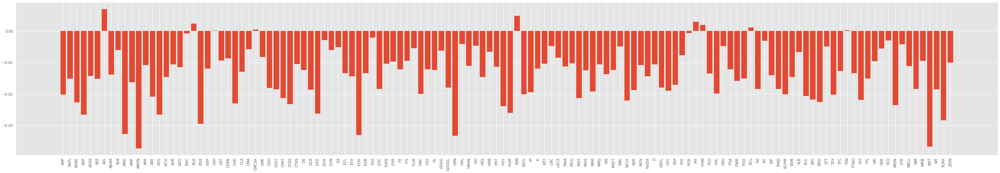

In [256]:
lstm_weights = lstm_reg_v1.get_weights()
important_weights = lstm_weights[0].mean(axis=1)

with plt.style.context(('seaborn','ggplot')):
    plt.figure(figsize=(50,8))
    plt.bar(x=df_subset_csi_x.drop(columns=["csi1", "csi2"]).columns, height=important_weights, width=0.8)
    plt.xticks(rotation='vertical')
    plt.savefig("weights_lstm_v1_2.png", dpi=200)

### Method 3 : CSI1_Y Data

In [287]:
future_pre_cnt=5
lookback=5
X_train, X_test, Y_train, Y_test = create_dataset_lstm(df_subset_csi_y, lookback, future_pre_cnt)

Dataset Size :  (991, 5, 107) (991, 5)
Train/Test Sizes :  (990, 5, 107) (1, 5, 107) (990, 5) (1, 5)


In [288]:
lstm_reg_v1 = Sequential([
                        LSTM(40, input_shape=(X_train.shape[1], X_train.shape[2])),
                        Dropout(0.4),
                        Dense(Y_train.shape[1])                        
                        ])

print(lstm_reg_v1.summary())

Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_14 (LSTM)               (None, 40)                23680     
_________________________________________________________________
dropout_14 (Dropout)         (None, 40)                0         
_________________________________________________________________
dense_23 (Dense)             (None, 5)                 205       
Total params: 23,885
Trainable params: 23,885
Non-trainable params: 0
_________________________________________________________________
None


In [289]:
lstm_reg_v1.compile(optimizer="adam", loss="mse", metrics=["mae"])

In [290]:
history = lstm_reg_v1.fit(X_train, Y_train, 
                              batch_size=1, 
                              epochs=5, verbose=1, 
                              validation_data=(X_test, Y_test), 
                              shuffle=False, use_multiprocessing=True);

Train on 990 samples, validate on 1 samples
Epoch 1/5
990/990 [==============================] - 2s 2ms/step - loss: 9.0903 - mae: 2.4169 - val_loss: 2.0732 - val_mae: 1.4148
Epoch 2/5
990/990 [==============================] - 2s 2ms/step - loss: 9.6085 - mae: 2.4508 - val_loss: 2.1196 - val_mae: 1.4320
Epoch 3/5
990/990 [==============================] - 2s 2ms/step - loss: 9.6312 - mae: 2.4684 - val_loss: 1.1711 - val_mae: 1.0684
Epoch 4/5
990/990 [==============================] - 2s 2ms/step - loss: 10.0652 - mae: 2.4918 - val_loss: 0.8155 - val_mae: 0.8900
Epoch 5/5
990/990 [==============================] - 2s 2ms/step - loss: 10.0408 - mae: 2.4989 - val_loss: 0.9435 - val_mae: 0.9652


In [291]:
preds = lstm_reg_v1.predict(X_test).flatten()
preds = pd.DataFrame(preds, index=df_subset.index[-future_pre_cnt:], columns=["Preds"])
preds

,Preds
date,
2019-12-24,0.549971
2019-12-26,0.756540
2019-12-27,0.711321
2019-12-30,0.883657
2019-12-31,0.702819


In [292]:
actuals = pd.DataFrame(Y_test.flatten(), index=df_subset.index[-future_pre_cnt:], columns=["Actual"])
combine_csi1 = combine_results(preds, actuals)
combine_csi1

,date,Preds,Actual,accuracy
4,2019-12-31,0.70,1.86,37.82%
3,2019-12-30,0.88,1.79,49.25%
2,2019-12-27,0.71,1.73,41.22%
1,2019-12-26,0.76,1.61,46.86%
0,2019-12-24,0.55,1.44,38.25%


In [293]:
calculate_errors(combine_csi1)

Bias: 0.966000
Mean absolute error: 0.9660000071525573
Mean squared error: 0.9457400150203708
Root mean squared error: 0.9724916529309497


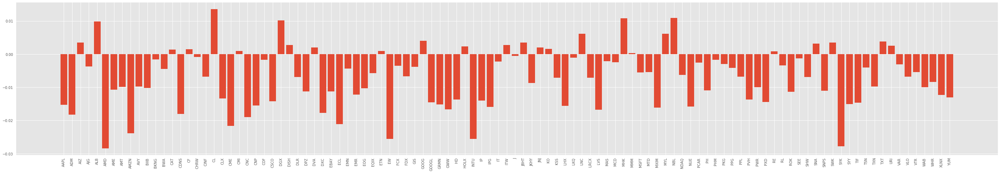

In [215]:
lstm_weights = lstm_reg_v1.get_weights()
important_weights = lstm_weights[0].mean(axis=1)

with plt.style.context(('seaborn','ggplot')):
    plt.figure(figsize=(50,8))
    plt.bar(x=df_subset_csi_y.drop(columns=["csi1", "csi2"]).columns, height=important_weights, width=0.8)
    plt.xticks(rotation='vertical')
    plt.savefig("weights_lstm_v1_3.png", dpi=200)